# Coconophilips- Predictive Equipment Failures - Predict downhole equipment failures using sensor data (ML)

## Importing Libraries

In [ ]:
import pandas as pd                 #importing pandas
import numpy as np                  #importing numpy
import warnings                     #ignoring warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt     #importing matplotlib
import seaborn as sns               #importing seaborn

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Loading the dataset

In [ ]:
data_frame=pd.read_csv("/content/drive/MyDrive/Case Study-1/equip_failures_training_set.csv")     #loading the train dataset

In [ ]:
data_frame_test=pd.read_csv("/content/drive/MyDrive/Case Study-1/equip_failures_test_set.csv")             #loading the test dataset

In [ ]:
pd.set_option('display.max_columns', None)

## Dataset Overview

## Train Dataset

In [ ]:
data_frame.head(10)           #Print the first 10 rows of all columns in the dataset

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,na,2130706438,280,0,0,0,0,0,0,37250,1432864,3664156,1007684,25896,0,2551696,0,0,0,0,0,4933296,3655166,1766008,1132040,0,0,0,0,1012,268,0,0,0,0,0,469014,4239660,703300,755876,0,5374,2108,4114,12348,615248,5526276,2378,4,0,0,2328746,1022304,415432,287230,310246,681504,1118814,3574,0,0,6700214,0,10,108,50,2551696,97518,947550,799478,330760,353400,299160,305200,283680,na,na,na,178540,76698.08,6700214,6700214,6599892,43566,68656,54064,638360,6167850,1209600,246244,2,96,0,5245752,0,916567.68,6,1924,0,0,0,118196,1309472,3247182,1381362,98822,11208,1608,220,240,6700214,na,10476,1226,267998,521832,42

In [ ]:
data_df_copy = data_frame.copy()

In [ ]:
print("Total no of rows:", data_frame.shape[0])   #Gives the number of rows

Total no of rows: 60000


In [ ]:
print("Total no of colomns:", data_frame.shape[1])    #Gives the number of columns

Total no of colomns: 172


In [ ]:
data_frame.shape

(60000, 172)

In [ ]:
data_frame.columns

Index(['id', 'target', 'sensor1_measure', 'sensor2_measure', 'sensor3_measure',
       'sensor4_measure', 'sensor5_measure', 'sensor6_measure',
       'sensor7_histogram_bin0', 'sensor7_histogram_bin1',
       ...
       'sensor105_histogram_bin2', 'sensor105_histogram_bin3',
       'sensor105_histogram_bin4', 'sensor105_histogram_bin5',
       'sensor105_histogram_bin6', 'sensor105_histogram_bin7',
       'sensor105_histogram_bin8', 'sensor105_histogram_bin9',
       'sensor106_measure', 'sensor107_measure'],
      dtype='object', length=172)

In [ ]:
print(data_frame.dtypes.head(10))        #Prints the datatypes of first 10 columns

id                         int64
target                     int64
sensor1_measure            int64
sensor2_measure           object
sensor3_measure           object
sensor4_measure           object
sensor5_measure           object
sensor6_measure           object
sensor7_histogram_bin0    object
sensor7_histogram_bin1    object
dtype: object


In [ ]:
print(data_frame.describe())     # Prints the detailed information

                 id        target  sensor1_measure
count  60000.000000  60000.000000     6.000000e+04
mean   30000.500000      0.016667     5.933650e+04
std    17320.652413      0.128020     1.454301e+05
min        1.000000      0.000000     0.000000e+00
25%    15000.750000      0.000000     8.340000e+02
50%    30000.500000      0.000000     3.077600e+04
75%    45000.250000      0.000000     4.866800e+04
max    60000.000000      1.000000     2.746564e+06


In [ ]:
data_frame.info()       # Train dataset info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 172 entries, id to sensor107_measure
dtypes: int64(3), object(169)
memory usage: 78.7+ MB


In [ ]:
for i in data_frame.columns:
    if i!="id" and i!="target":
        count=data_frame[i].value_counts()
        print("The value counts of the column {} is {}".format(i, count))

The value counts of the column sensor1_measure is 8         1023
10         953
14         920
12         882
6          594
          ... 
7594         1
4040         1
6636         1
13252        1
153002       1
Name: sensor1_measure, Length: 22095, dtype: int64
The value counts of the column sensor2_measure is na     46329
0      10977
2       1937
4        420
6        148
8         65
10        35
12        28
14        12
16         7
24         6
18         5
26         4
34         3
100        3
20         3
22         3
58         2
28         2
52         1
90         1
204        1
30         1
36         1
134        1
48         1
32         1
44         1
46         1
68         1
Name: sensor2_measure, dtype: int64
The value counts of the column sensor3_measure is 0             8752
2130706432    6188
na            3335
2130706434    1227
4              768
              ... 
4486             1
2132             1
3396             1
4202             1
2602             1

In [ ]:
for i in data_frame.columns:
    if i!="id" and i!="target":
        count=data_frame[i].value_counts()
        print("The number of 0 in the column {} is {}".format(i, count[0]))

The number of 0 in the column sensor1_measure is 393
The number of 0 in the column sensor2_measure is 46329
The number of 0 in the column sensor3_measure is 8752
The number of 0 in the column sensor4_measure is 14861
The number of 0 in the column sensor5_measure is 55543
The number of 0 in the column sensor6_measure is 55476
The number of 0 in the column sensor7_histogram_bin0 is 59133
The number of 0 in the column sensor7_histogram_bin1 is 58587
The number of 0 in the column sensor7_histogram_bin2 is 56181
The number of 0 in the column sensor7_histogram_bin3 is 46894
The number of 0 in the column sensor7_histogram_bin4 is 1305
The number of 0 in the column sensor7_histogram_bin5 is 1941
The number of 0 in the column sensor7_histogram_bin6 is 1238
The number of 0 in the column sensor7_histogram_bin7 is 15875
The number of 0 in the column sensor7_histogram_bin8 is 25091
The number of 0 in the column sensor7_histogram_bin9 is 40698
The number of 0 in the column sensor8_measure is 645
The

## Observation

1. The 172 columns are id, target and 170 sensors values.
2. There 170 sensors values having time based and non time based with 60,000 features of each sensor.
3. By observing the dataset, we got a conclusion that there are many 0's and na values. The sensor values also object data type.
4. All the values from sensor should be a numerial value. But a lot of columns has 'na' as string. First replace these 'na' with nan for all columns in dataset and then change the column data type to numeric.
5. The difference between mean and median is not insignificant for some features hence we can say that there might be few outliers in the data.

## Test Dataset

In [ ]:
data_frame_test.head(10)      #print the first 10 rows of all the columns

,id,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,66888,na,2130706438,332,0,0,0,0,0,0,57568,2741842,1537660,119084,10960,916,1967396,119208,0,0,0,0,2985164,1560298,1654976,1359980,0,0,2404,0,934,150,0,0,0,0,0,0,3279256,1187682,1092,0,2716,782,1090,39202,3053880,1370286,74,0,0,0,1402416,1063560,379692,254052,192754,160436,190492,737014,87614,0,4640530,446,46,954,4,1967396,105446,625718,1026922,450020,432900,438640,na,na,na,na,na,328200,66888.9,4640530,4640530,4620874,31990,5052,95788,1006700,4468030,1209600,126628,2,120,0,3843046.08,0,621043.2,0,0,0,0,5202,762124,2421504,1190812,80046,7562,780,0,280,292,4640530,na,4712,518,39840,422664,111858,2716284,11457

In [ ]:
print("Total no of rows: ", data_frame_test.shape[0])   #Gives the number of rows

Total no of rows:  16001


In [ ]:
print("Total no of colomns: ", data_frame_test.shape[1])    #Gives the number of columns

Total no of colomns:  171


In [ ]:
print(data_frame_test.dtypes.head(10))       #Prints the datatypes of first 10 columns

id                         int64
sensor1_measure            int64
sensor2_measure           object
sensor3_measure           object
sensor4_measure           object
sensor5_measure           object
sensor6_measure           object
sensor7_histogram_bin0    object
sensor7_histogram_bin1    object
sensor7_histogram_bin2    object
dtype: object


In [ ]:
print(data_frame_test.describe())     # Prints the detailed information

                 id  sensor1_measure
count  16001.000000     1.600100e+04
mean    8001.000000     6.799520e+04
std     4619.235164     5.035193e+05
min        1.000000     0.000000e+00
25%     4001.000000     9.280000e+02
50%     8001.000000     3.098200e+04
75%    12001.000000     4.947800e+04
max    16001.000000     4.294967e+07


In [ ]:
print(data_frame_test.shape)      #Shape of the Test dataset

(16001, 171)


In [ ]:
data_frame_test.info()       #Test dataset info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16001 entries, 0 to 16000
Columns: 171 entries, id to sensor107_measure
dtypes: int64(2), object(169)
memory usage: 20.9+ MB


In [ ]:
for i in data_frame_test.columns:
    if i!="id":
        count=data_frame_test[i].value_counts()
        print("The value counts of the column {} is {}".format(i, count))

The value counts of the column sensor1_measure is 12        276
8         270
10        248
14        215
6         151
         ... 
62600       1
58422       1
81664       1
200002      1
60000       1
Name: sensor1_measure, Length: 9237, dtype: int64
The value counts of the column sensor2_measure is na    12364
0      2865
2       547
4       117
6        34
8        26
10       16
12        8
14        7
38        4
24        3
20        2
16        2
26        1
22        1
58        1
18        1
32        1
28        1
Name: sensor2_measure, dtype: int64
The value counts of the column sensor3_measure is 0             2289
2130706432    1673
na             926
2130706434     321
2              217
              ... 
4918             1
3794             1
6500             1
4348             1
878              1
Name: sensor3_measure, Length: 1312, dtype: int64
The value counts of the column sensor4_measure is na       3981
0         519
4         251
2         249
10        242
   

In [ ]:
for i in data_frame_test.columns:
    if i!="id":
        count=data_frame_test[i].value_counts()
        print("The number of 0 in the column {} is {}".format(i, count[0]))

The number of 0 in the column sensor1_measure is 84
The number of 0 in the column sensor2_measure is 12364
The number of 0 in the column sensor3_measure is 2289
The number of 0 in the column sensor4_measure is 3981
The number of 0 in the column sensor5_measure is 14765
The number of 0 in the column sensor6_measure is 14742
The number of 0 in the column sensor7_histogram_bin0 is 15750
The number of 0 in the column sensor7_histogram_bin1 is 15576
The number of 0 in the column sensor7_histogram_bin2 is 14955
The number of 0 in the column sensor7_histogram_bin3 is 12443
The number of 0 in the column sensor7_histogram_bin4 is 340
The number of 0 in the column sensor7_histogram_bin5 is 499
The number of 0 in the column sensor7_histogram_bin6 is 326
The number of 0 in the column sensor7_histogram_bin7 is 4139
The number of 0 in the column sensor7_histogram_bin8 is 6684
The number of 0 in the column sensor7_histogram_bin9 is 10797
The number of 0 in the column sensor8_measure is 175
The number

## Converting the sensors values from object to float.

## Train Dataset

In [ ]:
#replace the na values with np.nan means converting every values fromstring to float 
data_frame=data_frame.replace("na",np.nan)    

In [ ]:
for col in data_frame.columns:
    data_frame[col]=pd.to_numeric(data_frame[col])

In [ ]:
data_frame.dtypes.head(10)

id                          int64
target                      int64
sensor1_measure             int64
sensor2_measure           float64
sensor3_measure           float64
sensor4_measure           float64
sensor5_measure           float64
sensor6_measure           float64
sensor7_histogram_bin0    float64
sensor7_histogram_bin1    float64
dtype: object

In [ ]:
data_frame.head(10)

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,299160.0,305200.0,283680.0,NaN,NaN,NaN,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064.

In [ ]:
data_frame.describe()

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
count,60000.000000,60000.000000,6.000000e+04,13671.000000,5.666500e+04,4.513900e+04,57500.000000,57500.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.935500e+04,5.937100e+04,5.937100e+04,5.560000e+04,5.935800e+04,5.937100e+04,5.935800e+04,5.941100e+04,5.935800e+04,5.941100e+04,57277.000000,5.937100e+04,5.937100e+04,5.937100e+04,57500.000000,57499.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.9329

## Observation:
converted the "na" values to "np.nan".

## Test Dataset

In [ ]:
#replace the na values with np.nan means converting every values fromstring to float 
data_frame_test=data_frame_test.replace("na",np.nan)     

In [ ]:
for col in data_frame_test.columns:
    data_frame_test[col]=pd.to_numeric(data_frame_test[col])

In [ ]:
data_frame_test.dtypes.head(10)

id                          int64
sensor1_measure             int64
sensor2_measure           float64
sensor3_measure           float64
sensor4_measure           float64
sensor5_measure           float64
sensor6_measure           float64
sensor7_histogram_bin0    float64
sensor7_histogram_bin1    float64
sensor7_histogram_bin2    float64
dtype: object

In [ ]:
data_frame_test.head(10)

,id,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,66888,NaN,2.130706e+09,332.0,0.0,0.0,0.0,0.0,0.0,0.0,57568.0,2741842.0,1537660.0,119084.0,10960.0,916.0,1967396.0,119208.0,0.0,0.0,0.0,0.0,2985164.0,1560298.0,1654976.0,1359980.0,0.0,0.0,2404.0,0.0,934.0,150.0,0.0,0.0,0.0,0.0,0.0,0.0,3279256.0,1187682.0,1092.0,0.0,2716.0,782.0,1090.0,39202.0,3053880.0,1370286.0,74.0,0.0,0.0,0.0,1402416.0,1063560.0,379692.0,254052.0,192754.0,160436.0,190492.0,737014.0,87614.0,0.0,4640530.0,446.0,46.0,954.0,4.0,1967396.0,105446.0,625718.0,1026922.0,450020.0,432900.0,438640.0,NaN,NaN,NaN,NaN,NaN,328200.0,66888.90,4640530.0,4640530.0,4620874.0,31990.0,5052.0,95788.0,1006700.0,

In [ ]:
data_frame_test.describe()

,id,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
count,16001.000000,1.600100e+04,3637.000000,1.507500e+04,12020.000000,15311.000000,15311.000000,15812.000000,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.581200e+04,1.582600e+04,1.583800e+04,1.583800e+04,1.480300e+04,1.583200e+04,1.583800e+04,1.583200e+04,1.583900e+04,1.583200e+04,1.583900e+04,15237.000000,1.583800e+04,1.583800e+04,1.583800e+04,15313.000000,15313.000000,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1.580900e+04,1

## Exploratory Data Analysis

In [ ]:
#Gives the equipment success count
counts = data_frame["target"].value_counts()
print("The number of equipment success", counts[0])

The number of equipment success 59000


In [ ]:
# Percentage of equipment success
percentage_success= (counts[0]/(counts[1]+counts[0])*100)
print("The percentage of equipment success: {0}{1}".format(percentage_success,"%"))

The percentage of equipment success: 98.33333333333333%


In [ ]:
#Gives the equipment failure count
print("The number of equipment failure", counts[1])

The number of equipment failure 1000


In [ ]:
# Percentage of equipment failure
percentage_failure= (counts[1]/(counts[1]+counts[0])*100)
print("The percentage of equipment failure: {0}{1}".format(percentage_failure,"%"))

The percentage of equipment failure: 1.6666666666666667%


Success cases 59000
Failure cases 1000


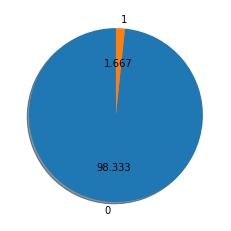

In [ ]:
plt.pie(counts,startangle=90,autopct="%.3f",labels=[0,1],shadow=True)
print("Success cases", counts[0])
print("Failure cases", counts[1])

## Observation:
Here the blue colour represents the success cases and orange colour represents the failure cases.

Success cases 59000
Failure cases 1000


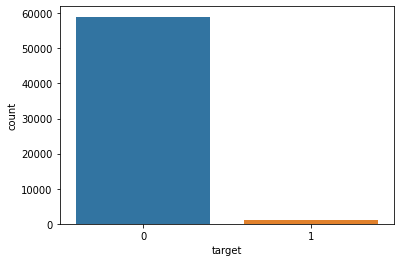

In [ ]:
g = sns.countplot(x = "target" , data = data_frame)
plt.xlabel("target")
plt.ylabel("count")
print("Success cases", counts[0])
print("Failure cases", counts[1])

## Observation:
The data is highly imbalanced. Among 60000 data points only 1000 datapoints has target value as 1. So while training we need to take care of our model, it should not get underfit towards 0's.

In [ ]:
# percentage of NULL points in every sensors
for i in data_frame.columns:
    if i!="id" and i!="target":
        print("The percentage of NULL in the column {} is {}{}".format(i,(data_frame[i].isnull().sum()/data_frame.shape[0])*100,"%"))

The percentage of NULL in the column sensor1_measure is 0.0%
The percentage of NULL in the column sensor2_measure is 77.215%
The percentage of NULL in the column sensor3_measure is 5.558333333333334%
The percentage of NULL in the column sensor4_measure is 24.768333333333334%
The percentage of NULL in the column sensor5_measure is 4.166666666666666%
The percentage of NULL in the column sensor6_measure is 4.166666666666666%
The percentage of NULL in the column sensor7_histogram_bin0 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin1 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin2 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin3 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin4 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin5 is 1.1183333333333334%
The percentage of NULL in the column sensor7_histogram_bin6 is 1.11833333333

## Observation:
1. sensor2_measure, sensor38_measure, sensor39_measure, sensor40_measure, sensor41_measure, sensor42_measure, sensor43_measure are having more than 50% of null values.
2. In the sensor48_measure and sensor54_measure doesn't have any 0 values.

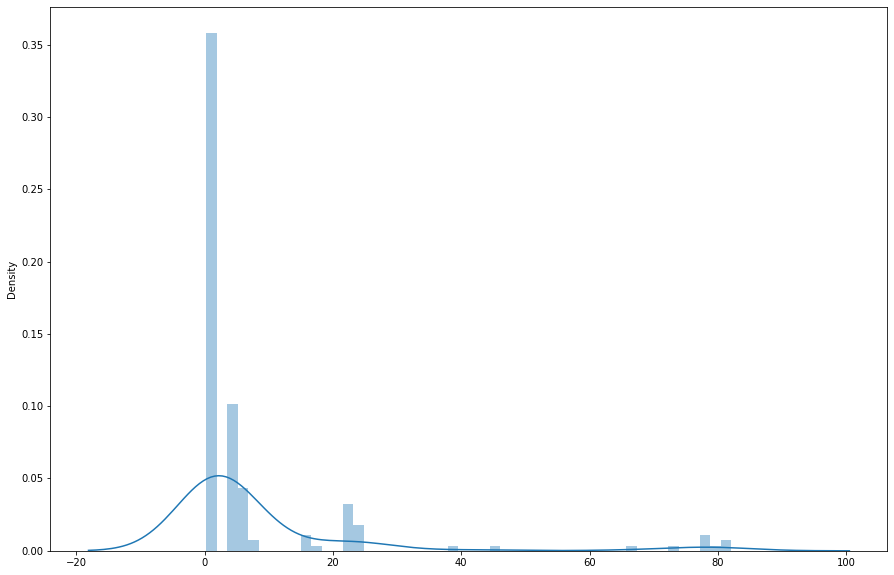

In [ ]:
plt.figure(figsize=(15,10))
x=data_frame[data_frame.columns[data_frame.isnull().any()]].isnull().sum() * 100 / data_frame.shape[0]
sns.distplot(x,kde=True)

## Observation:
1. About 0-20% of data is having NULL values in their features.
2. About 50-80% of data is very small majority of having Null values in their features.
3. These doesn't contibute much information to the training of the model.

## Analyse Time based sensor data
Here we have total 7 time based sensors and total 10 bins per sensor. Hence total 7*10 = 70 features present.

In [ ]:
# Get all time based sensor column names (including all time bins)
hist_col =  [l for l in data_frame.columns if 'histogram' in l]

# Get the sensors with time based data
hist_sensor =  [l.split("_")[0] for l in data_frame.columns if 'histogram' in l]
hist_sensor = list(set(hist_sensor))

# sort the sensor names
dic = {}
for i, v in enumerate(hist_sensor):
    dic[int(hist_sensor[i].split('sensor')[1])] = v

hist_sensor_sort = []
for i in sorted(dic):
    hist_sensor_sort.append(dic[i])
print('Below sensors have time based readings.')
hist_sensor_sort

Below sensors have time based readings.


['sensor7',
 'sensor24',
 'sensor25',
 'sensor26',
 'sensor64',
 'sensor69',
 'sensor105']

## Observation:
Except these 7 sensors remaining sensors are non temporal sensor.

## PDF on non temporal sensors:

In [ ]:
sensor_column_names = []
for column in data_frame.columns:
    if column != 'id' and column != 'target':
        column_name = column.split("_")
        if column_name[1] != 'histogram':
            sensor_column_names.append(column)

In [ ]:
for col in data_frame.columns:
    data_frame[col] = pd.to_numeric(data_frame[col], errors='coerce')

In [ ]:
df_0 = data_frame[data_frame['target']==0]
df_1 = data_frame[data_frame['target']==1]

In [ ]:
data_frame.head(10)

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,299160.0,305200.0,283680.0,NaN,NaN,NaN,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064.

## Pair-plot on non time based sensor:

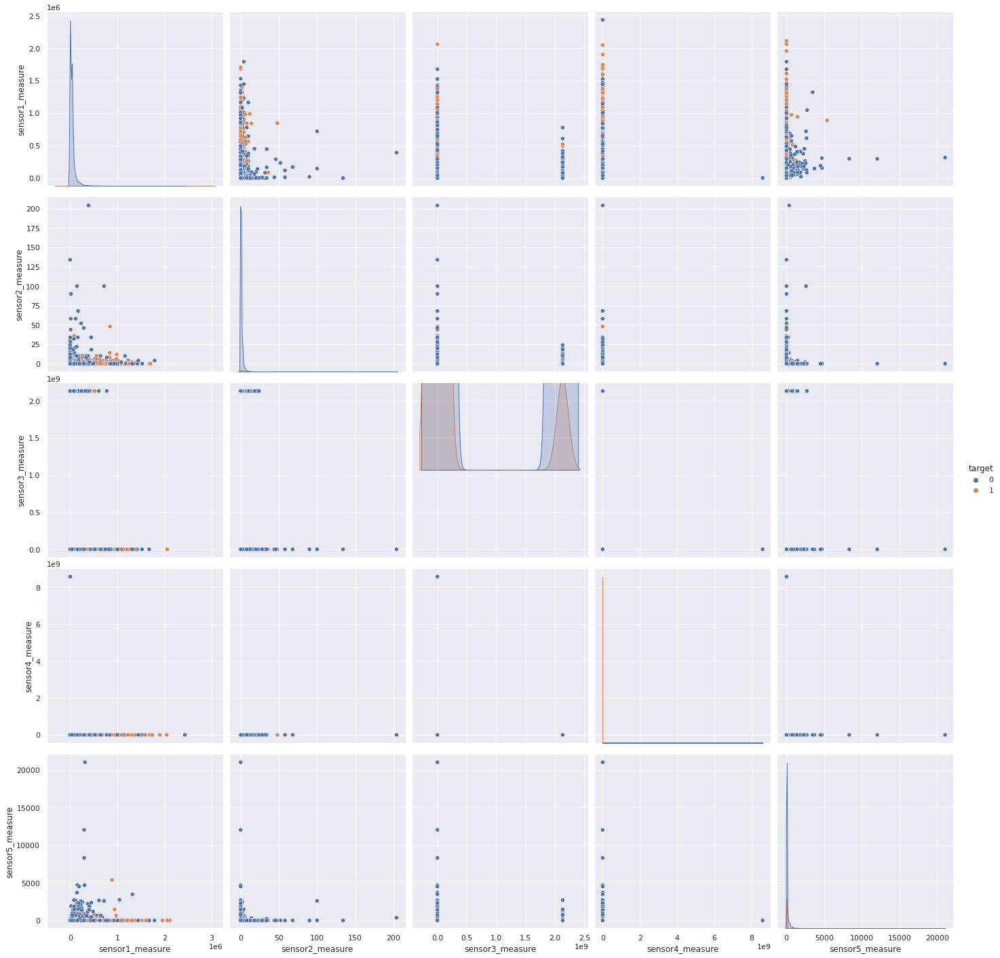

In [ ]:
col=['sensor1_measure', 'sensor2_measure', 'sensor3_measure', 'sensor4_measure', 'sensor5_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

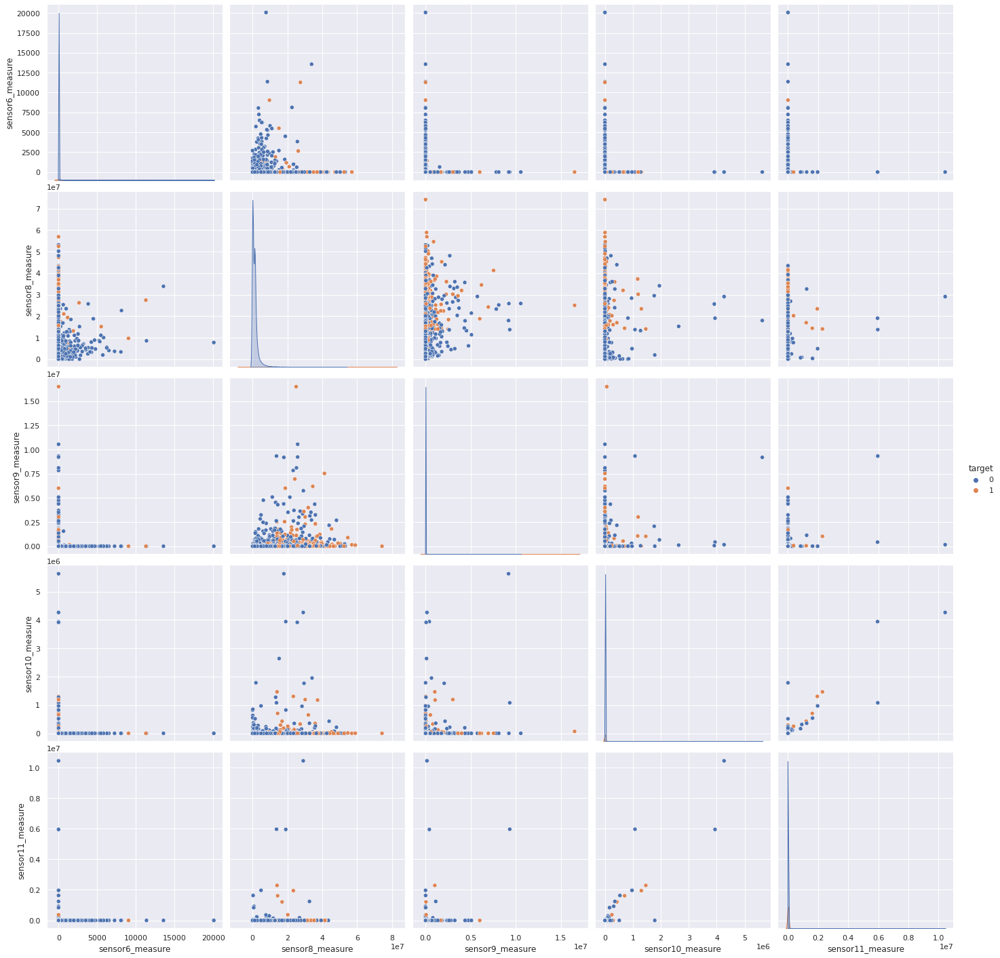

In [ ]:
col=[ 'sensor6_measure', 'sensor8_measure', 'sensor9_measure', 'sensor10_measure', 'sensor11_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

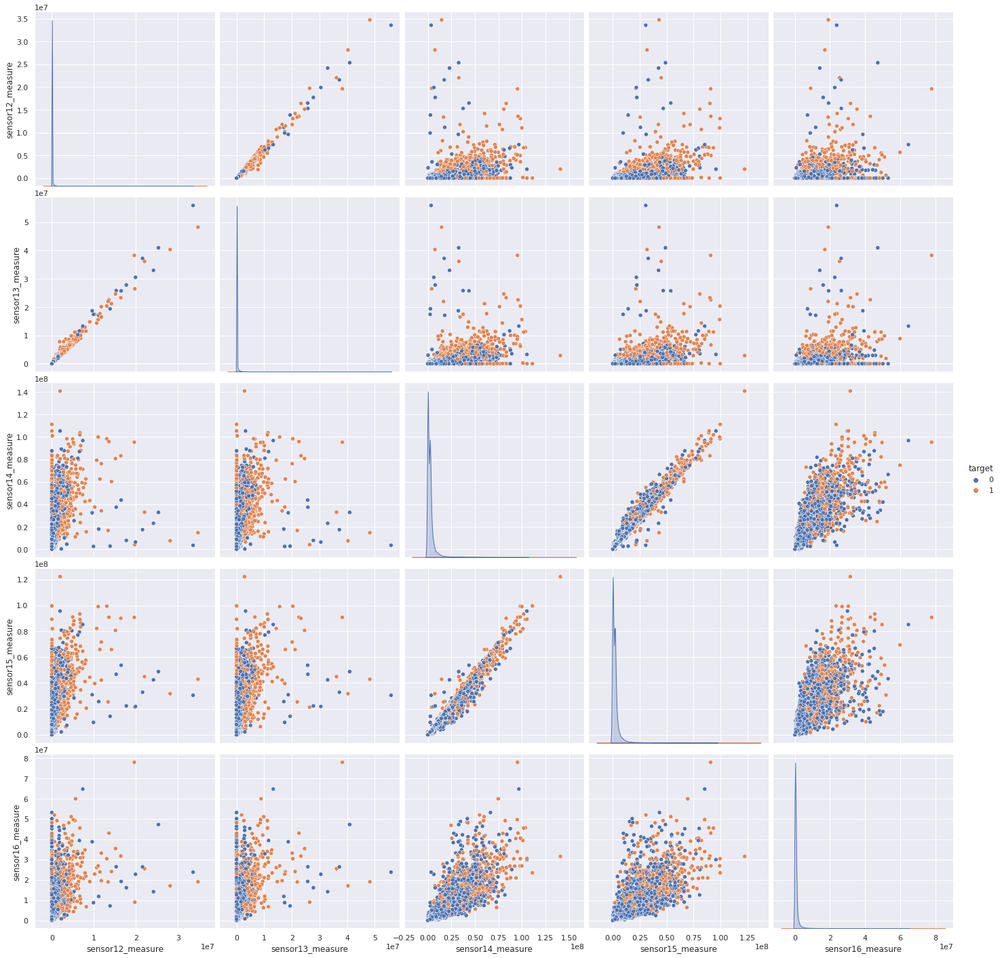

In [ ]:
col=['sensor12_measure', 'sensor13_measure', 'sensor14_measure', 'sensor15_measure', 'sensor16_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

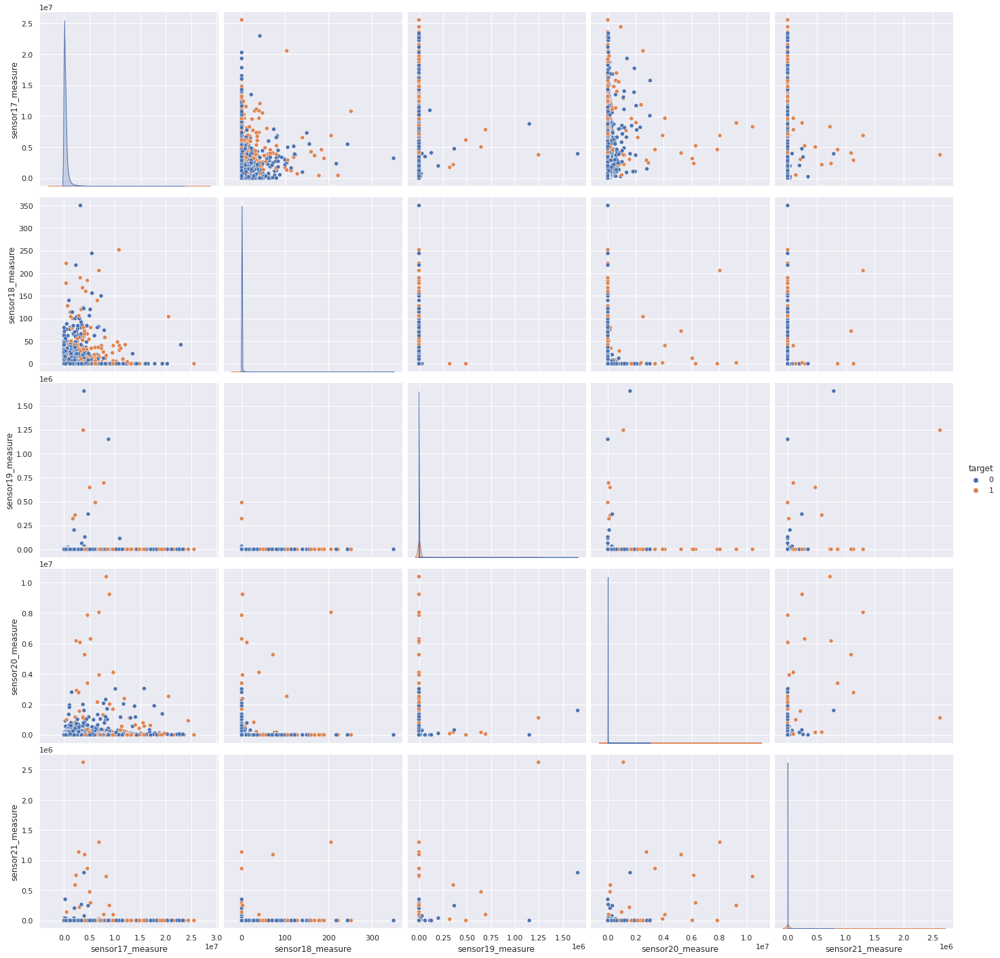

In [ ]:
col=['sensor17_measure','sensor18_measure', 'sensor19_measure', 'sensor20_measure', 'sensor21_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

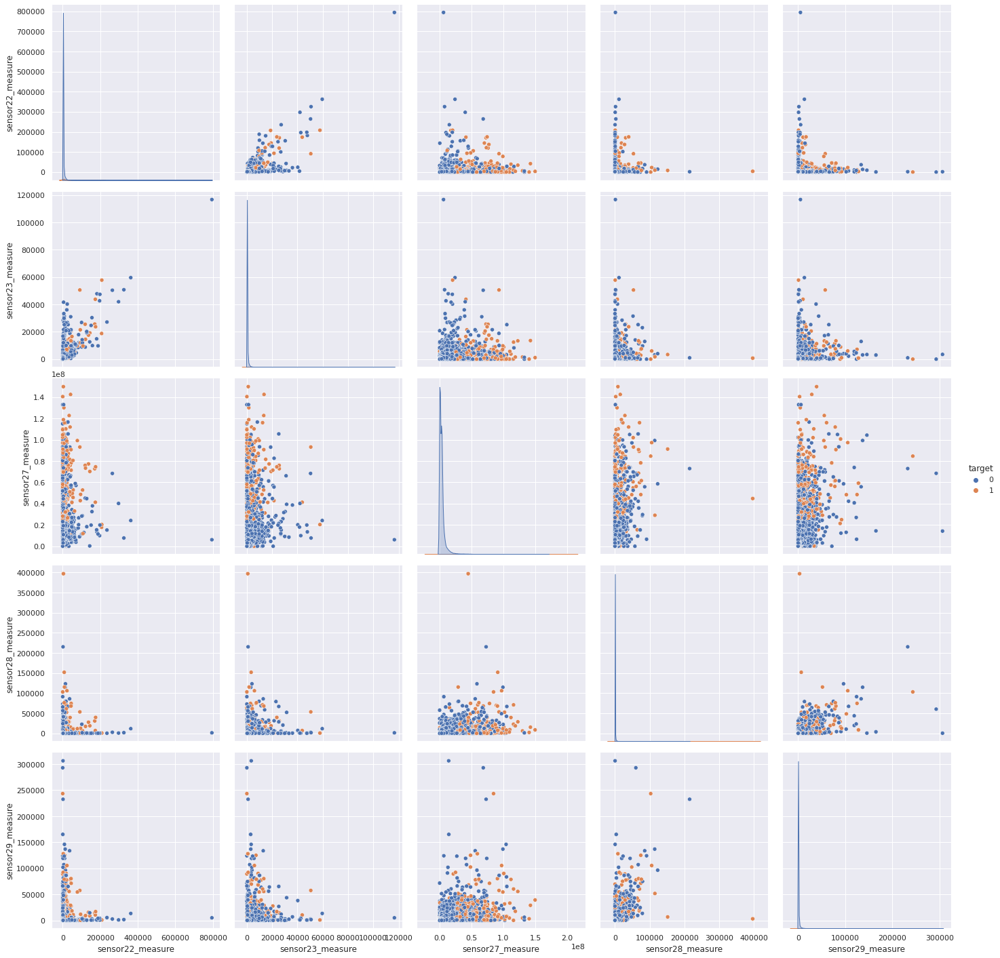

In [ ]:
col=['sensor22_measure', 'sensor23_measure', 'sensor27_measure', 'sensor28_measure', 'sensor29_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

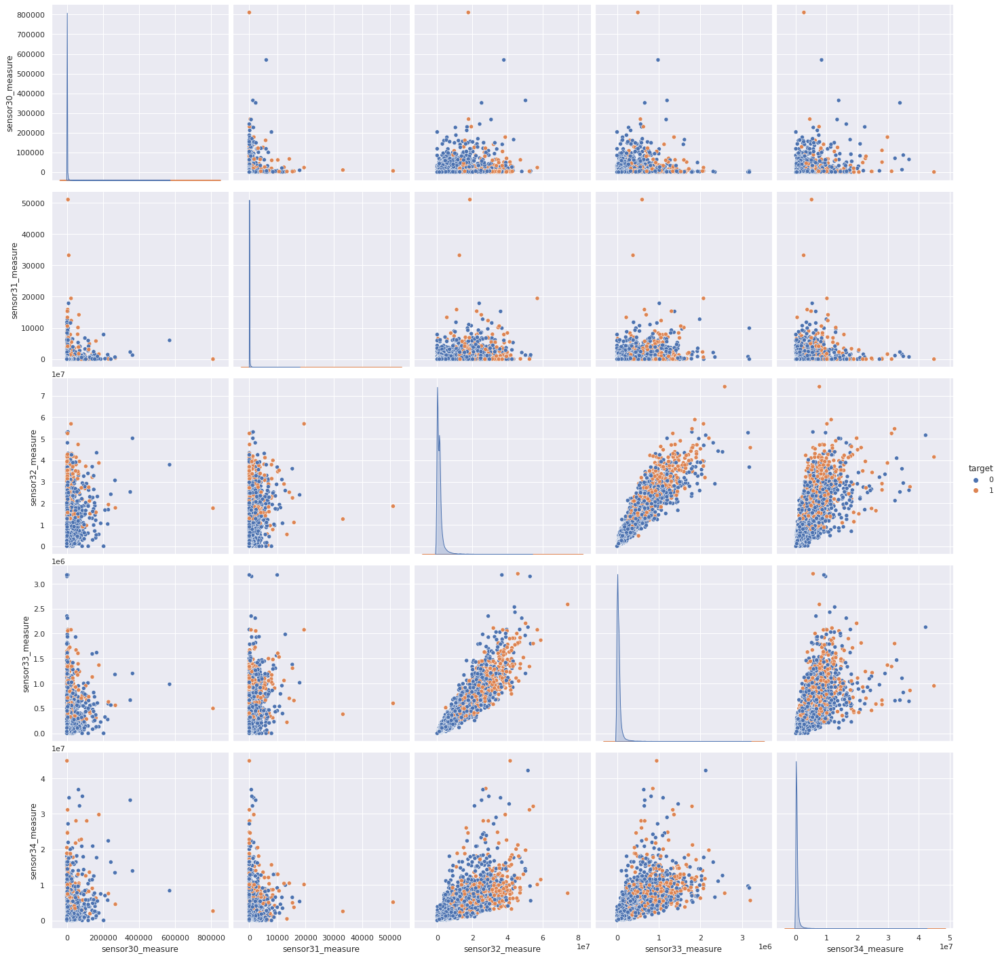

In [ ]:
col=['sensor30_measure', 'sensor31_measure', 'sensor32_measure', 'sensor33_measure', 'sensor34_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

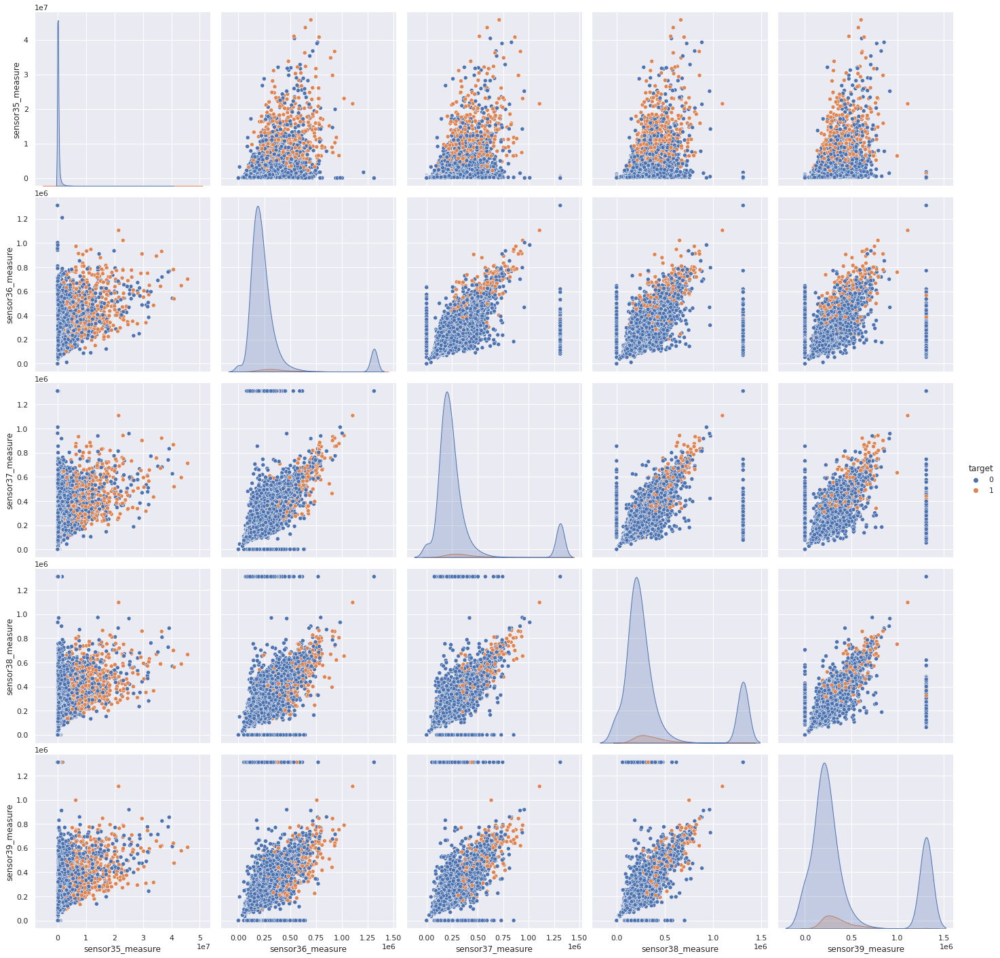

In [ ]:
col=['sensor35_measure', 'sensor36_measure', 'sensor37_measure', 'sensor38_measure', 'sensor39_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

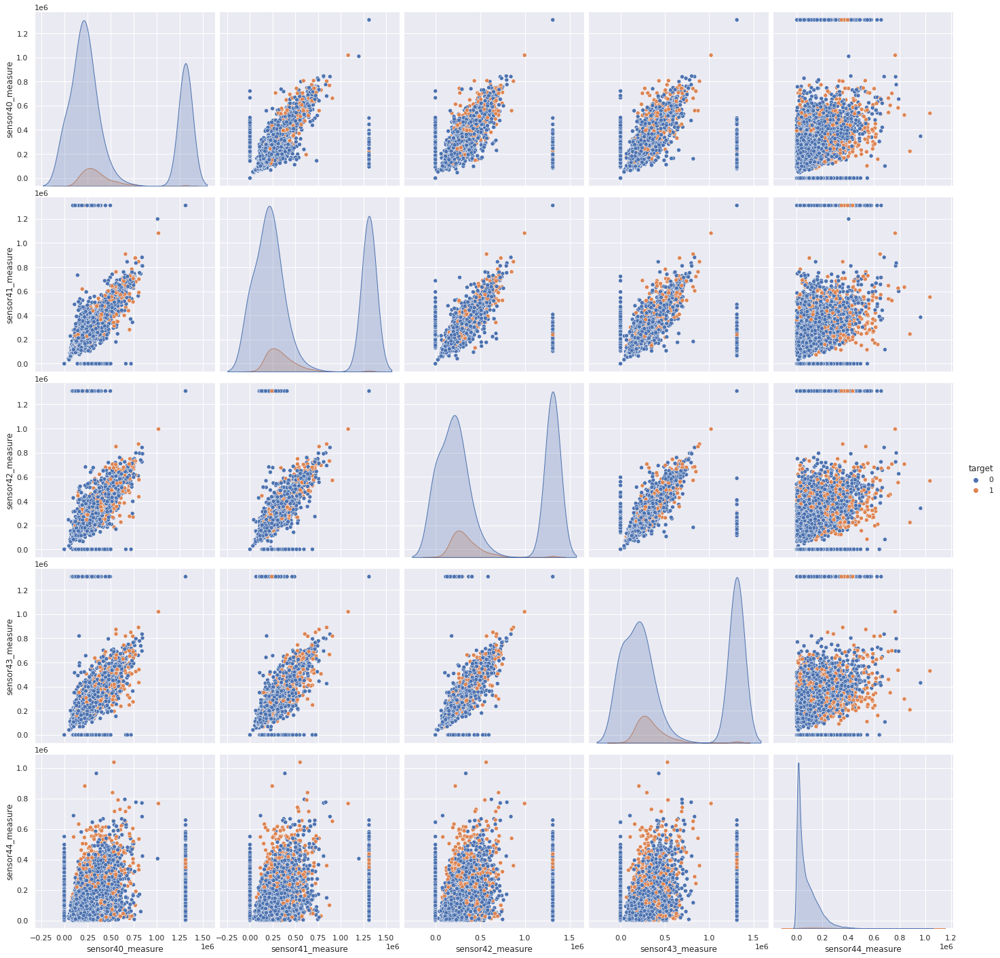

In [ ]:
col=['sensor40_measure', 'sensor41_measure', 'sensor42_measure', 'sensor43_measure', 'sensor44_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

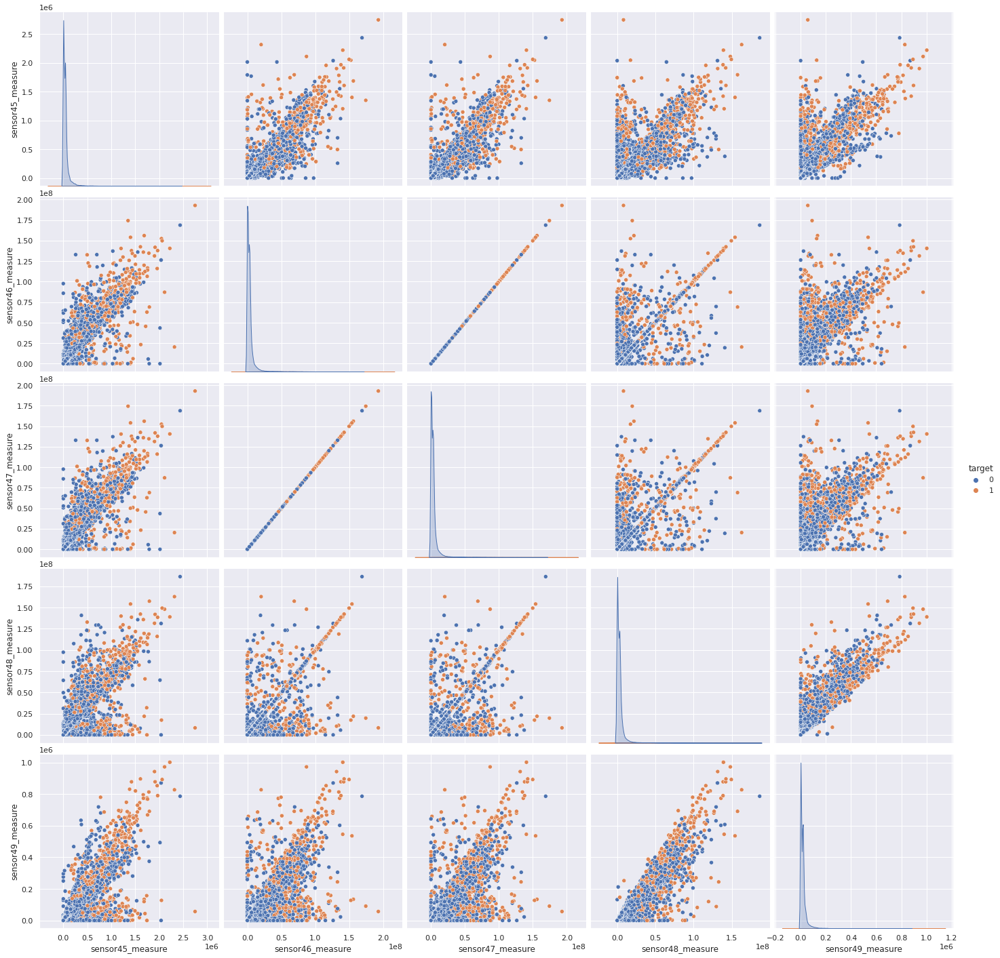

In [ ]:
col=[ 'sensor45_measure', 'sensor46_measure', 'sensor47_measure', 'sensor48_measure', 'sensor49_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

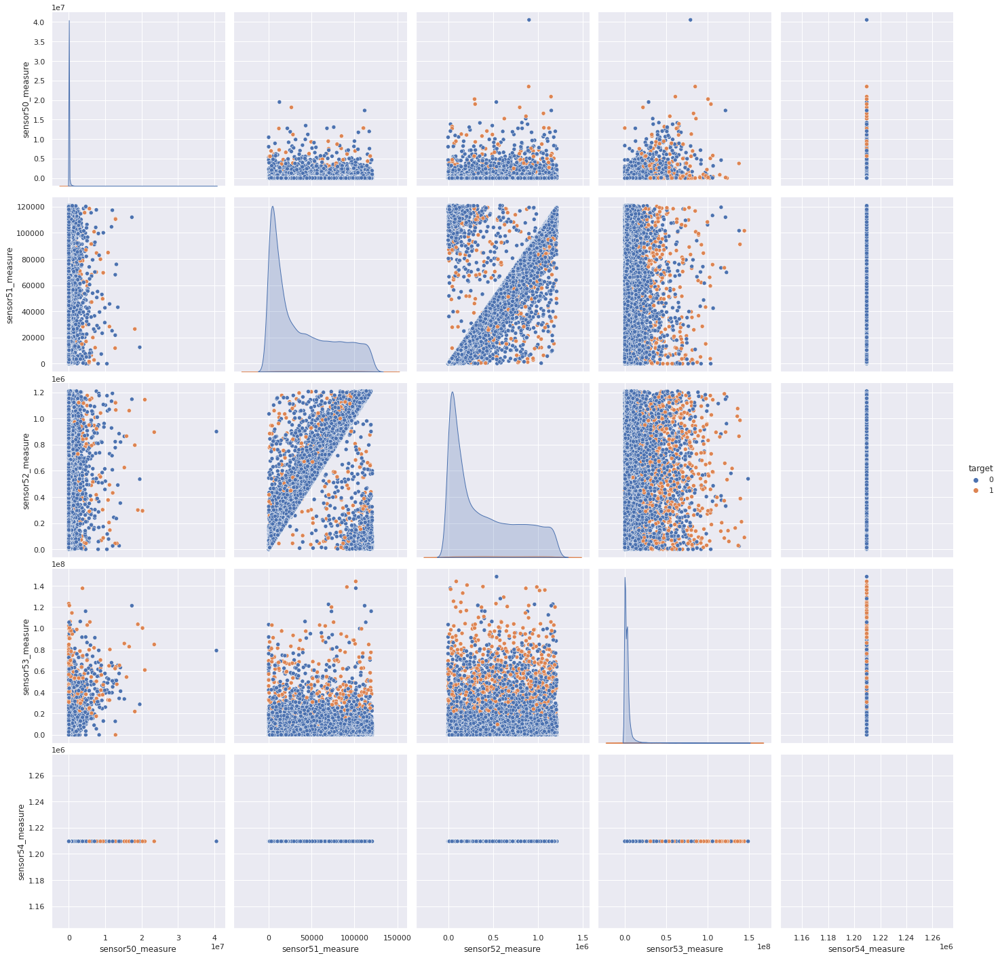

In [ ]:
col=['sensor50_measure','sensor51_measure', 'sensor52_measure', 'sensor53_measure', 'sensor54_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

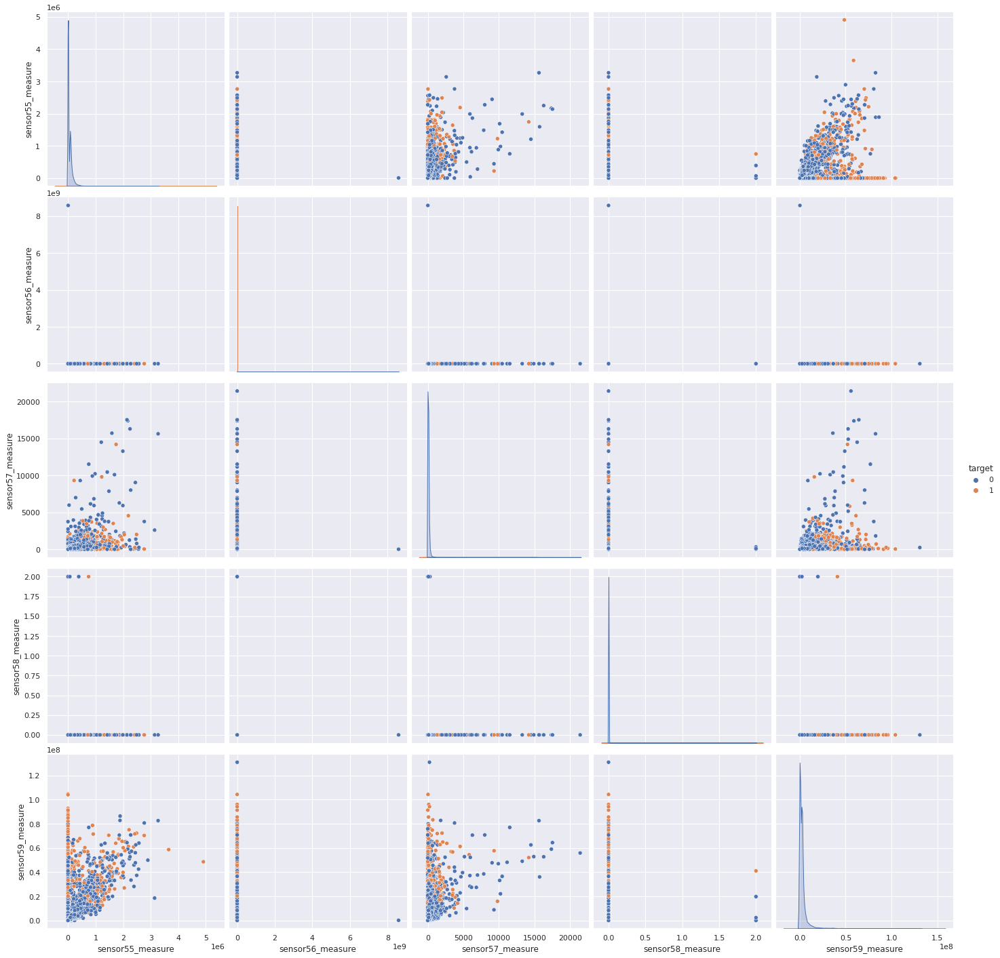

In [ ]:
col=['sensor55_measure', 'sensor56_measure', 'sensor57_measure','sensor58_measure','sensor59_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

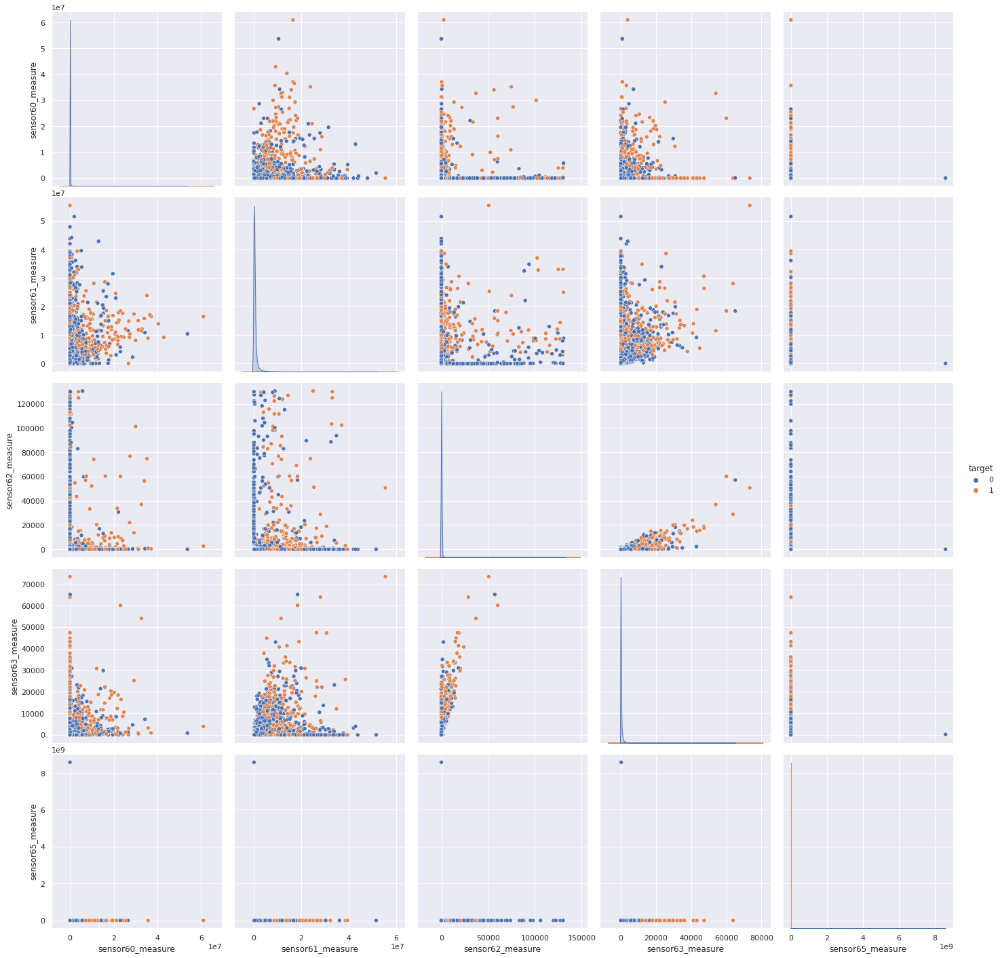

In [ ]:
col=['sensor60_measure', 'sensor61_measure', 'sensor62_measure', 'sensor63_measure', 'sensor65_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

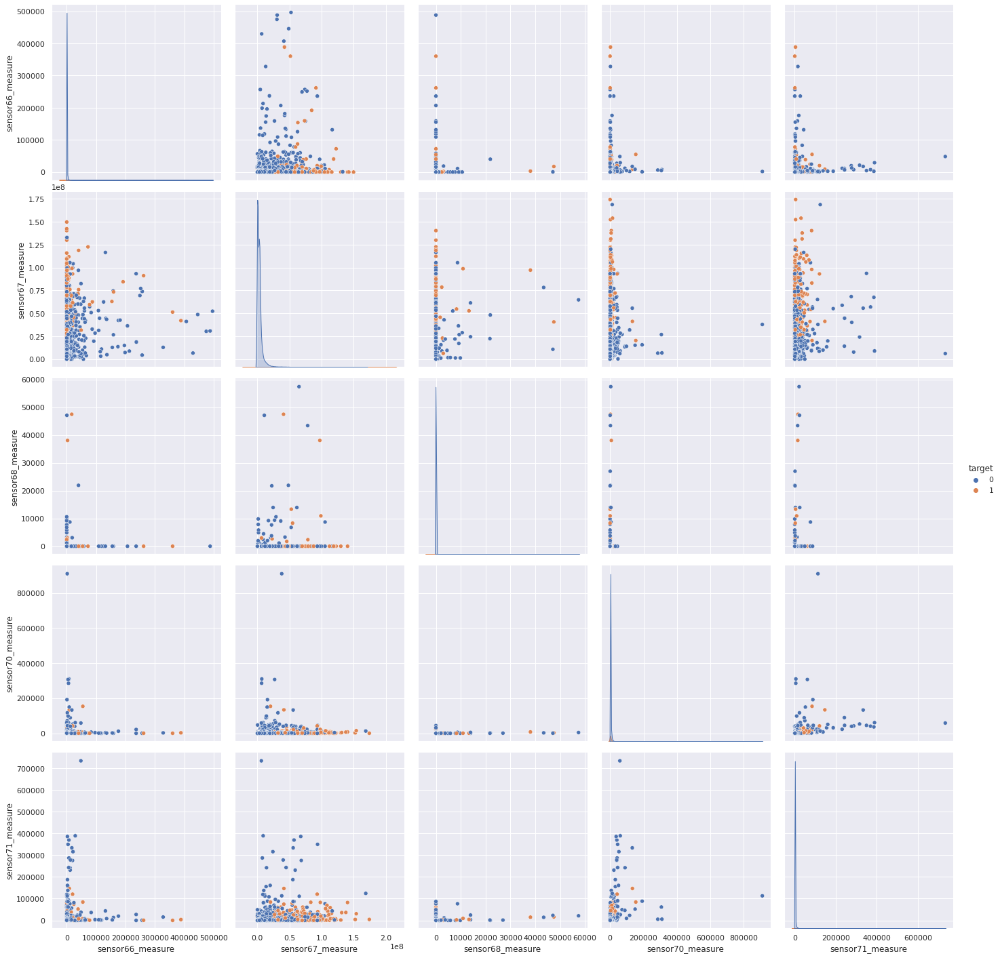

In [ ]:
col=['sensor66_measure', 'sensor67_measure', 'sensor68_measure', 'sensor70_measure', 'sensor71_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

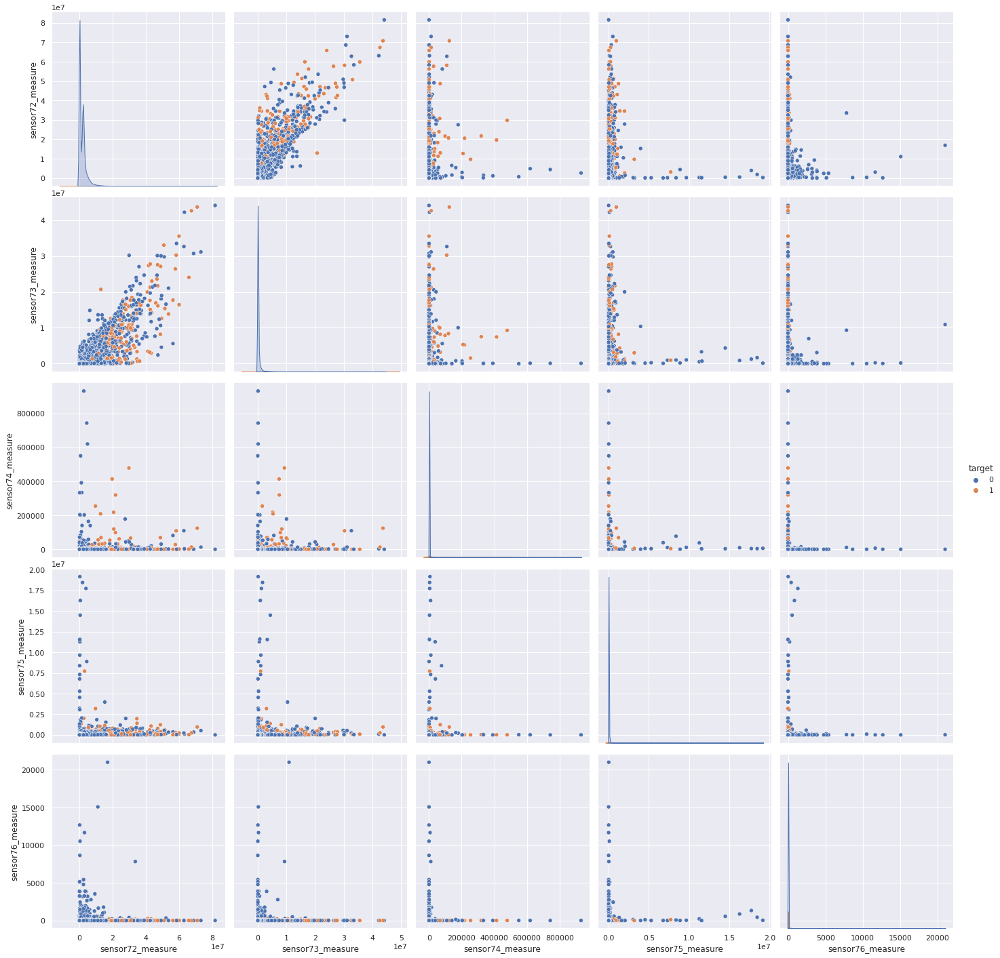

In [ ]:
col=['sensor72_measure', 'sensor73_measure', 'sensor74_measure', 'sensor75_measure', 'sensor76_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

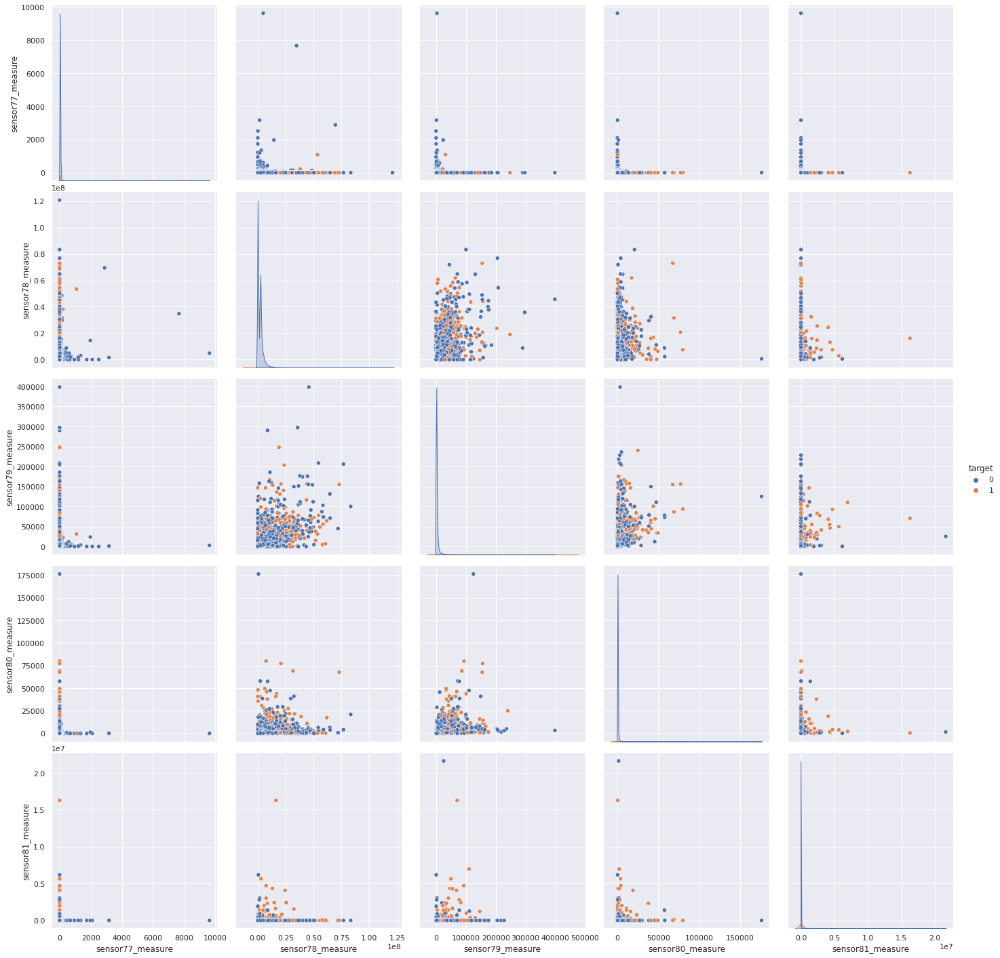

In [ ]:
col=['sensor77_measure', 'sensor78_measure', 'sensor79_measure', 'sensor80_measure', 'sensor81_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

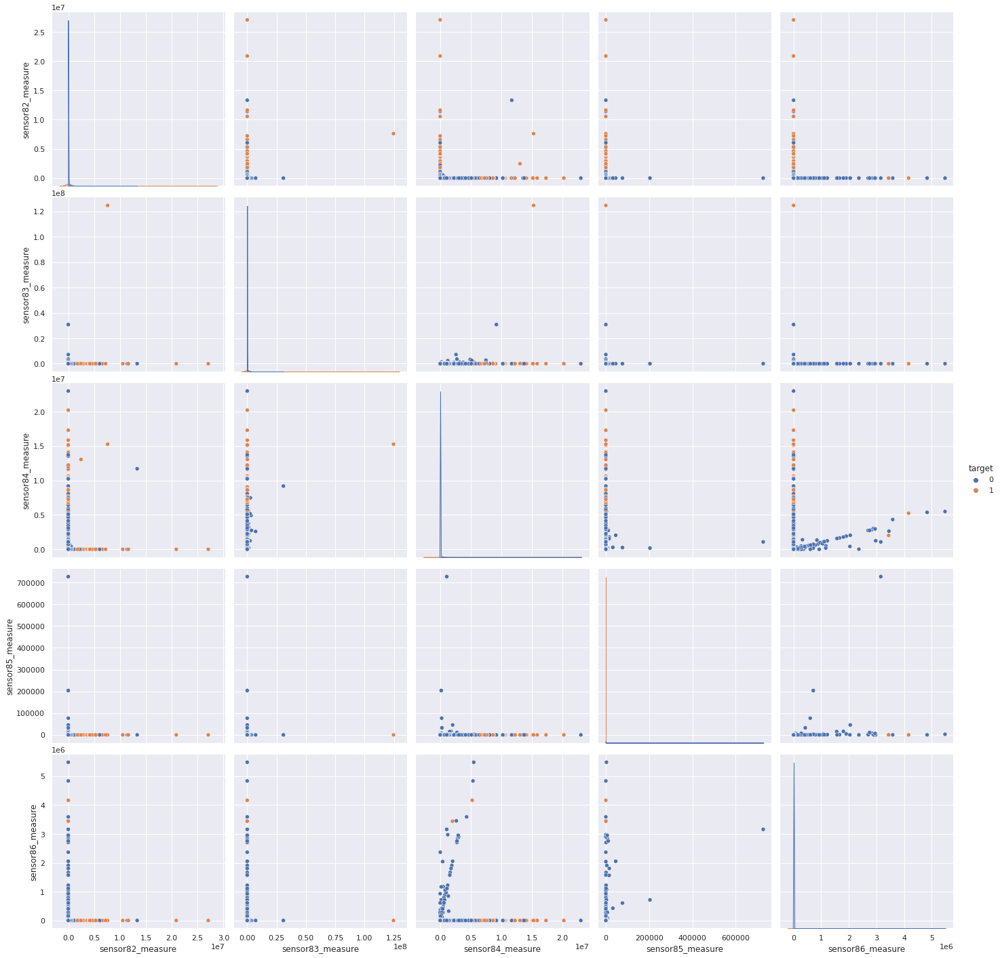

In [ ]:
col=['sensor82_measure', 'sensor83_measure', 'sensor84_measure', 'sensor85_measure', 'sensor86_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

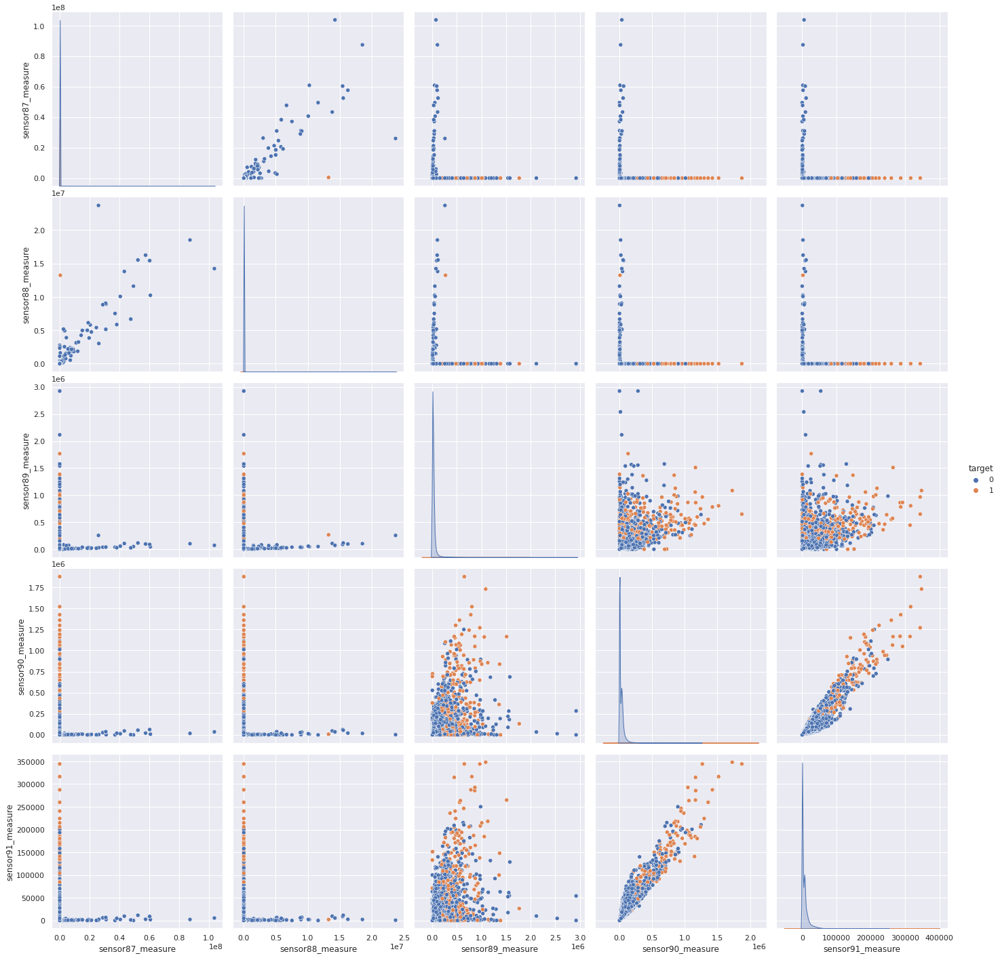

In [ ]:
col=['sensor87_measure', 'sensor88_measure', 'sensor89_measure', 'sensor90_measure', 'sensor91_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

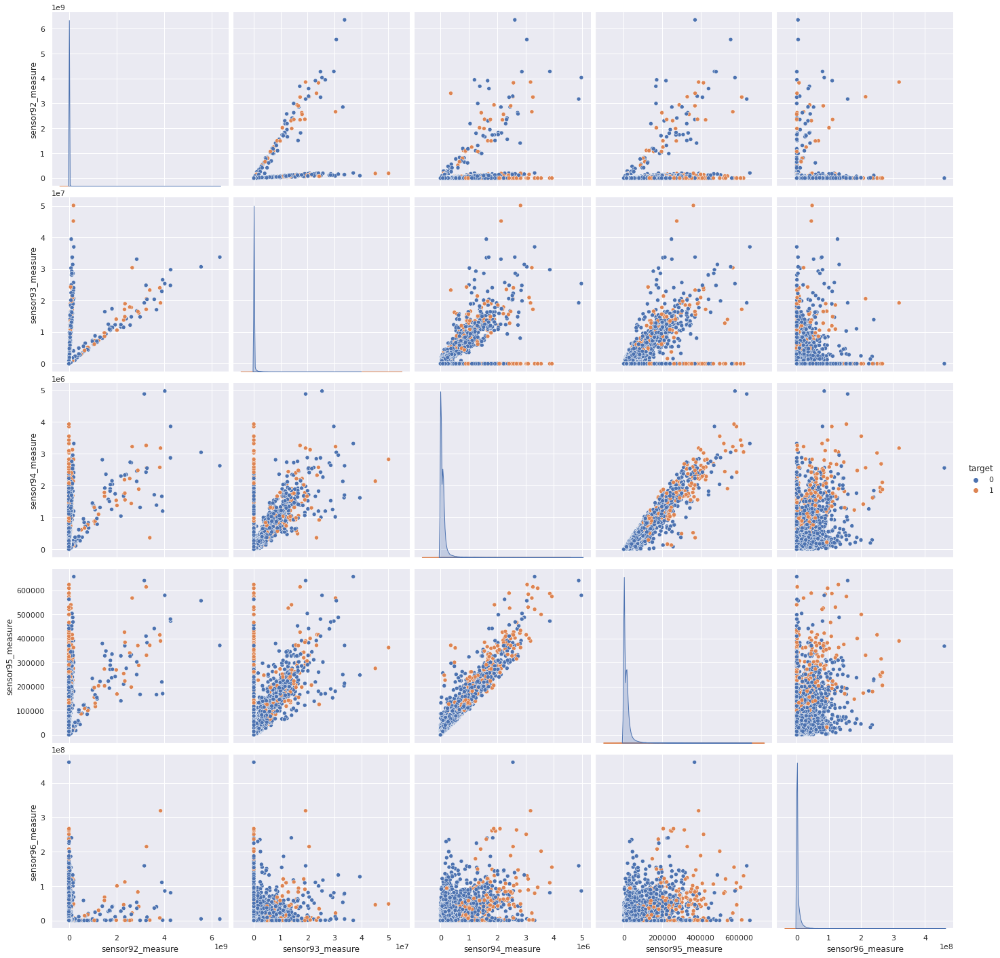

In [ ]:
col=['sensor92_measure', 'sensor93_measure', 'sensor94_measure', 'sensor95_measure', 'sensor96_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

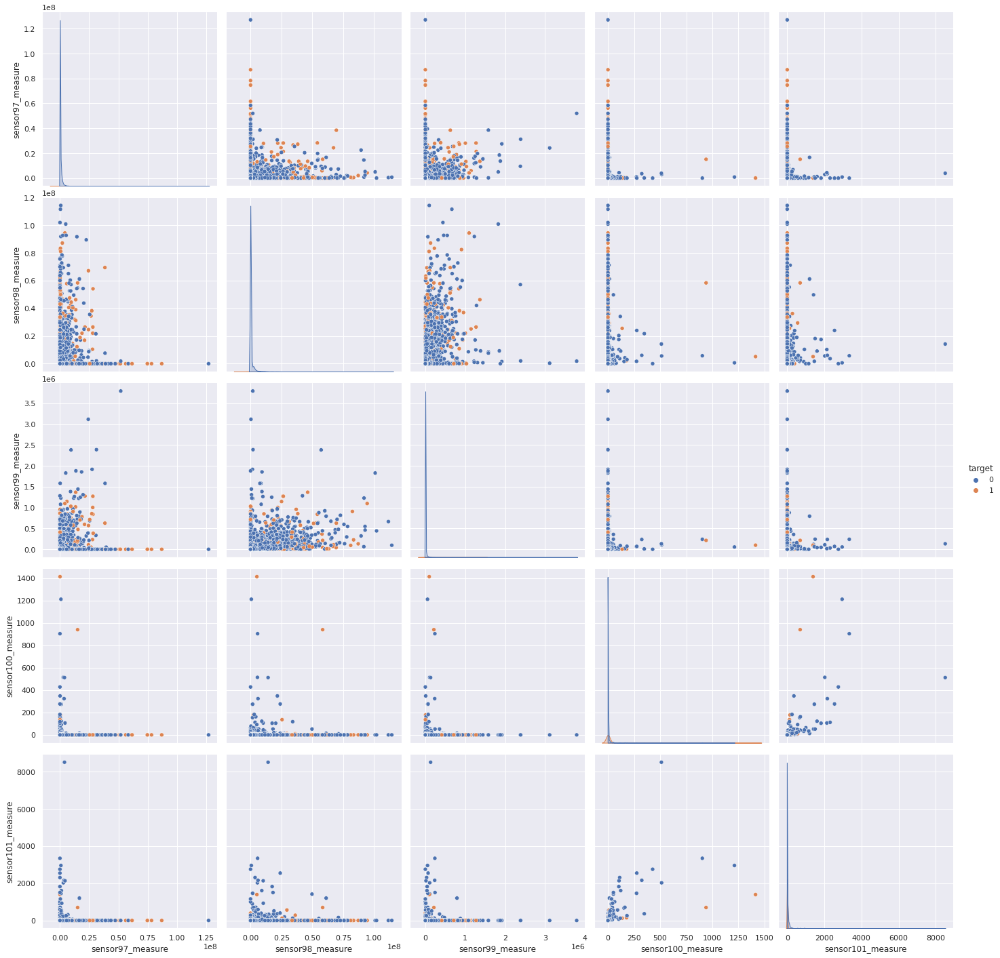

In [ ]:
col=['sensor97_measure', 'sensor98_measure', 'sensor99_measure', 'sensor100_measure', 'sensor101_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

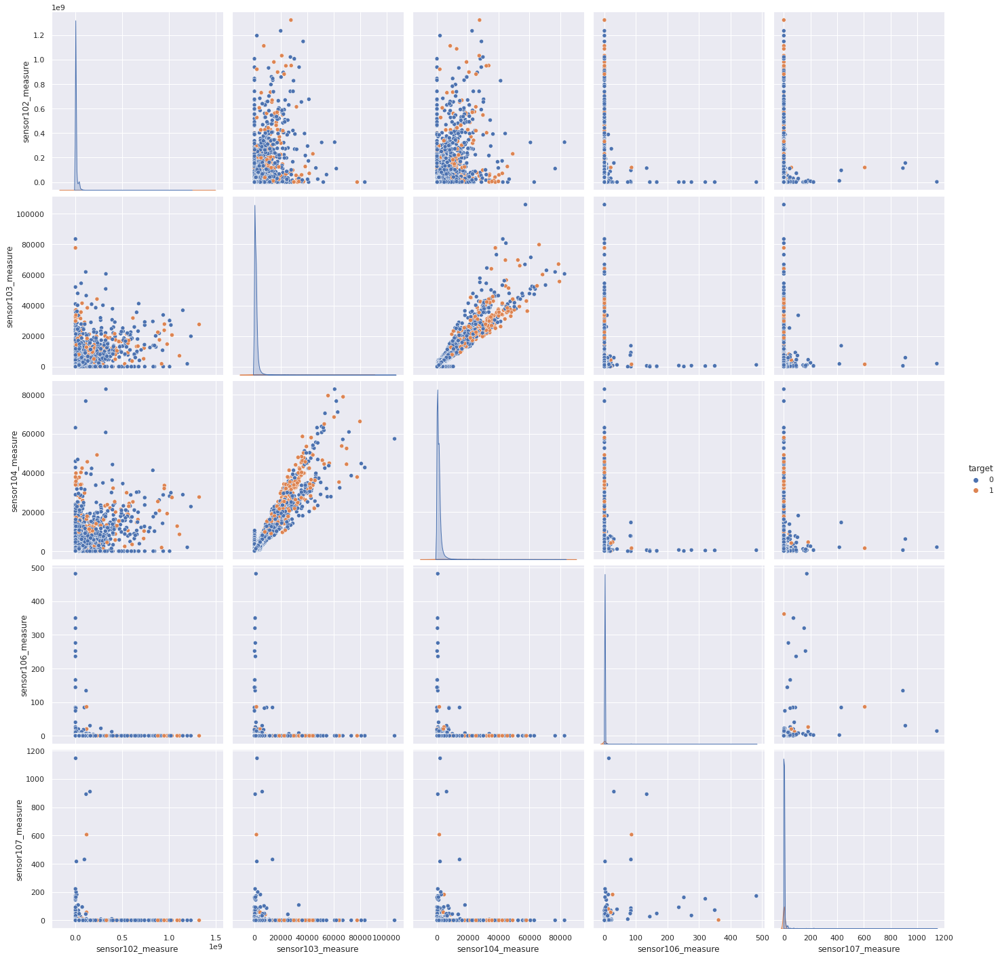

In [ ]:
col=['sensor102_measure', 'sensor103_measure', 'sensor104_measure', 'sensor106_measure', 'sensor107_measure']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid")
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

## Pair-plot on time based sensors:

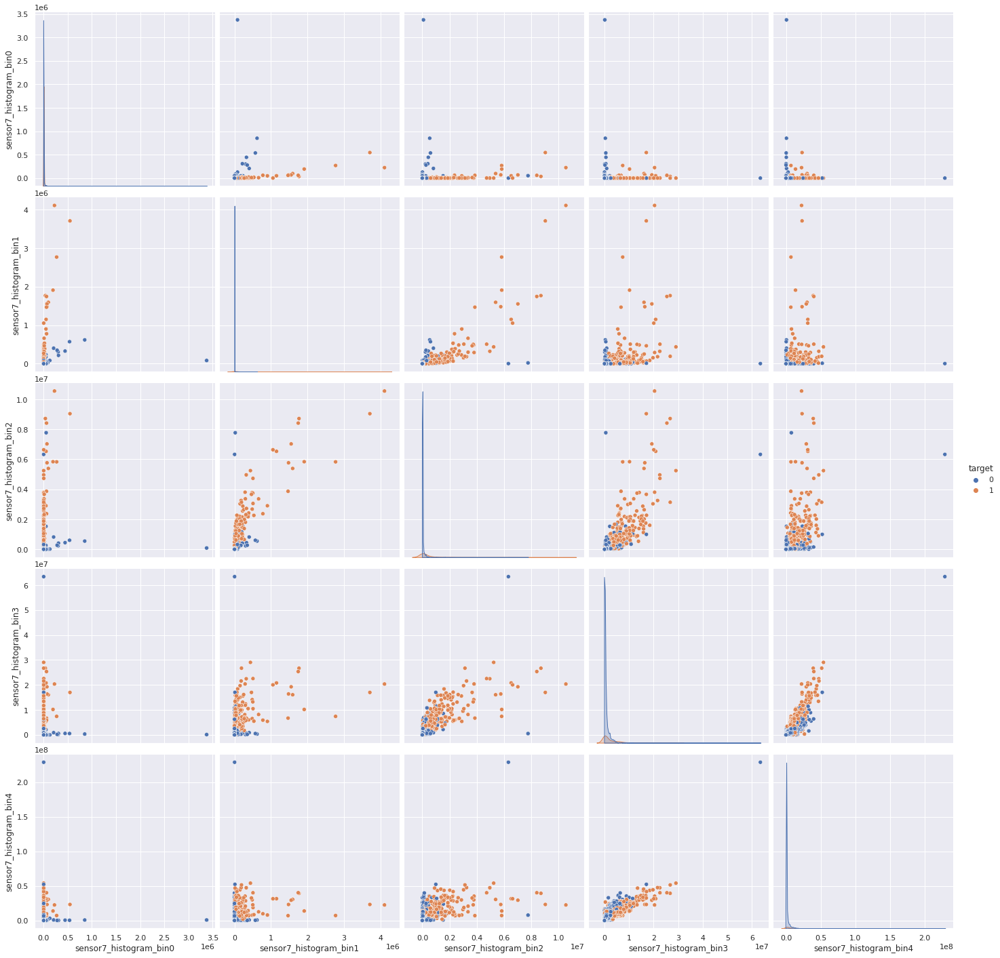

In [ ]:
col=['sensor7_histogram_bin0', 'sensor7_histogram_bin1', 'sensor7_histogram_bin2', 'sensor7_histogram_bin3', 'sensor7_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

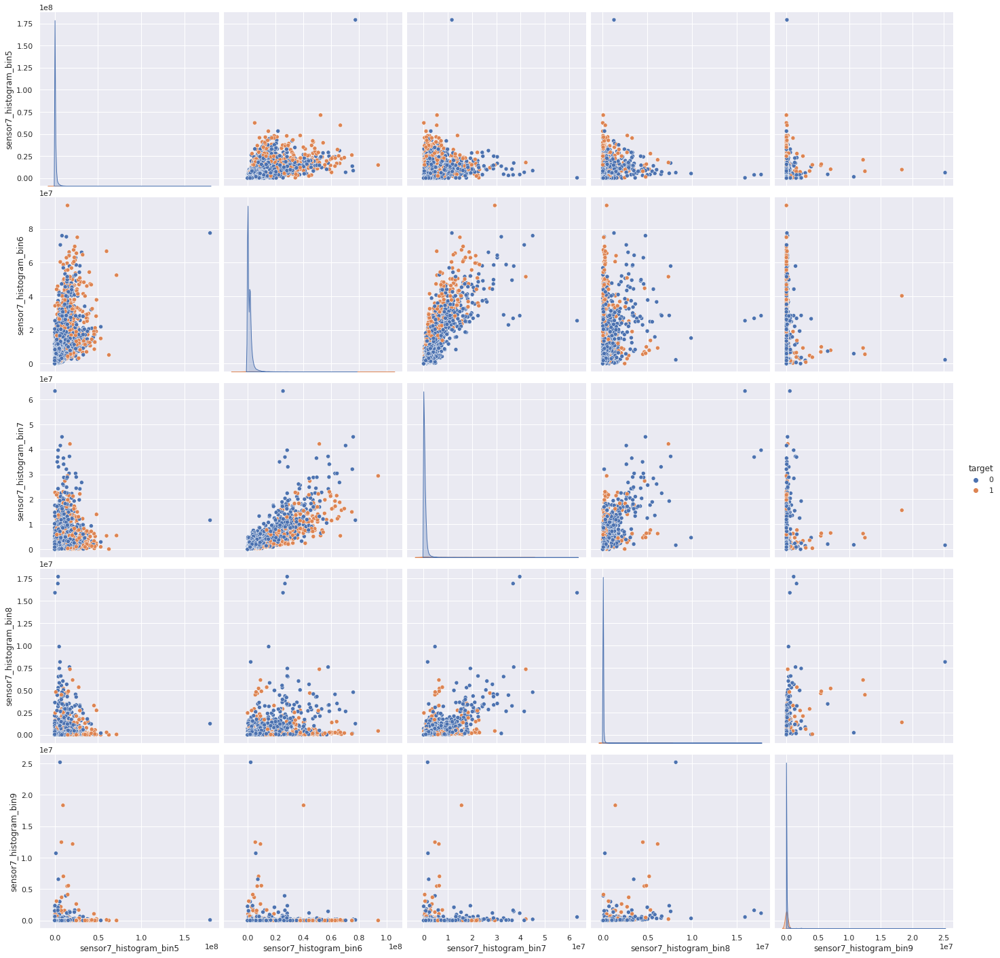

In [ ]:
col=['sensor7_histogram_bin5', 'sensor7_histogram_bin6', 'sensor7_histogram_bin7', 'sensor7_histogram_bin8', 'sensor7_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

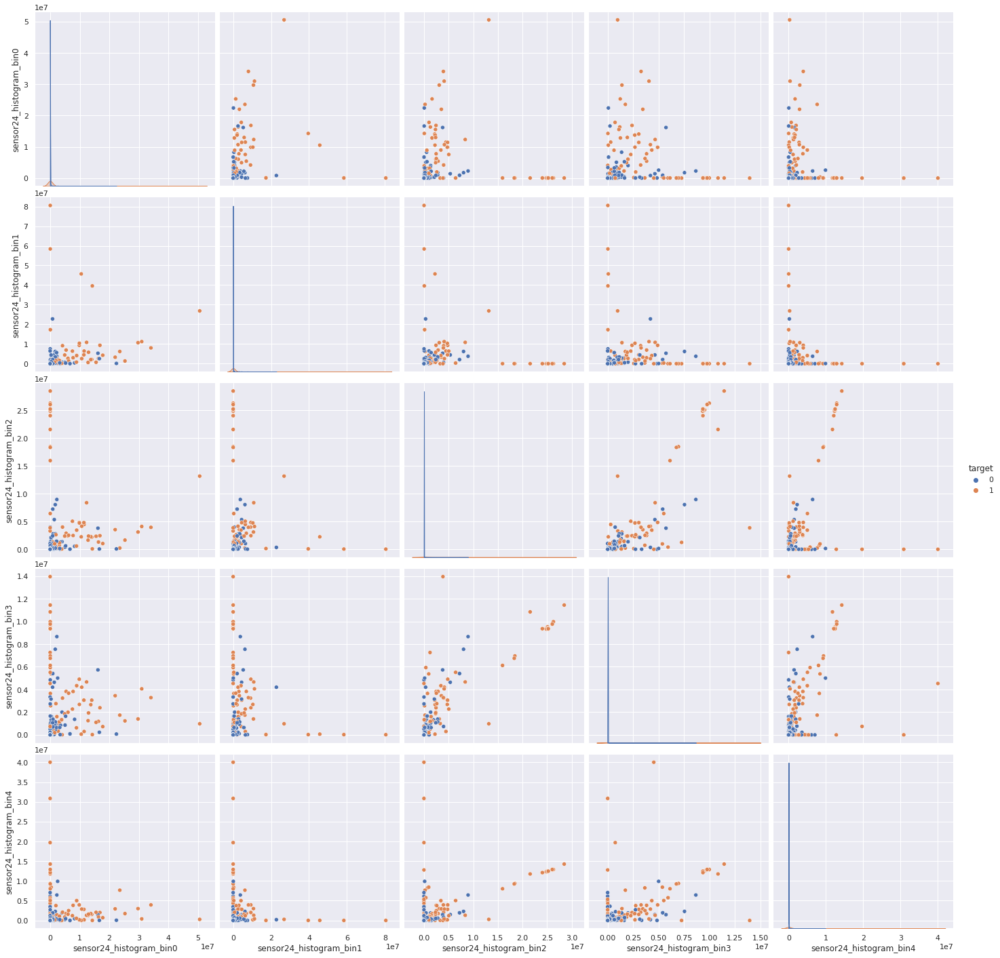

In [ ]:
col=['sensor24_histogram_bin0', 'sensor24_histogram_bin1', 'sensor24_histogram_bin2', 'sensor24_histogram_bin3', 'sensor24_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

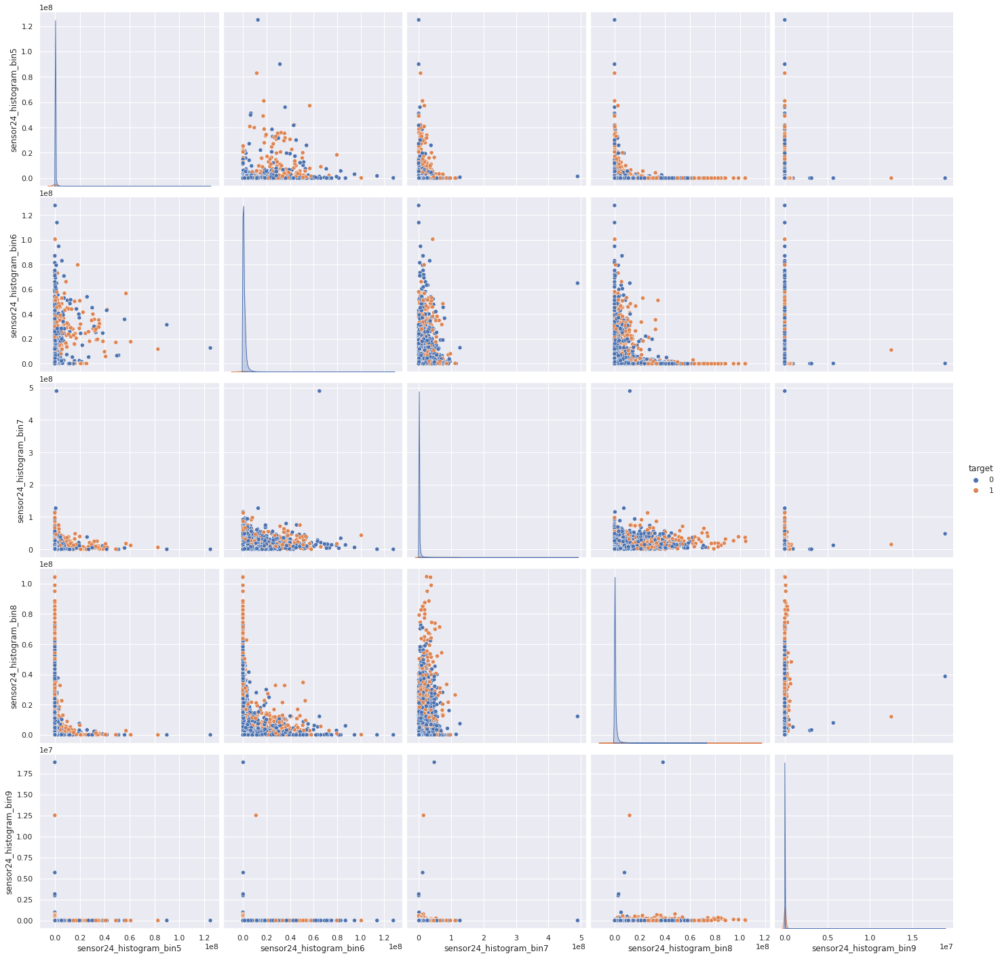

In [ ]:
col=['sensor24_histogram_bin5', 'sensor24_histogram_bin6', 'sensor24_histogram_bin7', 'sensor24_histogram_bin8', 'sensor24_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

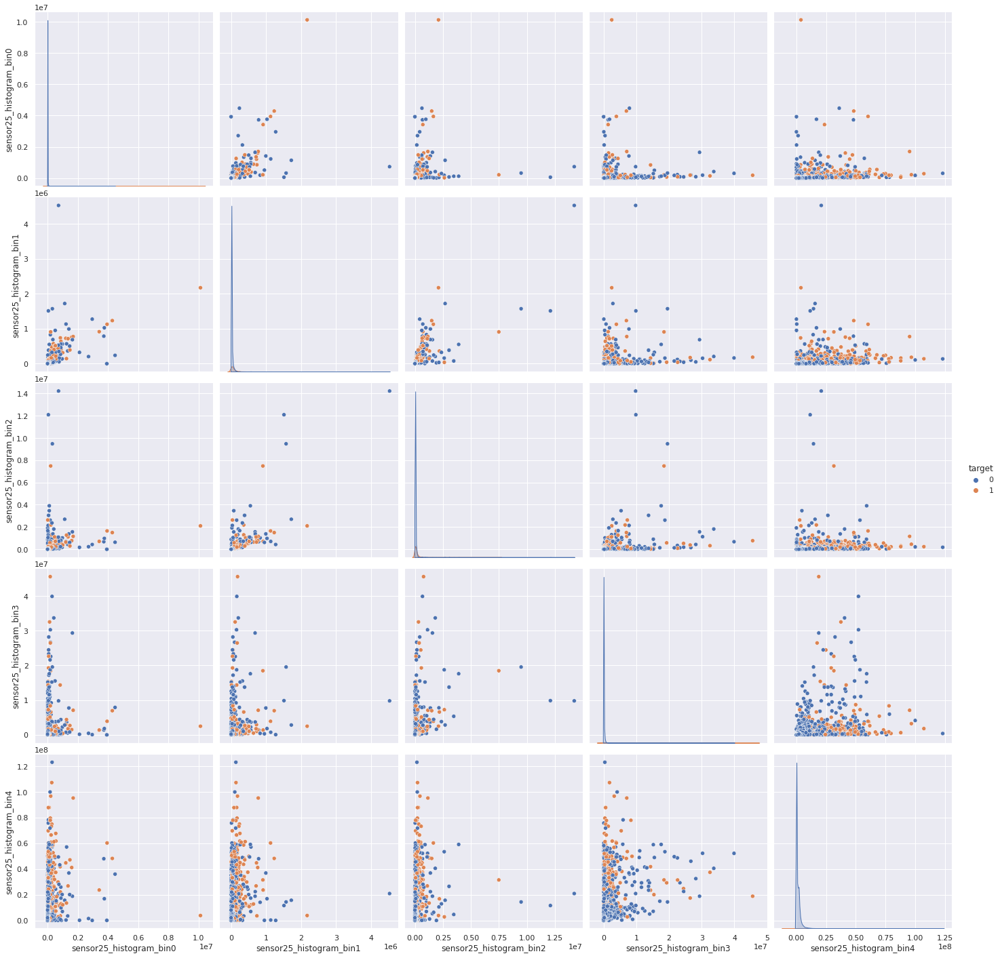

In [ ]:
col=['sensor25_histogram_bin0', 'sensor25_histogram_bin1', 'sensor25_histogram_bin2', 'sensor25_histogram_bin3', 'sensor25_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

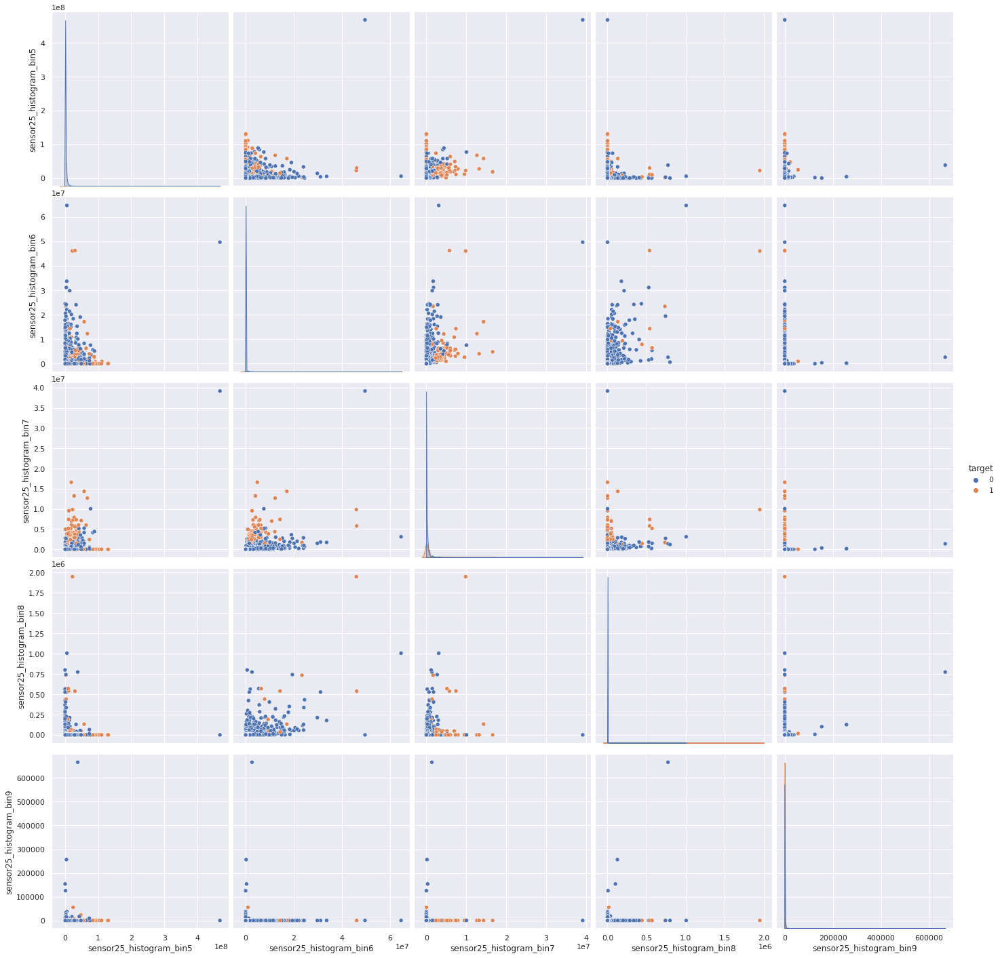

In [ ]:
col=['sensor25_histogram_bin5', 'sensor25_histogram_bin6', 'sensor25_histogram_bin7', 'sensor25_histogram_bin8', 'sensor25_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

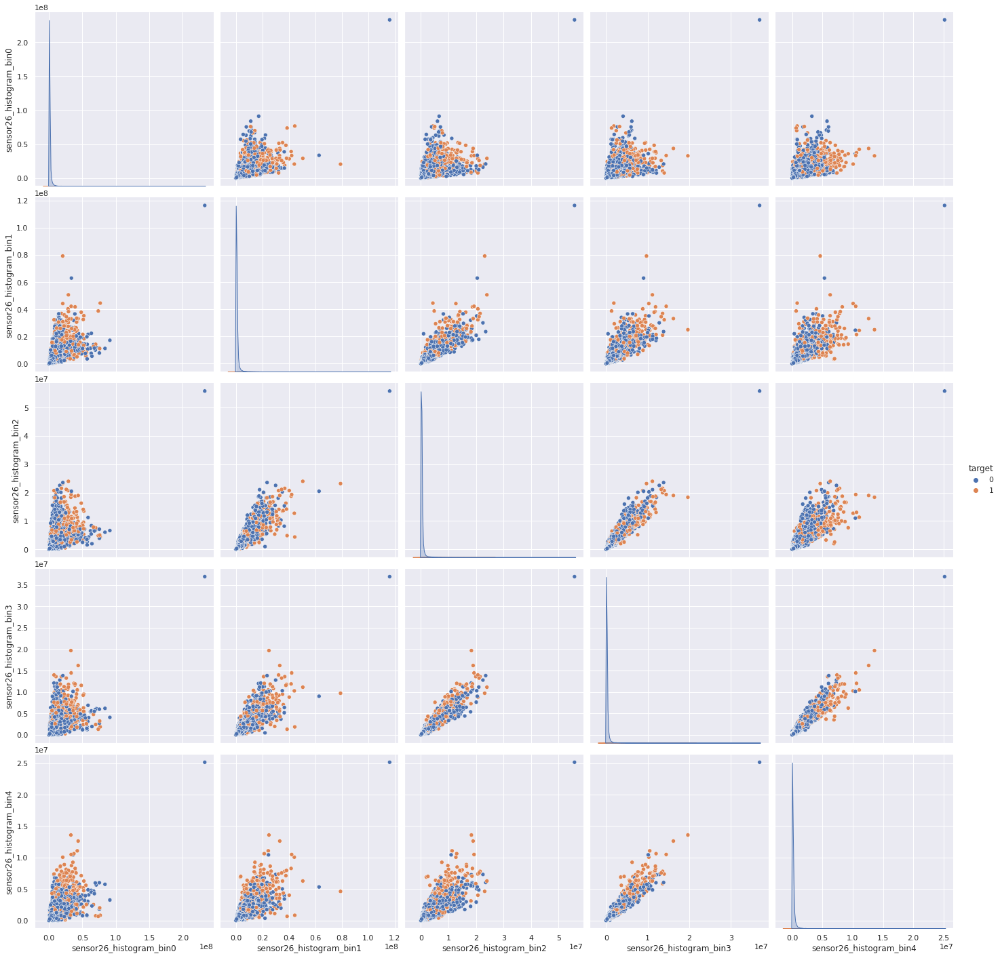

In [ ]:
col=['sensor26_histogram_bin0', 'sensor26_histogram_bin1', 'sensor26_histogram_bin2', 'sensor26_histogram_bin3', 'sensor26_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

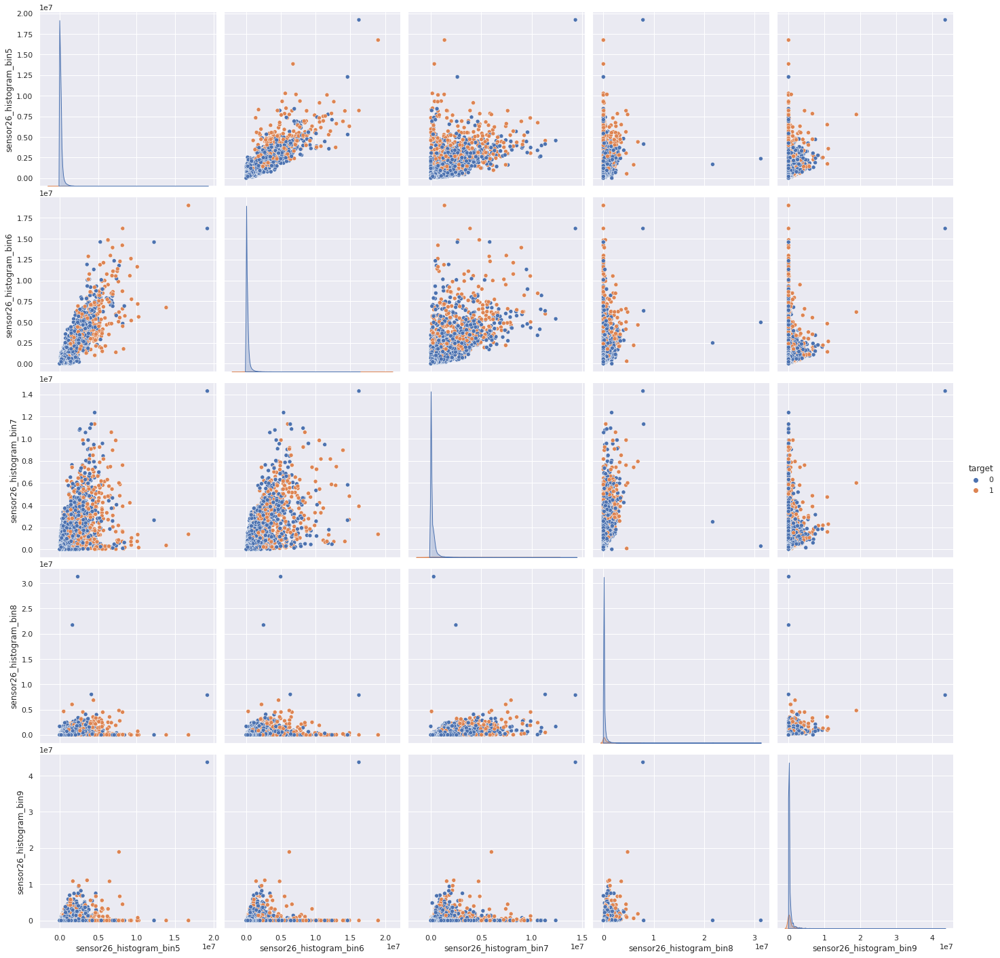

In [ ]:
col=['sensor26_histogram_bin5', 'sensor26_histogram_bin6', 'sensor26_histogram_bin7', 'sensor26_histogram_bin8', 'sensor26_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

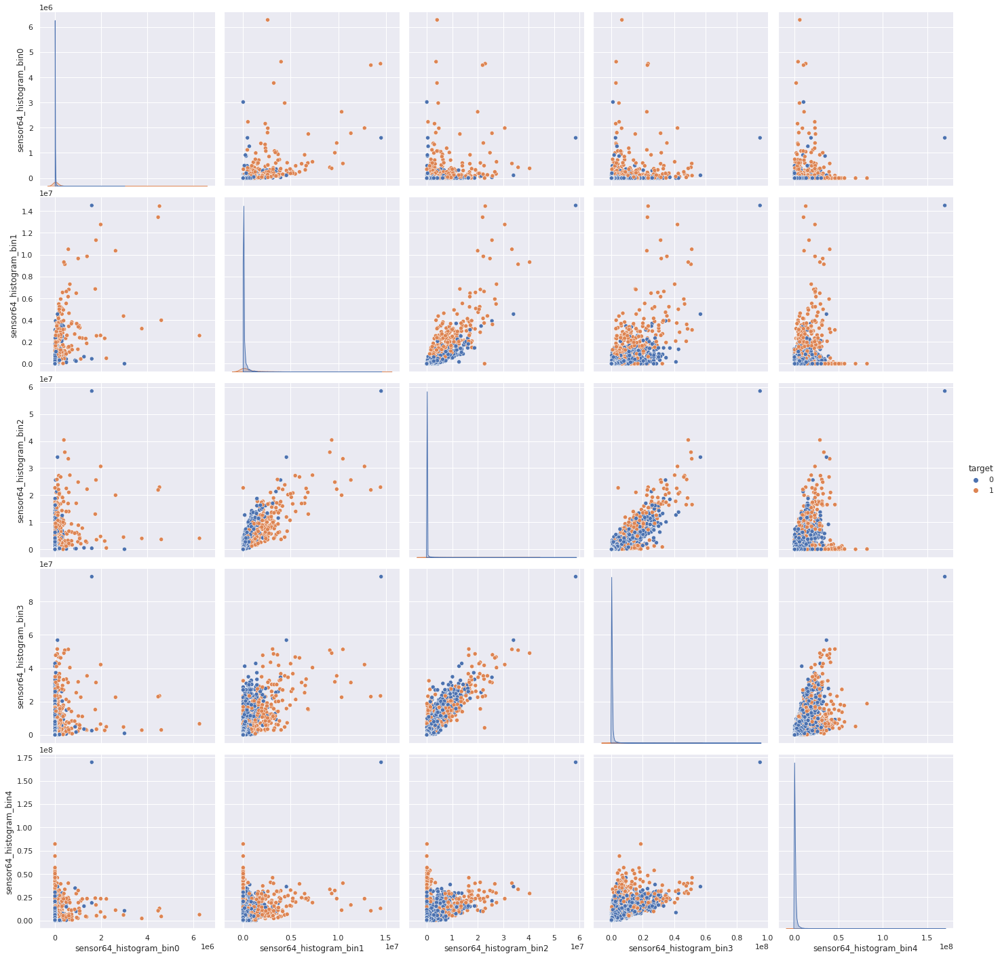

In [ ]:
col=['sensor64_histogram_bin0', 'sensor64_histogram_bin1', 'sensor64_histogram_bin2', 'sensor64_histogram_bin3', 'sensor64_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

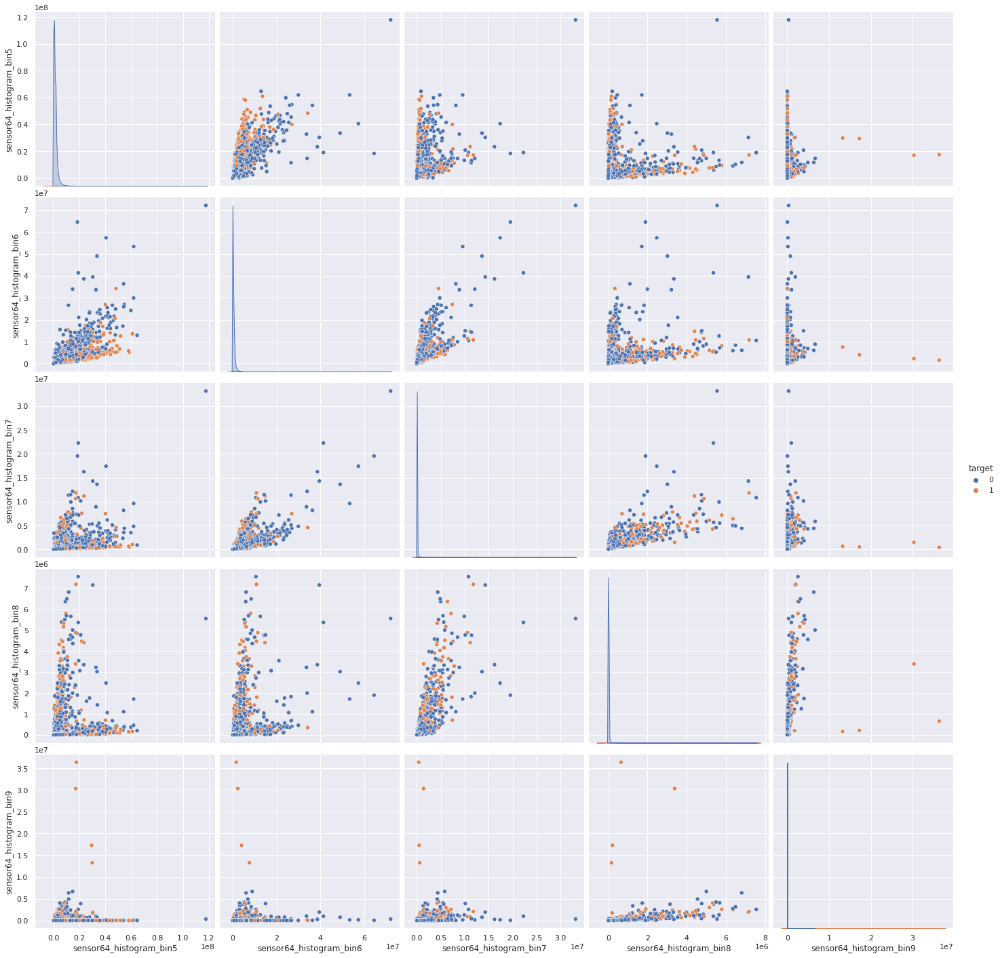

In [ ]:
col=['sensor64_histogram_bin5', 'sensor64_histogram_bin6', 'sensor64_histogram_bin7', 'sensor64_histogram_bin8', 'sensor64_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

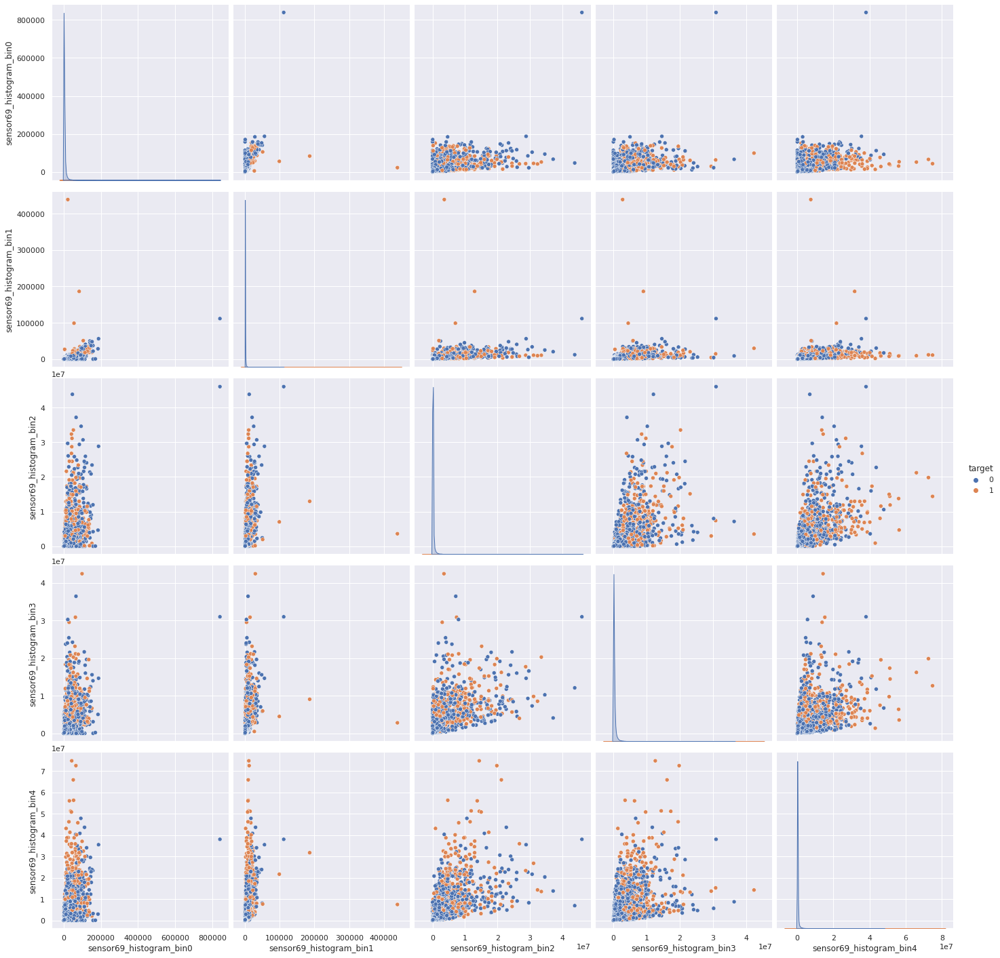

In [ ]:
col=['sensor69_histogram_bin0', 'sensor69_histogram_bin1', 'sensor69_histogram_bin2', 'sensor69_histogram_bin3', 'sensor69_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

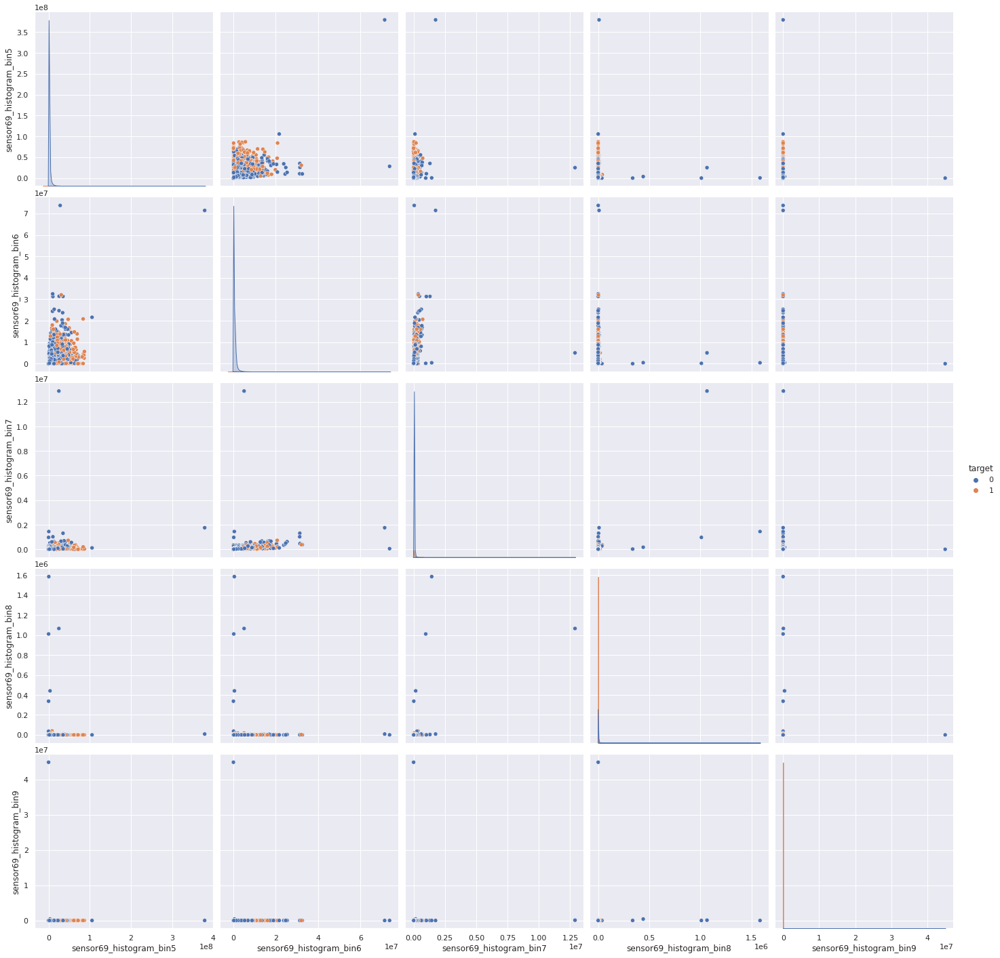

In [ ]:
col=['sensor69_histogram_bin5', 'sensor69_histogram_bin6', 'sensor69_histogram_bin7', 'sensor69_histogram_bin8', 'sensor69_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

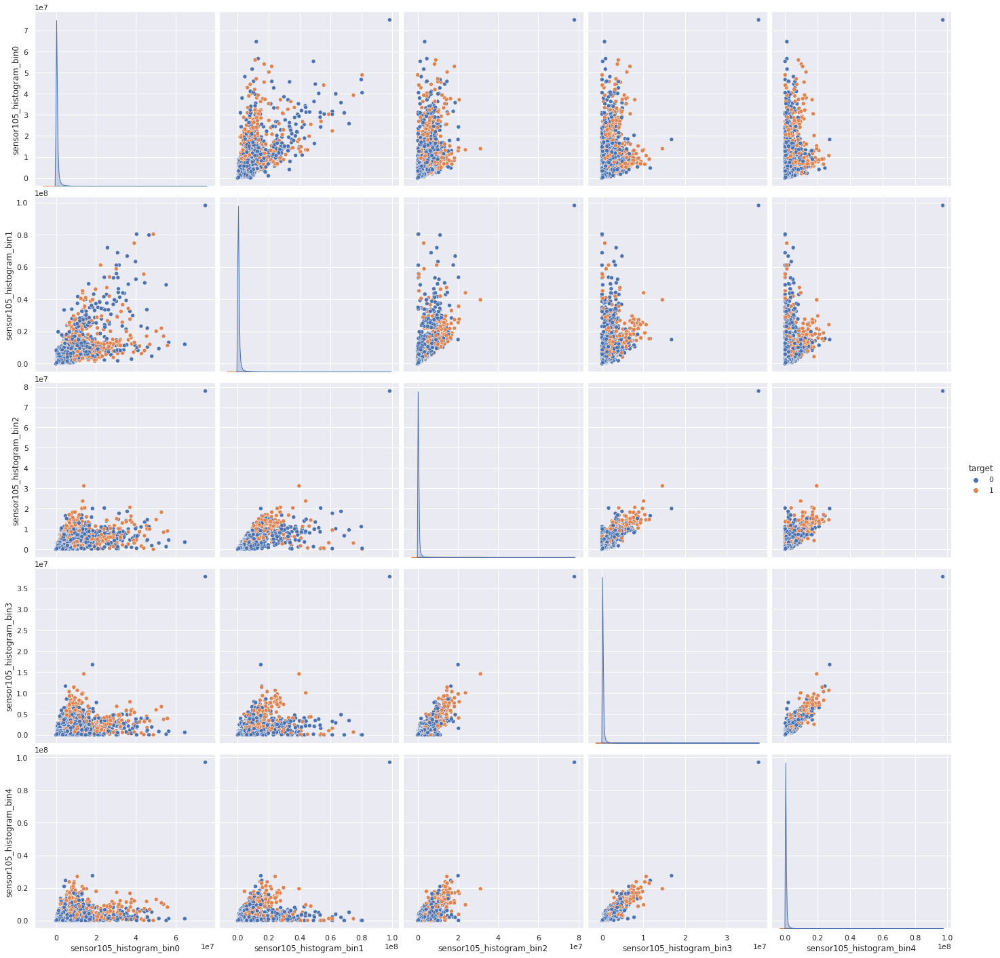

In [ ]:
col=['sensor105_histogram_bin0', 'sensor105_histogram_bin1', 'sensor105_histogram_bin2', 'sensor105_histogram_bin3', 'sensor105_histogram_bin4']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

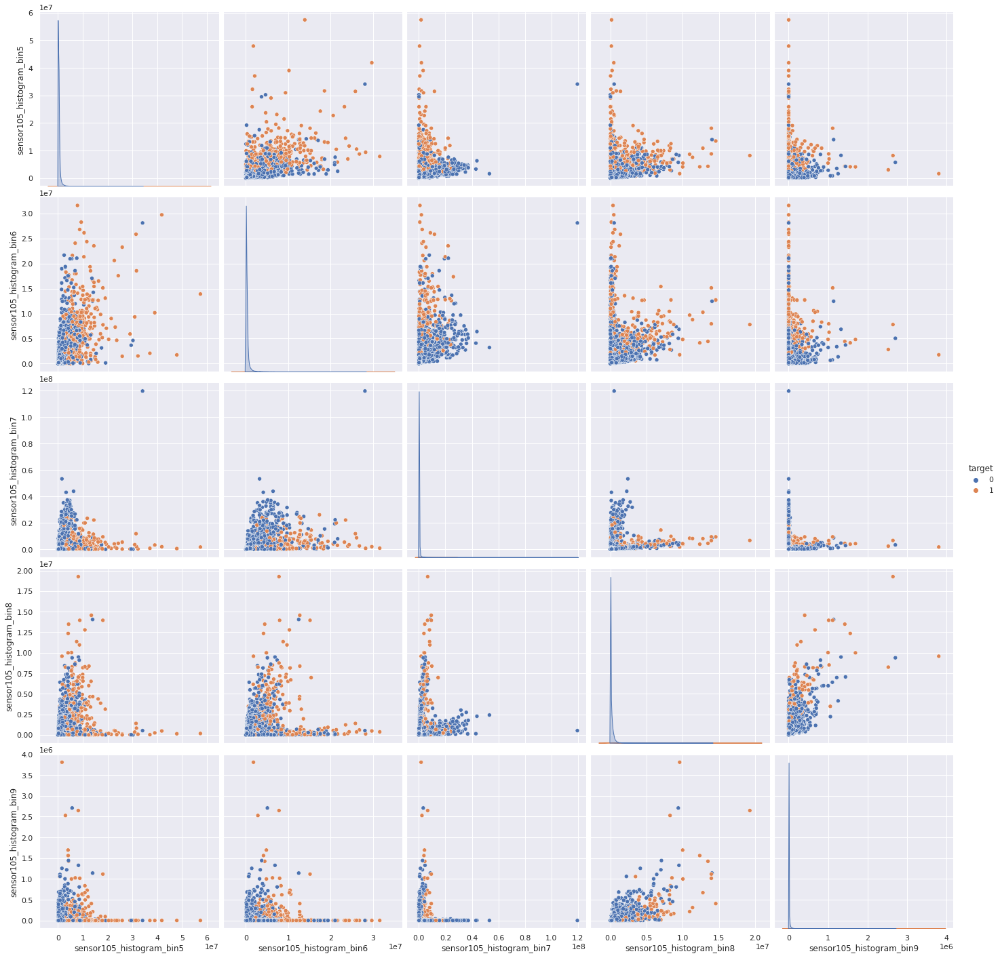

In [ ]:
col=['sensor105_histogram_bin5', 'sensor105_histogram_bin6', 'sensor105_histogram_bin7', 'sensor105_histogram_bin8', 'sensor105_histogram_bin9']
temp = data_frame[col]
temp['target'] = data_frame.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.0)
sns.pairplot(temp, hue='target', size=4, vars=col);
plt.show()

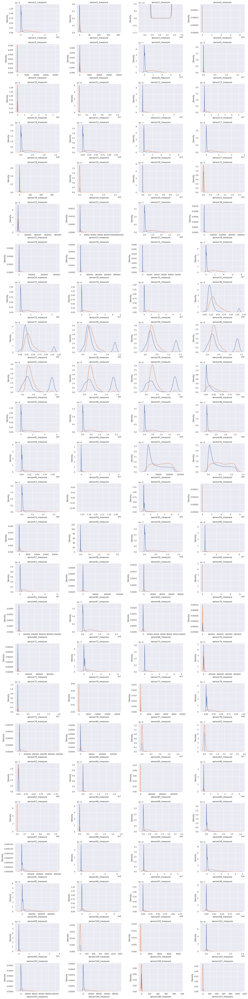

In [ ]:
fig, axes = plt.subplots(25, 4, figsize=(20,80))
axes = axes.flatten()

for i,column in enumerate(sensor_column_names):
    sns.distplot(df_0[column], hist=False, ax=axes[i], label='0')
    sns.distplot(df_1[column], hist=False, ax=axes[i], label='1')
    axes[i].set_title(column)
    fig.tight_layout()

### Observation

1. Maximum sensor graphs are overlapping due to segrate the data points by a particular sensor.
2. sensor1, sensor8, sensor14, sensor15, sensor16, sensor17, sensor27, sensor67, sensor72, sensor73, sensor78, sensor79, sensor81, sensor82, sensor84, sensor87, sensor89, sensor90, sensor91, sensor94, sensor95, sensor102, sensor103,sensor104 are visually seperable.
3. These seperable distributions add greater value to the final classification hence it would be necessary to look at their importance onces we apply the same on Models.

In [ ]:
#histogram plots on histogram_columns
histogram_column_names = []
for column in data_frame.columns:
    if column != 'id' and column != 'target':
        column_name = column.split("_")
        if column_name[1] == 'histogram':
            histogram_column_names.append(column)

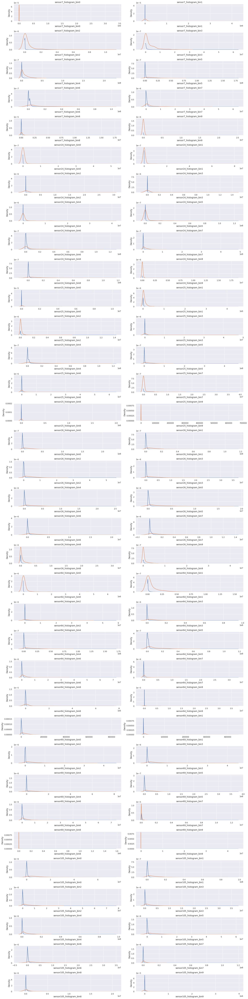

In [ ]:
fig, axes = plt.subplots(35, 2, figsize=(20,80))
axes = axes.flatten()

for i,column in enumerate(histogram_column_names):
    sns.distplot(df_0[column], hist=False, ax=axes[i], label='0')
    sns.distplot(df_1[column], hist=False, ax=axes[i], label='1')
    axes[i].set_title(column)
    fig.tight_layout()

### Observation:

1. After seeing the graph, it is difficult to visually seperate the values depending on their distribution over bins.
2. Most of the values are near zero. So we can conclude that more number of 0's in the bins.

### Checking the columns more than 50% of Null values:

In [ ]:
null_values = data_frame.isnull().sum(axis = 0)

In [ ]:
value = []
names = []

for k, v in null_values.iteritems():
    if k!='target' and k!='id':
        names.append(k)
        value.append(v)

In [ ]:
null_values = null_values.sort_values(ascending=False)

In [ ]:
null_values_list = []
for column_name, value in null_values.items():
    if value > 30000:
        null_values_list.append(column_name)

print(null_values_list)

['sensor43_measure', 'sensor42_measure', 'sensor41_measure', 'sensor40_measure', 'sensor68_measure', 'sensor2_measure', 'sensor39_measure', 'sensor38_measure']


### Observation:

1. These are the columns that having more than 50% of null values.
2. We can drop these columns. But Before dropping the columns we have to check the correlation with the target value for each column.

In [ ]:
for column in null_values_list:
    print("Correlation between " + column + " and target is: " + str(data_frame[column].corr(data_frame['target'])))

Correlation between sensor43_measure and target is: -0.14302549793845004
Correlation between sensor42_measure and target is: -0.13140891445018857
Correlation between sensor41_measure and target is: -0.11065586976877141
Correlation between sensor40_measure and target is: -0.08666269235350954
Correlation between sensor68_measure and target is: 0.0662276940632288
Correlation between sensor2_measure and target is: 0.03189609336029865
Correlation between sensor39_measure and target is: -0.057736003010924325
Correlation between sensor38_measure and target is: -0.021159379309264092


In [ ]:
# If the number of null values are greater than 50% of the data set it is better to drop them since they would not contribute anything.
print("Number of Columns before dropping null columns",data_frame.shape[1])
for column_name, value in null_values.items():
    if value > 30000:
        data_frame = data_frame.drop([column_name], axis=1)

print("Number of Columns after dropping null columns",data_frame.shape[1])

Number of Columns before dropping null columns 172
Number of Columns after dropping null columns 164


## Check for 0's in each feature

In [ ]:
# Dropping columns with 95% zeros
zero_columns = []
for column in data_frame.columns:
    if column != 'target' and column!='id':
        value = data_frame[column].value_counts()
        if 0 in value:
            if value[0] >= (0.95*60000):
                zero_columns.append(column)
                print(column, '---> % of zeros',(value[0]*100/60000))

sensor7_histogram_bin0 ---> % of zeros 98.555
sensor7_histogram_bin1 ---> % of zeros 97.645
sensor19_measure ---> % of zeros 98.91666666666667
sensor21_measure ---> % of zeros 98.85
sensor24_histogram_bin0 ---> % of zeros 97.935
sensor24_histogram_bin1 ---> % of zeros 96.98666666666666
sensor24_histogram_bin2 ---> % of zeros 96.93666666666667
sensor24_histogram_bin3 ---> % of zeros 96.79666666666667
sensor24_histogram_bin4 ---> % of zeros 95.26333333333334
sensor24_histogram_bin9 ---> % of zeros 97.98166666666667
sensor25_histogram_bin9 ---> % of zeros 95.74166666666666
sensor64_histogram_bin0 ---> % of zeros 95.5
sensor106_measure ---> % of zeros 95.035


## Checking the correlation between the columns with >95% zeros and the target column

In [ ]:
for column in zero_columns:
    print("Correlation between " + column + " and target is: " + str(data_frame[column].corr(data_frame['target'])))

Correlation between sensor7_histogram_bin0 and target is: 0.012367940966279845
Correlation between sensor7_histogram_bin1 and target is: 0.19145294893300618
Correlation between sensor19_measure and target is: 0.044105150644670424
Correlation between sensor21_measure and target is: 0.09313679837210047
Correlation between sensor24_histogram_bin0 and target is: 0.15708121126687163
Correlation between sensor24_histogram_bin1 and target is: 0.11190739521272208
Correlation between sensor24_histogram_bin2 and target is: 0.1655611287366249
Correlation between sensor24_histogram_bin3 and target is: 0.19103827667736953
Correlation between sensor24_histogram_bin4 and target is: 0.1799881213531044
Correlation between sensor24_histogram_bin9 and target is: 0.0424479185985232
Correlation between sensor25_histogram_bin9 and target is: 0.002531502034032261
Correlation between sensor64_histogram_bin0 and target is: 0.2322714169351093
Correlation between sensor106_measure and target is: 0.01839996724449

In [ ]:
value = []

for column in zero_columns:
    value.append(data_frame[column].value_counts()[0])

In [ ]:
fig = plt.figure(figsize=(200,100))
ax = fig.add_axes([0,0,1,1])
ax.bar(zero_columns,value)
plt.setp(ax.get_xticklabels(), fontsize=80, rotation='vertical')
plt.yticks(fontsize=80)
plt.show()

## Obseravtion:
- There are few sensors who have most of the values are Zero namely Sensor 7 bin 0-1, Sensor 19, Sensor 21, Sensor 24 bin 0-4, Sensor 24 bin9, Sensor 25 bin9, Sensor 64 bin0 and sensor 106 measure.
- These sensors have more than 95% of their values to zero thus providing no contribution to final classification.

### Dropping columns with >95% number of rows of zero

We can modify the dataframe in this situation before train, test split is because we are removing the entire column and not performing any modification to value or imputation.

In [ ]:
print("Number of columns before dropping Zero columns:", data_frame.shape[1])
data_frame = data_frame.drop(zero_columns, axis=1)
print("Number of columns after dropping Zero columns:", data_frame.shape[1])

Number of columns before dropping Zero columns: 164
Number of columns after dropping Zero columns: 151


### Check for distinction between the two classes using quantile and box plots

In [ ]:
df_0 = data_frame[data_frame['target']==0]
df_1 = data_frame[data_frame['target']==1]

In [ ]:
# Checking the percentile of 0 and 1 of each column to see which features provide better seperation.
# comparing if 90th percentile of 0 < 10th percentile of 1 and also 10th percentile of 1 > 90th percentile of 0
# Choosing Columns between 10 and 90th percentile with significant difference in the two class distribution

quantiles_0 = df_0.quantile([0.1, 0.9], axis=0)
quantiles_1 = df_1.quantile([0.1, 0.9], axis=0)

important_features = []
for col in quantiles_0.columns:
    if col != 'id' and col != 'target':
        col_name = col.split("_")
        if (quantiles_0[col].iloc[0] > quantiles_1[col].iloc[1]) or (quantiles_1[col].iloc[0] > quantiles_0[col].iloc[1]) and (col_name[1] != 'histogram'):
            important_features.append(col)

# print(important_features[:5], len(important_features))

These are the features which may add importance in the decision making at the end since the 10th and 90th percentile of each of these features are seperable and hence useful in decision making. The sensors that are part of this are as follows

 sensor1_measure

 sensor8_measure

 sensor14_measure

 sensor15_measure

 sensor16_measure

 sensor17_measure

 sensor27_measure

 sensor32_measure

 sensor33_measure

 sensor34_measure

 sensor35_measure

 sensor45_measure

 sensor46_measure

 sensor47_measure

 sensor59_measure

 sensor61_measure

 sensor67_measure
 
 sensor89_measure

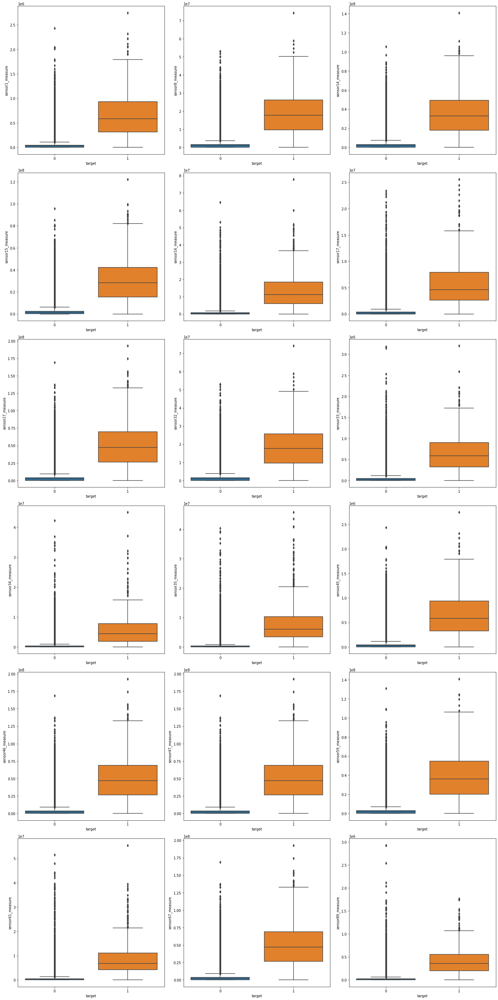

In [ ]:
fig, axes = plt.subplots(6, 3, figsize=(20,40))
axes = axes.flatten()

for i, column in enumerate(important_features):
    ax = sns.boxplot(x="target", y=column, data=data_frame,  ax=axes[i])

fig.tight_layout()

### Observation:

- The above box plots are for the features whose distribution is highly seperable where the 10th percentile of one class is greater than 90th percentile of the other class.
- Since most of the data can be classified visually from these sensors, it is important to note that these features might contribute more to the final classification and also it would be important to note if these features are correlated.

## Get Sensor details
Here we will try to get all detail infomation of all sensors. Below are the details we have calculated.


1. Max of sensor data
2. Min of sensor data
3. Max of surface failure
4. Min of surface failure
5. Max of Downhole failure
6. min of Downhole failure
7. Mean of sensor data
8. Median of sensor data
9. Mean of surface failure
10. Median of surface failure
11. Mean of Downhole failure
12. Median of Downhole failure
13. 25 percentile
14. 50 percentile
15. 75 percentile

In [ ]:
# reference https://www.kaggle.com/garteb/eda-of-sensors-data-phase-1

def get_sensor_details(col_name, df1):
    temp = pd.DataFrame()
    columns=['Sensor','Max','Min','Max_sur_fail','Min_sur_fail','Max_down_fail','Min_down_fail','Mean','Median',
             'Mean_sur_fail','Median_sur_fail','Mean_down_fail','Median_down_fail','Qt_0.25','Qt_0.5','Qt_0.75']
    for col in col_name:
        #print(col)
        A, B, C = df1[col].quantile([0.25,0.5,0.75]).values
        temp_s = df1[df1['target']==0][col]
        temp_d = df1[df1['target']==1][col]
        temp2 = pd.Series([col, max(df1[col]), min(df1[col]), max(temp_s), min(temp_s), max(temp_d), min(temp_d), 
                           df1[col].mean() ,df1[col].median(),temp_s.mean(),temp_s.median(),temp_d.mean(),temp_d.median(),
                           A, B, C], name='Details')
        temp2.index = columns
        temp = temp.append(temp2)
    temp = temp[columns]
    return temp

col_name = data_frame.iloc[:,2:].columns
detail_sensor = get_sensor_details(col_name, data_frame)

In [ ]:
detail_sensor.head(10)

,Sensor,Max,Min,Max_sur_fail,Min_sur_fail,Max_down_fail,Min_down_fail,Mean,Median,Mean_sur_fail,Median_sur_fail,Mean_down_fail,Median_down_fail,Qt_0.25,Qt_0.5,Qt_0.75
Details,sensor1_measure,2.746564e+06,0.0,2.434708e+06,0.0,2.746564e+06,0.0,5.933650e+04,30776.0,4.916977e+04,30416.0,6.591737e+05,584994.0,834.0,30776.0,48668.0
Details,sensor3_measure,2.130707e+09,0.0,2.130707e+09,0.0,2.130706e+09,0.0,3.560143e+08,152.0,3.588573e+08,150.0,5.940968e+07,865.0,16.0,152.0,964.0
Details,sensor4_measure,8.584298e+09,0.0,8.584298e+09,0.0,NaN,NaN,1.906206e+05,126.0,1.921137e+05,124.0,2.262214e+03,648.0,24.0,126.0,430.0
Details,sensor5_measure,2.105000e+04,0.0,2.105000e+04,0.0,5.386000e+03,0.0,6.819130e+00,0.0,6.664802e+00,0.0,2.013050e+01,0.0,0.0,0.0,0.0
Details,sensor6_measure,2.007000e+04,0.0,2.007000e+04,0.0,1.128400e+04,0.0,1.100682e+01,0.0,1.049784e+01,0.0,5.490744e+01,0.0,0.0,0.0,0.0
Details,sensor7_histogram_bin2,1.055286e+07,0.0,7.771682e+06,0.0,1.055286e+07,0.0,8.606015e+03,0.0,1.915646e+03,0.0,4.004426e+05,2208.0,0.0,0.0,0.0
Details,sensor7_histogram_bin3,6.340207e+07,0.0,6.340207e+07,0.0,2.904730e+07,0.0,8.859128e+04,0.0,4.540666e+04,0.0,2.617797e+06,402419.0,0.0,0.0,0.0
Details,sensor7_histogram_bin4,2.288306e+08,0.0,2.288306e+08,0.0,5.396293e+07,0.0,4.370966e+05,3672.0,3.215971e+05,3424.0,7.201587e+06,3731539.0,308.0,3672.0,49522.0
Details,sensor7_histogram_bin5,1.791880e+08,0.0,1.791880e+08,0.0,7.132792e+07,0.0,1.108374e+06,176020.0,9.169252e+05,165806.0,1.232100e+07,9476568.0,13834.0,176020.0,913964.0
Details,sensor7_histogram_bin6,9.402067e+07,0.0,7.763627e+07,0.0,9.402067e+07,0.0,1.657818e+06,930336.0,1.469280e+06,879046.0,1.269997e+07,5677782.0,10608.0,930336.0,1886608.0


### Observation

From the above information we can identify below few points.

1. Difference between max and min is very large. Hence we need to perform normalization or standardization.
2. Mean of surface failure and median of surface failure is lesser than mean of downhole failure and median of downhole failure. This is the same we understood from time based and non time based sensor analysis where we noticed that for dowhole failure sensor values are increasing suddenly.
3. Also as per the IQR values (25 perntile and 75 percentile), mean values for surface and downhole failures are much higher. Hence while imputing Nan values we have to use median insted of mean value.

### Correlation of all sensor values

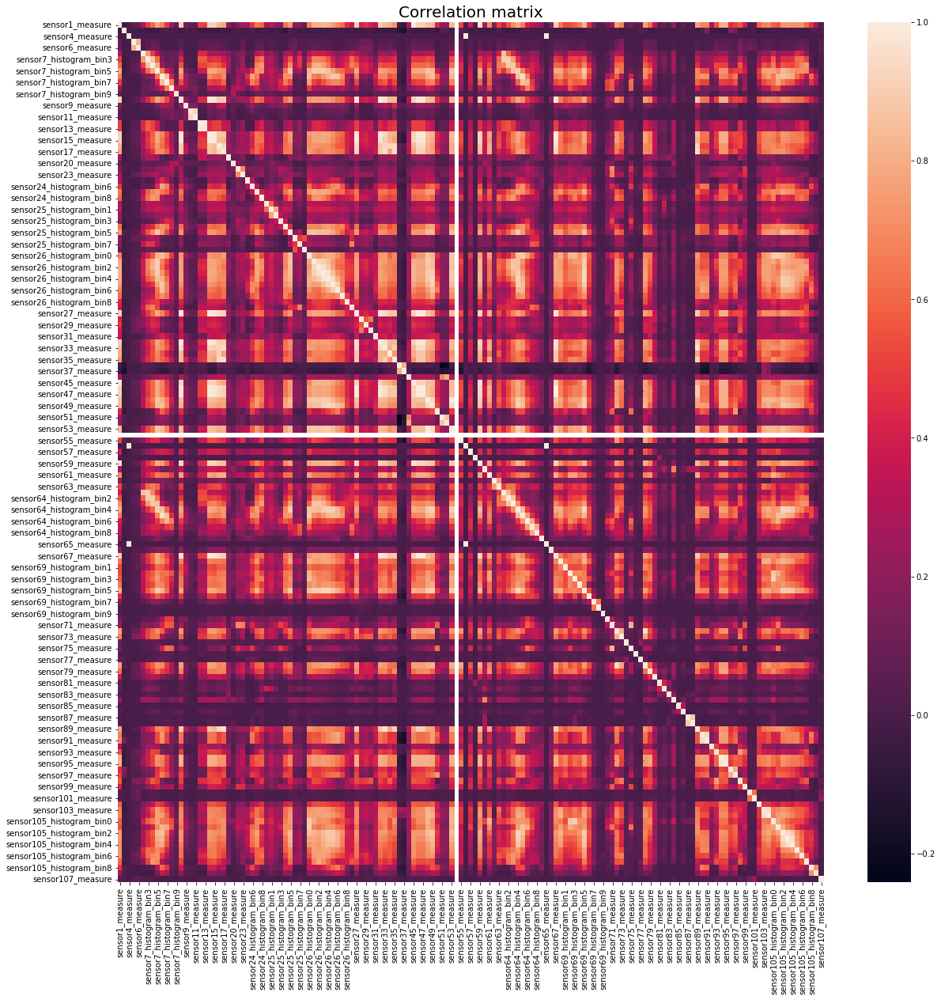

In [ ]:
col_name = data_frame.iloc[:,2:].columns
corr= data_frame[col_name].corr()
plt.figure(figsize=(20,20))

sns.heatmap(corr)
plt.title('Correlation matrix', fontsize=20)
plt.show()

### Observation:
1. Here we can find lot of correlation. 'Sensor14' and 'sensor44' has high positive correlation.
2. Again sensor37 to Sensor43 has negative correlation with almost all sensors (dark colored for negative correlation).
3. Compared to non time based sensors, time based sensors has less correlation with other sensors.

### TSNE plot for all the features

In [ ]:
data_df_copy.head()

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,na,2130706438,280,0,0,0,0,0,0,37250,1432864,3664156,1007684,25896,0,2551696,0,0,0,0,0,4933296,3655166,1766008,1132040,0,0,0,0,1012,268,0,0,0,0,0,469014,4239660,703300,755876,0,5374,2108,4114,12348,615248,5526276,2378,4,0,0,2328746,1022304,415432,287230,310246,681504,1118814,3574,0,0,6700214,0,10,108,50,2551696,97518,947550,799478,330760,353400,299160,305200,283680,na,na,na,178540,76698.08,6700214,6700214,6599892,43566,68656,54064,638360,6167850,1209600,246244,2,96,0,5245752,0,916567.68,6,1924,0,0,0,118196,1309472,3247182,1381362,98822,11208,1608,220,240,6700214,na,10476,1226,267998,521832,42

In [ ]:
for col in data_df_copy.columns:
    data_df_copy[col] = pd.to_numeric(data_df_copy[col], errors='coerce')

In [ ]:
# Using the copy of the dataset which was saved in the beginning since the other variable of dataset was modified.
data_df_copy = data_df_copy.fillna(data_df_copy.median())

y_true = data_df_copy['target']
data_df_copy = data_df_copy.drop(['target'],axis=1)
data_df_copy = data_df_copy.drop(['id'],axis=1)

In [ ]:
data_df_copy.head()

,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,76698,0.0,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,299160.0,305200.0,283680.0,288320.0,305100.0,320400.0,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064

In [ ]:
from sklearn.manifold import TSNE

TSNE with various perplexities and a standard 1000 iterations


<Figure size 1080x720 with 0 Axes>

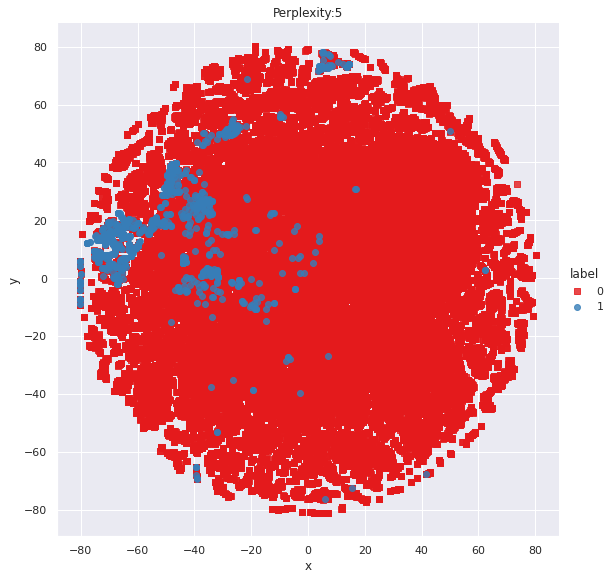

<Figure size 1080x720 with 0 Axes>

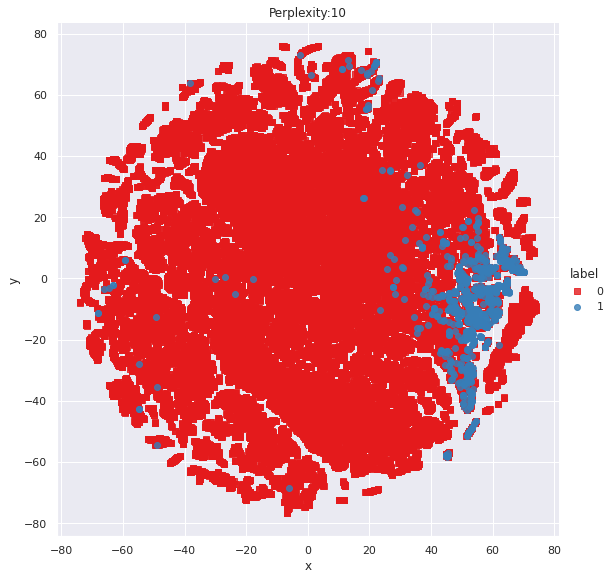

<Figure size 1080x720 with 0 Axes>

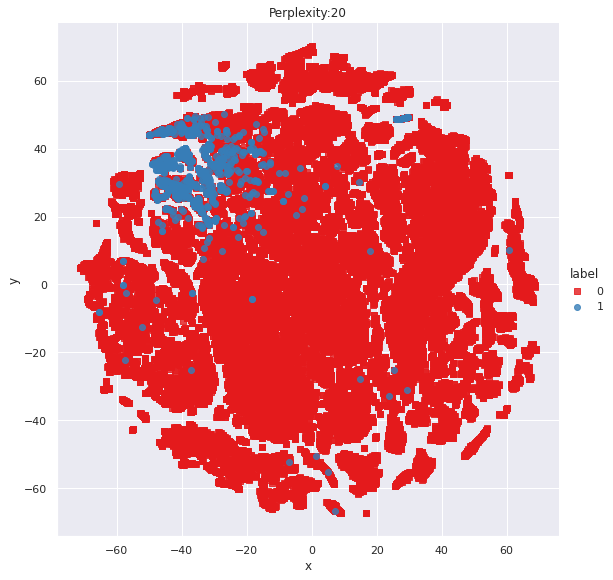

<Figure size 1080x720 with 0 Axes>

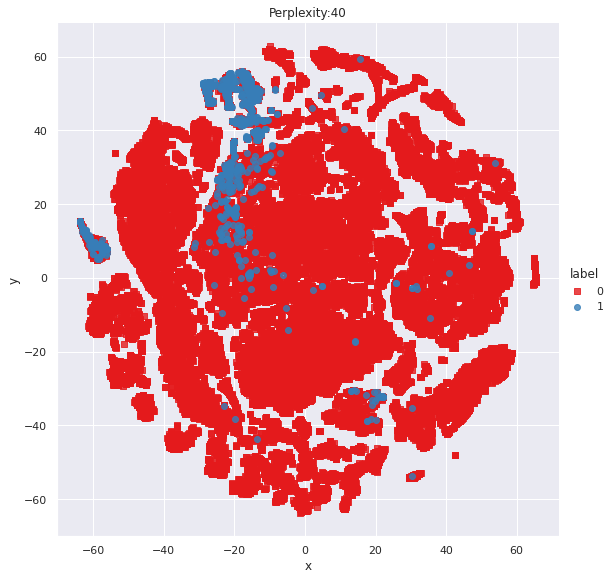

In [ ]:
# Computing TSNE for each perplexity and displaying graph using seaborn plots
perplexity = [5, 10, 20, 40]
print("TSNE with various perplexities and a standard 1000 iterations")

for ppx in perplexity:
    tsne = TSNE(n_components=2, verbose=0, perplexity=ppx, n_iter=1000)
    tsne_data = tsne.fit_transform(data_df_copy)
    plt.figure(figsize=(15,10))
    df = pd.DataFrame({'x':tsne_data[:,0], 'y':tsne_data[:,1] ,'label':y_true})
    sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8, palette="Set1", markers=['s','o'])
    plt.title("Perplexity:{}".format(ppx))
    plt.show()

### Observation:
From each of the TSNE plots we see that the data gets better grouped but the data is still overlapping on a 2D surface and thus converting the higher dimension data to a 2D data does not help in seperation.

## TSNE plot for important non time based sensors and easily seperable features

In [ ]:
important_df = data_df_copy[[ 'sensor1_measure','sensor8_measure', 'sensor14_measure', 'sensor15_measure', 'sensor16_measure', 'sensor17_measure', 'sensor27_measure', 'sensor32_measure', 'sensor33_measure', 'sensor34_measure', 'sensor35_measure', 'sensor45_measure', 'sensor46_measure', 'sensor47_measure', 'sensor59_measure', 'sensor61_measure', 'sensor67_measure', 'sensor89_measure']]

TSNE with various perplexities and a standard 1000 iterations


<Figure size 1080x720 with 0 Axes>

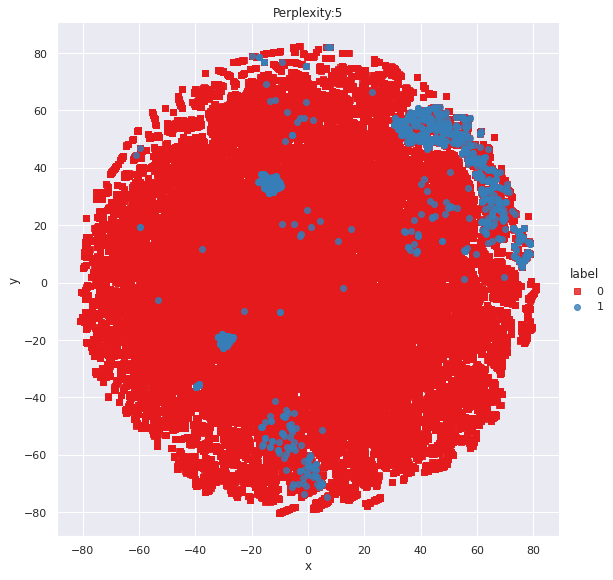

<Figure size 1080x720 with 0 Axes>

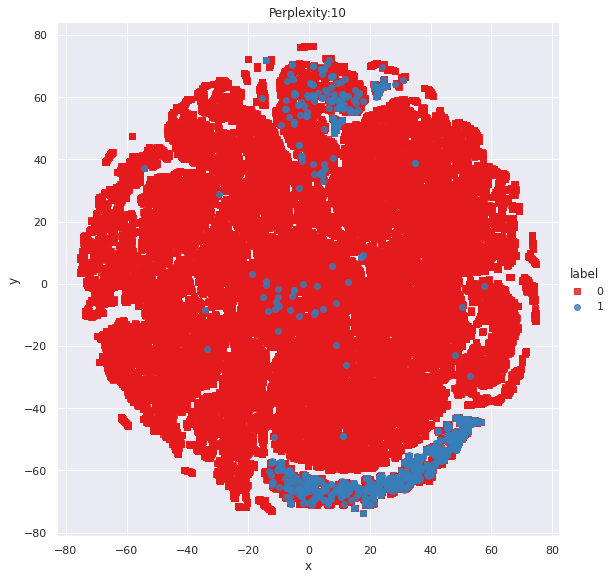

<Figure size 1080x720 with 0 Axes>

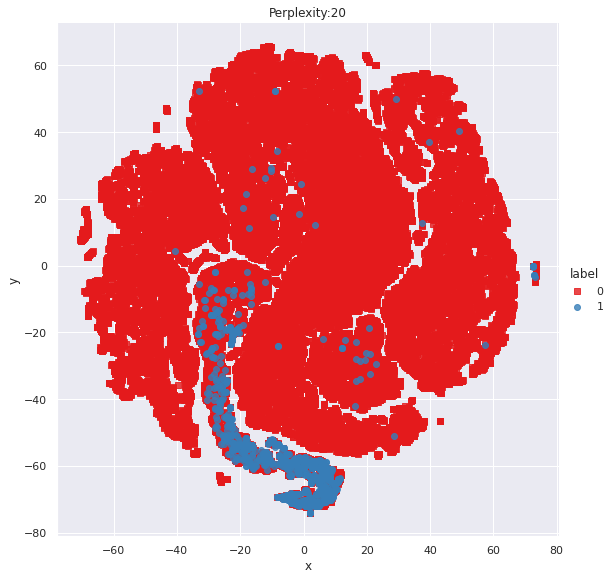

<Figure size 1080x720 with 0 Axes>

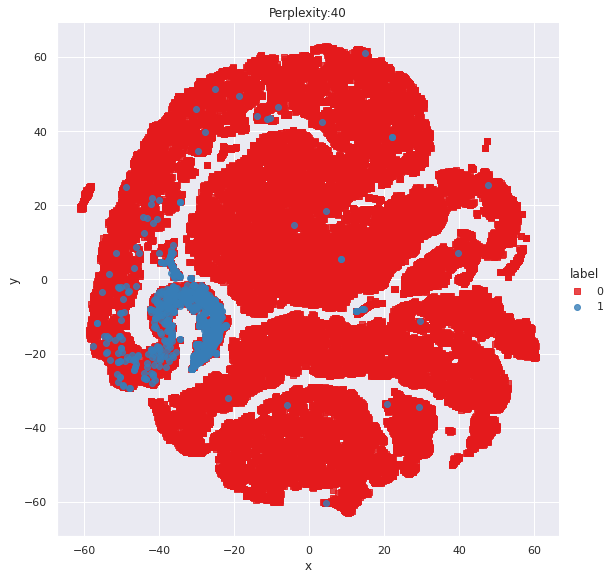

In [ ]:
# Computing TSNE for each perplexity and displaying graph using seaborn plots
perplexity = [5, 10, 20, 40]
print("TSNE with various perplexities and a standard 1000 iterations")

for ppx in perplexity:
    tsne = TSNE(n_components=2, verbose=0, perplexity=ppx, n_iter=1000)
    tsne_data = tsne.fit_transform(important_df)
    plt.figure(figsize=(15,10))
    df = pd.DataFrame({'x':tsne_data[:,0], 'y':tsne_data[:,1] ,'label':y_true})
    sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8, palette="Set1", markers=['s','o'])
    plt.title("Perplexity:{}".format(ppx))
    plt.show()

### Observation:
From each of the TSNE plots we see that the data gets better grouped but the data is still overlapping on a 2D surface and thus converting the higher dimension data to a 2D data does not help in seperation.

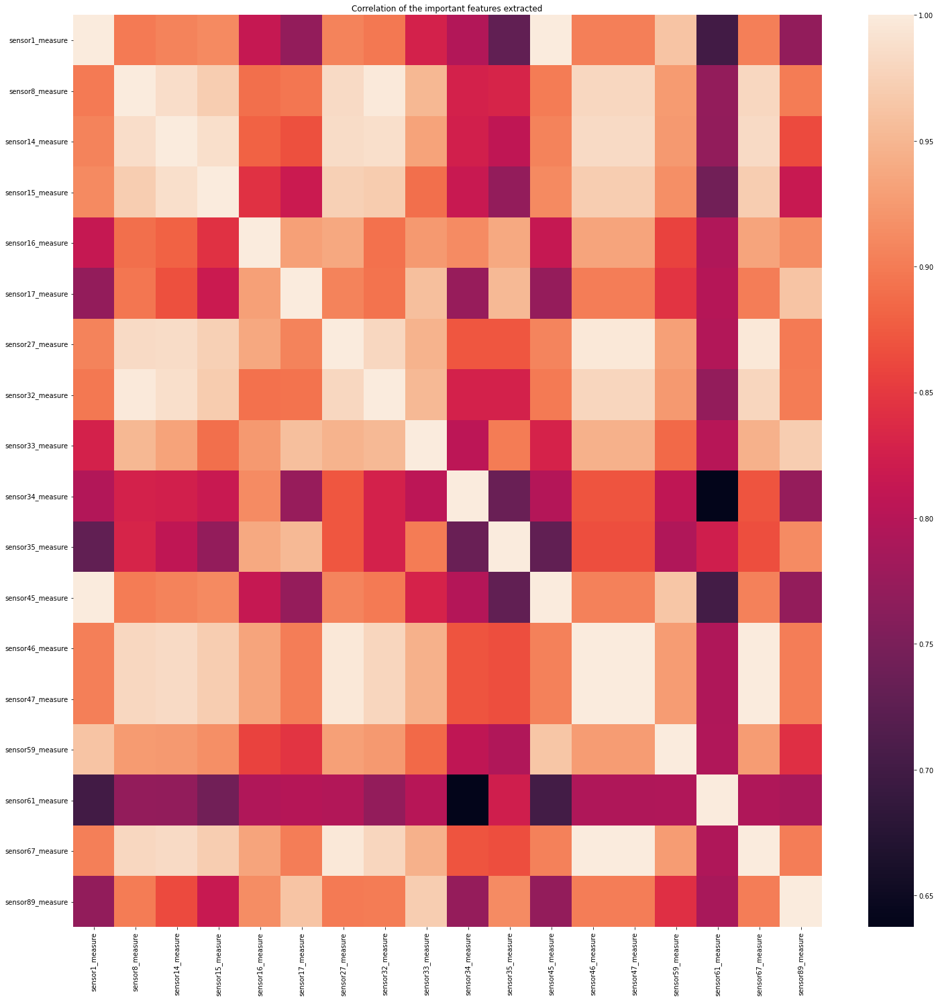

In [ ]:
# Calculating Correlation and plotting the Heat map of the correlated data
important_correlation = important_df.corr()
plt.figure(figsize=(25,25))
sns.heatmap(important_correlation)
plt.title("Correlation of the important features extracted")
plt.show()

### Observation:
We see high correlation between few sensors with a value almost above 0.99 such as

Sensor 1 and Sensor 45

Sensor 8 and Sensor 32

Sensor 27 and Sensor 46

Sensor 46 and Sensor 47

Sensor 47 and Sensor 67

**We can drop those features that are highly correlated and keep only one among them.**

In [ ]:
for i, column_1 in enumerate(important_correlation.columns):
    for j in range(i, len(important_correlation.columns)):
        column_2 = important_correlation.columns[j]
        if column_1 != column_2:
            if important_correlation[column_1][column_2] > 0.99:
                print(column_1,"--", column_2, "Correlation Value: ",important_correlation[column_1][column_2])

sensor1_measure -- sensor45_measure Correlation Value:  0.9987741087714918
sensor8_measure -- sensor32_measure Correlation Value:  0.9977448921173773
sensor27_measure -- sensor46_measure Correlation Value:  0.9962581925040408
sensor27_measure -- sensor47_measure Correlation Value:  0.9962581925084049
sensor27_measure -- sensor67_measure Correlation Value:  0.9962581924842115
sensor46_measure -- sensor47_measure Correlation Value:  0.9999999999896422
sensor46_measure -- sensor67_measure Correlation Value:  0.9999999999909166
sensor47_measure -- sensor67_measure Correlation Value:  0.9999999999987232


In [ ]:
data_df_copy.head()

,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,76698,0.0,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,299160.0,305200.0,283680.0,288320.0,305100.0,320400.0,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064

## Heatmap of the histogram data

In [ ]:
histogram_columns = dict()

for column in data_df_copy.columns:
    value = column.split("_")
    if value[1] == 'histogram':
        if value[0] not in histogram_columns:
            histogram_columns[value[0]] = []
        histogram_columns[value[0]].append(column)
print(histogram_columns)

{'sensor7': ['sensor7_histogram_bin0', 'sensor7_histogram_bin1', 'sensor7_histogram_bin2', 'sensor7_histogram_bin3', 'sensor7_histogram_bin4', 'sensor7_histogram_bin5', 'sensor7_histogram_bin6', 'sensor7_histogram_bin7', 'sensor7_histogram_bin8', 'sensor7_histogram_bin9'], 'sensor24': ['sensor24_histogram_bin0', 'sensor24_histogram_bin1', 'sensor24_histogram_bin2', 'sensor24_histogram_bin3', 'sensor24_histogram_bin4', 'sensor24_histogram_bin5', 'sensor24_histogram_bin6', 'sensor24_histogram_bin7', 'sensor24_histogram_bin8', 'sensor24_histogram_bin9'], 'sensor25': ['sensor25_histogram_bin0', 'sensor25_histogram_bin1', 'sensor25_histogram_bin2', 'sensor25_histogram_bin3', 'sensor25_histogram_bin4', 'sensor25_histogram_bin5', 'sensor25_histogram_bin6', 'sensor25_histogram_bin7', 'sensor25_histogram_bin8', 'sensor25_histogram_bin9'], 'sensor26': ['sensor26_histogram_bin0', 'sensor26_histogram_bin1', 'sensor26_histogram_bin2', 'sensor26_histogram_bin3', 'sensor26_histogram_bin4', 'sensor26_

In [ ]:
bins = []
for column, histograms in histogram_columns.items():
    bins.extend(histograms)
print(len(bins))

70


In [ ]:
histogram_data = data_df_copy[bins]
print(histogram_data.shape)

(60000, 70)


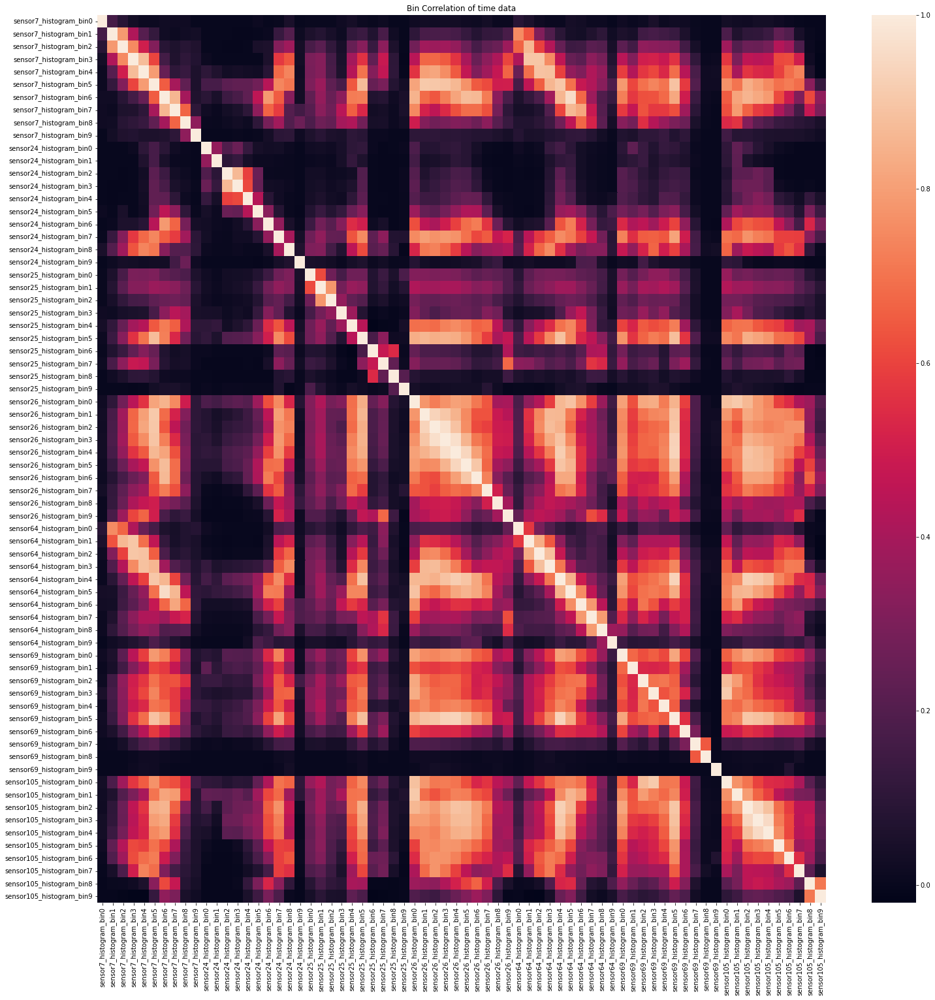

In [ ]:
# Calculating Correlation and plotting the Heat map of the correlated data
bin_correlation = histogram_data.corr()
plt.figure(figsize=(25,25))
sns.heatmap(bin_correlation)
plt.title("Bin Correlation of time data")
plt.show()

Among the various histogram bins,

1. We see a correlation between the same sensor bins as they are continuous in times.
2. We also see high correlation between bins of different sensors such as Sensor 7 bin 6 and Sensor 64 bin 5 with correlation value above 0.95

**Columns with high correlation data with some other column are as follows**

In [ ]:
for i, column_1 in enumerate(bin_correlation.columns):
    for j in range(i, len(bin_correlation.columns)):
        column_2 = bin_correlation.columns[j]
        if column_1 != column_2:
            if bin_correlation[column_1][column_2] > 0.95:
                print(column_1,"--", column_2, "Correlation Value: ",bin_correlation[column_1][column_2])

sensor7_histogram_bin6 -- sensor64_histogram_bin5 Correlation Value:  0.9567868937028841
sensor26_histogram_bin2 -- sensor26_histogram_bin3 Correlation Value:  0.9649715653248822
sensor26_histogram_bin3 -- sensor26_histogram_bin4 Correlation Value:  0.9669830664646586
sensor105_histogram_bin3 -- sensor105_histogram_bin4 Correlation Value:  0.9558991915181629


From observing the values, most bins which are next in time are the ones with high correlation since the sensor values are continution of the previous bin values like "sensor7_histogram_bin6 -- sensor64_histogram_bin5".

The other 3 are correlation between subsequent bins of the same sensor due their time based relations

In [ ]:
for i, column_1 in enumerate(bin_correlation.columns):
    for j in range(i, len(bin_correlation.columns)):
        column_1 = bin_correlation.columns[i]
        column_2 = bin_correlation.columns[j]
        if column_1 != column_2:
            sensor1 = column_1.split("_")[0]
            sensor2 = column_2.split("_")[0]
            if sensor1 !=  sensor2:
                if bin_correlation[column_1][column_2] > 0.95:
                    print(column_1,"--", column_2, "Correlation Value: ",bin_correlation[column_1][column_2])

sensor7_histogram_bin6 -- sensor64_histogram_bin5 Correlation Value:  0.9567868937028841


## Data Preprocessing

In [ ]:
y_true = data_frame['target']

In [ ]:
y_true.shape

(60000,)

In [ ]:
data_df = data_frame.drop(['id','target'],axis=1)

In [ ]:
data_df.shape

(60000, 149)

In [ ]:
data_df.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure
0,76698,2.130706e+09,280.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,1012.0,268.0,469014.0,4239660.0,703300.0,755876.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064.0,638360.0,6167850.0,1209600.0,246244.0,2.0,96.0,0.0,5245752.00,0.0,916567.68,6.0,1924.0,0.0,0.0,118196.0,1309472.0,3247182.0,1381362.0,98822.0,11208.0,1608.0,220.0,240.0,6700214.0,10476.0,1226.0,267998.0,521832.0,428776.0,4015854.0,895240.0,26330.0,118.0,0.0,532.0,734.0,4122704.0,51288.0,0.0,532572.0,0.0,18.0,5330690.0,4732.0,1126.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,62282.0,85908.0,32790.0,0.0,0.0,202710.0,37928.0,14745580.0,1876644.0,0.0,0.0,0.0,0.0,2801180.0,2445.80,2712.0,965866.0,1706908.0,1240520.0,493384.0,721044.0,

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data_df, y_true, stratify=y_true, test_size=0.2)

X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, stratify=y_train, test_size=0.2)

In [ ]:
print(X_train.shape, X_cv.shape, X_test.shape)

(38400, 149) (9600, 149) (12000, 149)


From the above correlation values we see many sensors are correlated. We will remove the ones which are above 0.99 which means it is almost same as the other sensor and keep only among them.

- sensor1_measure : sensor45_measure Correlation Value: 0.9987741087714981
- sensor8_measure : sensor32_measure Correlation Value: 0.9977448921173756
- sensor27_measure : sensor46_measure Correlation Value: 0.9962581925040437
- sensor27_measure : sensor47_measure Correlation Value: 0.9962581925084124
- sensor27_measure : sensor67_measure Correlation Value: 0.996258192484215
- sensor46_measure : sensor47_measure Correlation Value: 0.9999999999896727
- sensor46_measure : sensor67_measure Correlation Value: 0.9999999999909073
- sensor47_measure : sensor67_measure Correlation Value: 0.9999999999987332

In [ ]:
high_correlated_columns = ['sensor45_measure', 'sensor32_measure', 'sensor46_measure', 'sensor47_measure', 'sensor67_measure']
for column in high_correlated_columns:
    if column in X_train.columns:
        X_train = X_train.drop([column],axis=1)
        X_cv = X_cv.drop([column],axis=1)
        X_test = X_test.drop([column],axis=1)

**As discussed above, from the histogram bins, if there is a correlation between two different sensor bins then we should delete it. If there is correlation between the two bins of same sensor then it is due to subsequent time data.**

sensor7_histogram_bin6 : sensor64_histogram_bin5 Correlation Value: 0.9567868937028841

In [ ]:
X_train = X_train.drop(['sensor64_histogram_bin5'],axis=1)
X_cv = X_cv.drop(['sensor64_histogram_bin5'],axis=1)
X_test = X_test.drop(['sensor64_histogram_bin5'],axis=1)

After removing all the unwanted columns, we are left with 156 columns.

In [ ]:
print(X_train.shape, X_cv.shape, X_test.shape)

(38400, 143) (9600, 143) (12000, 143)


**We have already dropped columns with large amount of zeros and NaN. Now we can impute the remaining NaN values with the median imputation.**

**Median imputation is performed since median is less error prone in this scenaria where there is large flucation of sensor readings. Mean would provide a volatile value since either the values are zero or very large.**

In [ ]:
median_values = X_train.median()

X_train_median = X_train.fillna(median_values)
X_cv_median = X_cv.fillna(median_values)
X_test_median = X_test.fillna(median_values)

print(X_train_median.shape, X_cv_median.shape, X_test_median.shape)

(38400, 143) (9600, 143) (12000, 143)


In [ ]:
from joblib import dump, load

In [ ]:
dump(median_values, 'median_values.joblib')

['median_values.joblib']

In [ ]:
import pickle

In [ ]:
with open('/content/drive/MyDrive/Case Study-1/median_values.pkl', 'wb') as file:
    pickle.dump(median_values, file)

In [ ]:
column_names = X_train.columns

In [ ]:
X_train_median

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure
8622,14,6.000000e+00,6.0,0.0,0.0,0.0,0.0,1400.0,2770.0,1708.0,0.0,0.0,0.0,2196.0,0.0,170.0,0.0,294.0,634.0,14486.0,11778.0,23394.0,342.0,0.0,0.0,22.0,12.0,0.0,0.0,524.0,5354.0,166.0,28.0,40.0,250.0,826.0,414.0,4154.0,0.0,0.0,4524.0,304.0,136.0,124.0,40.0,60.0,348.0,244.0,10.0,88.0,38202.0,0.0,4.0,2.0,0.0,214.0,21176.0,2186.0,210460.0,222800.0,23100.0,39958.0,26.0,0.0,3650.0,37960.0,5938.0,1209600.0,290.0,2.0,10.0,0.0,2461.44,0.00,2448.00,4.0,20.0,0.0,670.0,2560.0,1446.0,296.0,0.0,0.0,0.0,8.0,14.0,1084.0,10.0,74.0,18.0,24.0,574.0,3158.0,878.0,58.0,0.0,6.0,12.0,2708.0,196.0,0.0,0.0,0.0,0.0,2826.0,52.0,112.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,224.0,0.0,0.0,0.0,0.0,52.0,18.0,2740.0,274.0,0.0,18.0,0.0,0.0,0.0,1.70,72.0,3644.0,1978.0,50.0,6.0,32.0,20.0,58.0,90.0,0.0,0.0,0.0
39545,61082,0.000000e+00,128.0,0.0,0.0,0.0,0.0,49954.0,1095802.0,4180912.0,1309286.0,36670.0,0.0,2927382.0,24032.0,110.0,0.0,0.0,0.0,5601502.0,4808544.0,1333284.0,641414.0,0.0,0.0,0.0,0.0,89940.0,852352.0,1157264.0,4573068.0,8440.0,4832.0,7818.0,15794.0,881902.0,5720042.0,33786.0,10.0,0.0,4295032.0,896308.0,462138.0,270642.0,209902.0,236484.0,267086.0,35032.0,0.0,0.0,6936538.

**KNN based nearest neighbour imputation so as to provide more accurate imputation over simple imputations of median, mean, most frequent.**

In [ ]:
from sklearn.impute import KNNImputer

In [ ]:
knn_imputer = KNNImputer(weights="distance")

X_train_knn_imputation = knn_imputer.fit_transform(X_train)
X_cv_knn_imputation = knn_imputer.transform(X_cv)
X_test_knn_imputation = knn_imputer.transform(X_test)

In [ ]:
print(X_train_knn_imputation.shape, X_cv_knn_imputation.shape, X_test_knn_imputation.shape)

(38400, 143) (9600, 143) (12000, 143)


In [ ]:
X_train_knn_imputation = pd.DataFrame(X_train_knn_imputation)
X_cv_knn_imputation = pd.DataFrame(X_cv_knn_imputation)
X_test_knn_imputation = pd.DataFrame(X_test_knn_imputation)

X_train_knn_imputation.columns = column_names
X_cv_knn_imputation.columns = column_names
X_test_knn_imputation.columns = column_names

## Feature Engineering

**Addition of 2 columns using Truncated SVD as part of feature engineering for median and knn imputated values.**

In [ ]:
from sklearn.decomposition import TruncatedSVD

In [ ]:
T_SVD = TruncatedSVD(n_components=4, n_iter=20)

X_train_median_tSVD = T_SVD.fit_transform(X_train_median)
X_cv_median_tSVD = T_SVD.transform(X_cv_median)
X_test_median_tSVD = T_SVD.fit_transform(X_test_median)

print(X_train_median_tSVD.shape, X_cv_median_tSVD.shape, X_test_median_tSVD.shape)

(38400, 4) (9600, 4) (12000, 4)


In [ ]:
dump(T_SVD, 'truncated_SVD.joblib') 

['truncated_SVD.joblib']

In [ ]:
with open('/content/drive/MyDrive/Case Study-1/truncated_SVD.pkl', 'wb') as file:
    pickle.dump(T_SVD, file)

In [ ]:
for i in range(4):
    X_train_median["SVD_"+str(i)] = X_train_median_tSVD[:,i]
    X_cv_median["SVD_"+str(i)] = X_cv_median_tSVD[:,i]
    X_test_median["SVD_"+str(i)] = X_test_median_tSVD[:,i]

print(X_train_median.shape, X_cv_median.shape, X_test_median.shape)

(38400, 147) (9600, 147) (12000, 147)


In [ ]:
T_SVD = TruncatedSVD(n_components=4, n_iter=20)

X_train_knn_imputation_tSVD = T_SVD.fit_transform(X_train_knn_imputation)
X_cv_knn_imputation_tSVD = T_SVD.transform(X_cv_knn_imputation)
X_test_knn_imputation_tSVD = T_SVD.fit_transform(X_test_knn_imputation)

print(X_train_knn_imputation_tSVD.shape, X_cv_knn_imputation_tSVD.shape, X_test_knn_imputation_tSVD.shape)

(38400, 4) (9600, 4) (12000, 4)


In [ ]:
for i in range(4):
    X_train_knn_imputation["SVD_"+str(i)] = X_train_knn_imputation_tSVD[:,i]
    X_cv_knn_imputation["SVD_"+str(i)] = X_cv_knn_imputation_tSVD[:,i]
    X_test_knn_imputation["SVD_"+str(i)] = X_test_knn_imputation_tSVD[:,i]

print(X_train_knn_imputation.shape, X_cv_knn_imputation.shape, X_test_knn_imputation.shape)

(38400, 147) (9600, 147) (12000, 147)


**Add bin average as a seperate column**

In [ ]:
column_names = {'sensor7': ['sensor7_histogram_bin2', 'sensor7_histogram_bin3', 'sensor7_histogram_bin4', 'sensor7_histogram_bin5', 'sensor7_histogram_bin6', 'sensor7_histogram_bin7', 'sensor7_histogram_bin8', 'sensor7_histogram_bin9'], 'sensor24': ['sensor24_histogram_bin5', 'sensor24_histogram_bin6', 'sensor24_histogram_bin7', 'sensor24_histogram_bin8'], 'sensor25': ['sensor25_histogram_bin0', 'sensor25_histogram_bin1', 'sensor25_histogram_bin2', 'sensor25_histogram_bin3', 'sensor25_histogram_bin4', 'sensor25_histogram_bin5', 'sensor25_histogram_bin6', 'sensor25_histogram_bin7', 'sensor25_histogram_bin8'], 'sensor26': ['sensor26_histogram_bin0', 'sensor26_histogram_bin1', 'sensor26_histogram_bin2', 'sensor26_histogram_bin3', 'sensor26_histogram_bin4', 'sensor26_histogram_bin5', 'sensor26_histogram_bin6', 'sensor26_histogram_bin7', 'sensor26_histogram_bin8', 'sensor26_histogram_bin9'], 'sensor64': ['sensor64_histogram_bin1', 'sensor64_histogram_bin2', 'sensor64_histogram_bin3', 'sensor64_histogram_bin4', 'sensor64_histogram_bin6', 'sensor64_histogram_bin7', 'sensor64_histogram_bin8', 'sensor64_histogram_bin9'], 'sensor69': ['sensor69_histogram_bin0', 'sensor69_histogram_bin1', 'sensor69_histogram_bin2', 'sensor69_histogram_bin3', 'sensor69_histogram_bin4', 'sensor69_histogram_bin5', 'sensor69_histogram_bin6', 'sensor69_histogram_bin7', 'sensor69_histogram_bin8', 'sensor69_histogram_bin9'], 'sensor105': ['sensor105_histogram_bin0', 'sensor105_histogram_bin1', 'sensor105_histogram_bin2', 'sensor105_histogram_bin3', 'sensor105_histogram_bin4', 'sensor105_histogram_bin5', 'sensor105_histogram_bin6', 'sensor105_histogram_bin7', 'sensor105_histogram_bin8', 'sensor105_histogram_bin9']}

In [ ]:
def add_average_bin_feature(df, column_names):
    for sensor in column_names.keys():
        bins = column_names[sensor]
        temp_df = df[bins]
        df[sensor+'_bin_average'] = temp_df.mean(axis=1)
    return df

In [ ]:
X_train_median = add_average_bin_feature(X_train_median, column_names)
X_cv_median = add_average_bin_feature(X_cv_median, column_names)
X_test_median = add_average_bin_feature(X_test_median, column_names)

In [ ]:
X_train_knn_imputation = add_average_bin_feature(X_train_knn_imputation, column_names)
X_cv_knn_imputation = add_average_bin_feature(X_cv_knn_imputation, column_names)
X_test_knn_imputation = add_average_bin_feature(X_test_knn_imputation, column_names)

In [ ]:
X_train_median.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
8622,14,6.000000e+00,6.0,0.0,0.0,0.0,0.0,1400.0,2770.0,1708.0,0.0,0.0,0.0,2196.0,0.0,170.0,0.0,294.0,634.0,14486.0,11778.0,23394.0,342.0,0.0,0.0,22.0,12.0,0.0,0.0,524.0,5354.0,166.0,28.0,40.0,250.0,826.0,414.0,4154.0,0.0,0.0,4524.0,304.0,136.0,124.0,40.0,60.0,348.0,244.0,10.0,88.0,38202.0,0.0,4.0,2.0,0.0,214.0,21176.0,2186.0,210460.0,222800.0,23100.0,39958.0,26.0,0.0,3650.0,37960.0,5938.0,1209600.0,290.0,2.0,10.0,0.0,2461.44,0.00,2448.00,4.0,20.0,0.0,670.0,2560.0,1446.0,296.0,0.0,0.0,0.0,8.0,14.0,1084.0,10.0,74.0,18.0,24.0,574.0,3158.0,878.0,58.0,0.0,6.0,12.0,2708.0,196.0,0.0,0.0,0.0,0.0,2826.0,52.0,112.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,224.0,0.0,0.0,0.0,0.0,52.0,18.0,2740.0,274.0,0.0,18.0,0.0,0.0,0.0,1.70,72.0,3644.0,1978.0,50.0,6.0,32.0,20.0,58.0,90.0,0.0,0.0,0.0,9.224711e+02,4.407512e+03,120.810091,2.573837e+04,734.75,1469.5,6.531111e+02,587.8,621.50,587.8,587.8
39545,61082,0.000000e+00,128.0,0.0,0.0,0.0,0.0,49954.0,1095802.0,4180912.0,1309286.0,36670.0,0.0,2927382.

In [ ]:
X_train_knn_imputation.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,14.0,6.000000e+00,6.000000,0.0,0.0,0.0,0.0,1400.0,2770.0,1708.0,0.0,0.0,0.0,2196.0,0.0,170.0,0.0,294.0,634.0,14486.0,11778.0,23394.0,342.0,0.0,0.0,22.0,12.0,0.0,0.0,524.0,5354.0,166.0,28.0,40.0,250.0,826.0,414.0,4154.0,0.0,0.0,4524.0,304.0,136.0,124.0,40.0,60.0,348.0,244.0,10.0,88.0,38202.0,0.0,4.0,2.0,0.0,214.0,21176.0,2186.0,1310700.0,1.310700e+06,23100.0,39958.0,26.0,0.0,3650.0,37960.0,5938.0,1209600.0,290.0,2.000000,10.000000,0.0,2461.44,0.00,2448.00,4.000000,20.000000,0.0,670.0,2560.0,1446.0,296.0,0.0,0.0,0.0,8.000000,14.0,1084.0,10.0,74.0,18.0,24.0,574.0,3158.0,878.0,58.0,0.0,6.000000,12.000000,2.708000e+03,1.960000e+02,0.000000,0.000000,0.000000,0.0,2.826000e+03,52.0,112.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,224.0,0.0,0.0,0.0,0.0,52.0,18.0,2740.0,274.0,0.0,18.0,0.0,0.0,0.0,1.700000,72.000000,3644.0,1978.0,50.0,6.0,32.0,20.0,58.0,90.0,0.0,0.0,0.0,1.331149e+03,6.035278e+03,116.643607,2.659097e+04,734.75,1469.5,6.531111e+02,587.8,621.50,587.8,587.8
1,61082.0,0.000000

**Over sampling the minority class of Train Data in order to increase the weightage the minority class and better classification.**

In [ ]:
from imblearn.over_sampling import SMOTE

In [ ]:
oversampling = SMOTE(sampling_strategy=0.1)
X_train_median_os, y_train_median_os = oversampling.fit_resample(X_train_median, y_train)

In [ ]:
oversampling = SMOTE(sampling_strategy=0.1)
X_train_knn_os, y_train_knn_os = oversampling.fit_resample(X_train_knn_imputation, y_train)

In [ ]:
columns = X_train_median.columns
X_train_median_os = pd.DataFrame(X_train_median_os)
X_train_median_os.columns = columns
y_train_median_os = pd.DataFrame(y_train_median_os)

In [ ]:
columns = X_train_median.columns

X_train_knn_os = pd.DataFrame(X_train_knn_os)
X_train_median_os = pd.DataFrame(X_train_median_os)

X_train_knn_os.columns = columns
X_train_median_os.columns = columns

y_train_knn_os = pd.DataFrame(y_train_knn_os)
y_train_median_os = pd.DataFrame(y_train_median_os)

In [ ]:
X_train_median_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,14,6.000000e+00,6.0,0.0,0.0,0.0,0.0,1400.0,2770.0,1708.0,0.0,0.0,0.0,2196.0,0.0,170.0,0.0,294.0,634.0,14486.0,11778.0,23394.0,342.0,0.0,0.0,22.0,12.0,0.0,0.0,524.0,5354.0,166.0,28.0,40.0,250.0,826.0,414.0,4154.0,0.0,0.0,4524.0,304.0,136.0,124.0,40.0,60.0,348.0,244.0,10.0,88.0,38202.0,0.0,4.0,2.0,0.0,214.0,21176.0,2186.0,210460.0,222800.0,23100.0,39958.0,26.0,0.0,3650.0,37960.0,5938.0,1209600.0,290.0,2.0,10.0,0.0,2461.44,0.00,2448.00,4.0,20.0,0.0,670.0,2560.0,1446.0,296.0,0.0,0.0,0.0,8.0,14.0,1084.0,10.0,74.0,18.0,24.0,574.0,3158.0,878.0,58.0,0.0,6.0,12.0,2708.0,196.0,0.0,0.0,0.0,0.0,2826.0,52.0,112.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,224.0,0.0,0.0,0.0,0.0,52.0,18.0,2740.0,274.0,0.0,18.0,0.0,0.0,0.0,1.70,72.0,3644.0,1978.0,50.0,6.0,32.0,20.0,58.0,90.0,0.0,0.0,0.0,9.224711e+02,4.407512e+03,120.810091,2.573837e+04,734.75,1469.5,6.531111e+02,587.8,621.50,587.8,587.8
1,61082,0.000000e+00,128.0,0.0,0.0,0.0,0.0,49954.0,1095802.0,4180912.0,1309286.0,36670.0,0.0,2927382.0,24032

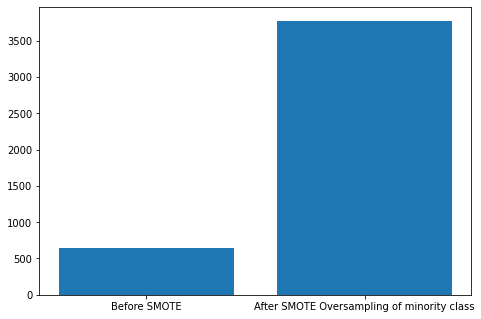

In [ ]:
targets_oversampled = y_train_median_os.value_counts()
targets_wo_oversampling = y_train.value_counts()

figure = plt.figure()
axes = figure.add_axes([0,0,1,1])
target_values = ['Before SMOTE', 'After SMOTE Oversampling of minority class']
counts = [targets_wo_oversampling[1], targets_oversampled[1]]
axes.bar(target_values,counts)
plt.show()

### Normalizing all the columns so as to make them free from various units

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
# Using the Min Max Scaler to normalise the values

mnmx_scaler = MinMaxScaler()
columns = X_train_median_os.columns

X_train_median_os = pd.DataFrame(mnmx_scaler.fit_transform(X_train_median_os))
X_cv_median = pd.DataFrame(mnmx_scaler.transform(X_cv_median))
X_test_median = pd.DataFrame(mnmx_scaler.transform(X_test_median))

X_train_median_os.columns = columns
X_cv_median.columns = columns
X_test_median.columns = columns

In [ ]:
dump(mnmx_scaler, 'mnmx_scaler.joblib') 

['mnmx_scaler.joblib']

In [ ]:
with open('/content/drive/MyDrive/Case Study-1/mnmx_scaler.pkl', 'wb') as file:
    pickle.dump(mnmx_scaler, file)

In [ ]:
X_train_median_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,0.000006,2.815967e-09,6.989506e-10,0.0,0.0,0.0,0.00000,0.000027,0.000039,0.000018,0.000000,0.000000,0.000000,0.000030,0.000000,0.00003,0.0,0.000008,0.000011,0.000103,0.000096,0.000390,0.000014,0.0,0.0,0.000061,0.000201,0.00000,0.000000,0.000005,0.000051,0.000016,0.000006,0.000003,0.000007,0.000008,0.000003,6.431422e-05,0.000000e+00,0.0,0.000050,0.000006,0.000006,0.000008,0.000003,0.000004,0.000018,0.000020,3.198364e-07,0.000005,0.000219,0.000000,0.000013,0.000002,0.000000,0.000067,0.000471,0.000050,0.160571,0.169986,0.022271,0.000244,0.000026,0.000000e+00,0.030177,0.031384,0.000043,0.0,0.000079,2.329835e-10,0.000467,0.0,0.000020,0.00000,0.000047,0.000031,0.000307,0.000000,0.000017,0.000050,0.000018,4.588739e-06,0.000000,0.000000,0.000000,9.319341e-10,0.000028,0.005855,0.000023,0.000002,4.243096e-07,3.205958e-07,0.000007,0.000043,0.000068,0.000054,0.0,0.000007,0.000031,0.000033,0.000004,0.0,0.000000e+00,0.0,0.000000,0.000034,0.000175,0.000636,0.0,0.0,0.0,0.000000,0.0,

In [ ]:
# Using the Min Max Scaler to normalise the values

mnmx_scaler = MinMaxScaler()
columns = X_train_knn_os.columns

X_train_knn_os = pd.DataFrame(mnmx_scaler.fit_transform(X_train_knn_os))
X_cv_knn_imputation = pd.DataFrame(mnmx_scaler.transform(X_cv_knn_imputation))
X_test_knn_imputation = pd.DataFrame(mnmx_scaler.transform(X_test_knn_imputation))

X_train_knn_os.columns = columns
X_cv_knn_imputation.columns = columns
X_test_knn_imputation.columns = columns

In [ ]:
X_train_knn_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,0.000006,2.815967e-09,6.989506e-10,0.0,0.0,0.0,0.00000,0.000027,0.000039,0.000018,0.000000,0.000000,0.000000,0.000030,0.000000,0.00003,0.0,0.000008,0.000011,0.000103,0.000096,0.000390,0.000014,0.0,0.0,0.000061,0.000201,0.00000,0.000000,0.000005,0.000051,0.000016,0.000006,0.000003,0.000007,0.000008,0.000003,6.431422e-05,0.000000e+00,0.0,0.000050,0.000006,0.000006,0.000008,0.000003,0.000004,0.000018,0.000020,3.198364e-07,0.000005,0.000219,0.000000,0.000013,0.000002,0.000000,0.000067,0.000471,0.000050,1.000000,1.000000,0.022271,0.000244,0.000026,0.000000e+00,0.030177,0.031384,0.000043,0.5,0.000079,2.329835e-10,0.000467,0.0,0.000020,0.00000,0.000047,0.000031,0.000307,0.000000,0.000017,0.000050,0.000018,4.588739e-06,0.000000,0.000000,0.000000,9.319341e-10,0.000028,0.005855,0.000023,0.000002,4.243096e-07,3.205958e-07,0.000007,0.000043,0.000068,0.000054,0.0,0.000007,0.000031,0.000033,0.000004,0.000000,0.000000e+00,0.000000,0.000000,0.000034,0.000175,0.000636,0.0,0.0,0.0,0.0

### Take aways from Exploratory Data Analysis and Feature Engineering:

1. There are multiple columns with majority of Null values and Zeros which have been removed.
2. Columns with Null values less than 50% were imputed with Median values or KNN based imputation and used as two different datasets.
3. Several sensors have highly distinguishable distributions namely Sensor 1, Sensor 35, Sensor 89, Sensor 8 and few more mentioned in detail above.
4. Apart from the existing features, several features were added namely 4 features from the Truncated SVD of the entire imputed dataset of both median and Knn based imputations. Also Average of the bins per row for each sensor were added as new features.
5. Post ML modelling, we can see how much contribution these features have added to each classification.

# Modelling

- Now there are 2 datasets one is median imputation and knn imputation.

## Random Model

In [ ]:
# Random predictions of 1s and 0s.
def random_model(train_shape, cv_shape, test_shape):
    train = np.random.randint(2, size=train_shape)
    cv = np.random.randint(2, size=cv_shape)
    test = np.random.randint(2, size=test_shape)
    return train, cv, test

In [ ]:
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import plot_confusion_matrix

Random Model: Train F1 score: 0.3993310061006674
Random Model: CV F1 score: 0.34912993004827897
Random Model: Test F1 score: 0.3497230598735624


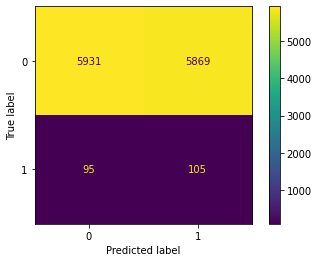

In [ ]:
y_train_pred, y_cv_pred, y_test_pred = random_model(X_train_knn_os.shape[0], X_cv_knn_imputation.shape[0], X_test_knn_imputation.shape[0])

print("Random Model: Train F1 score:",f1_score(y_train_knn_os, y_train_pred, average='macro'))
print("Random Model: CV F1 score:",f1_score(y_cv, y_cv_pred, average='macro'))
print("Random Model: Test F1 score:",f1_score(y_test, y_test_pred, average='macro'))

cm = confusion_matrix(y_test, y_test_pred, labels=[0,1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp.plot()

### Predicting All 1s

All 1s Model: Train F1 score: 0.08333333333333334
All 1s Model: CV F1 score: 0.01639344262295082
All 1s Model: Test F1 score: 0.01639344262295082


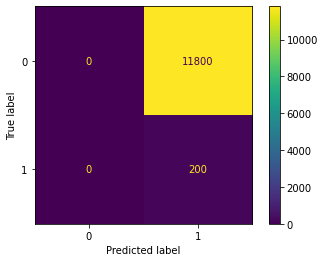

In [ ]:
# Predict all the values as 1s
def model_ones(train_shape, cv_shape, test_shape):
    train = np.ones(train_shape)
    cv = np.ones(cv_shape)
    test = np.ones(test_shape)
    return train, cv, test

y_train_pred, y_cv_pred, y_test_pred = model_ones(X_train_knn_os.shape[0], X_cv_knn_imputation.shape[0], X_test_knn_imputation.shape[0])

print("All 1s Model: Train F1 score:",f1_score(y_train_knn_os, y_train_pred, average='macro'))
print("All 1s Model: CV F1 score:",f1_score(y_cv, y_cv_pred, average='macro'))
print("All 1s Model: Test F1 score:",f1_score(y_test, y_test_pred, average='macro'))

cm = confusion_matrix(y_test, y_test_pred, labels=[0,1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp.plot()

## Observation:
Model predicting all 1s will result in a bad f1 score because the class with 1s is significantly low and hence the precision will be highly low and thus resulting in a low f1 score.

## Predicting all 0s

All 0s Model: Train F1 score: 0.47619047619047616
All 0s Model: CV F1 score: 0.49579831932773105
All 0s Model: Test F1 score: 0.49579831932773105


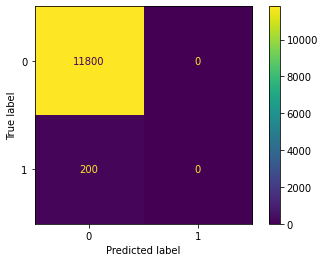

In [ ]:
# Predict all the values as Zeros
def model_zeros(train_shape, cv_shape, test_shape):
    train = np.zeros(train_shape)
    cv = np.zeros(cv_shape)
    test = np.zeros(test_shape)
    return train, cv, test

y_train_pred, y_cv_pred, y_test_pred = model_zeros(X_train_knn_os.shape[0], X_cv_knn_imputation.shape[0], X_test_knn_imputation.shape[0])

print("All 0s Model: Train F1 score:",f1_score(y_train_knn_os, y_train_pred, average='macro'))
print("All 0s Model: CV F1 score:",f1_score(y_cv, y_cv_pred, average='macro'))
print("All 0s Model: Test F1 score:",f1_score(y_test, y_test_pred, average='macro'))

cm = confusion_matrix(y_test, y_test_pred, labels=[0,1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp.plot()

### Observation:
When predicting all zeros we tend to get a f1 score of ~0.5 this is to the fact that the entire minority class is getting misclassified.

In [ ]:
X_train_knn_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,0.000006,2.815967e-09,6.989506e-10,0.0,0.0,0.0,0.00000,0.000027,0.000039,0.000018,0.000000,0.000000,0.000000,0.000030,0.000000,0.00003,0.0,0.000008,0.000011,0.000103,0.000096,0.000390,0.000014,0.0,0.0,0.000061,0.000201,0.00000,0.000000,0.000005,0.000051,0.000016,0.000006,0.000003,0.000007,0.000008,0.000003,6.431422e-05,0.000000e+00,0.0,0.000050,0.000006,0.000006,0.000008,0.000003,0.000004,0.000018,0.000020,3.198364e-07,0.000005,0.000219,0.000000,0.000013,0.000002,0.000000,0.000067,0.000471,0.000050,1.000000,1.000000,0.022271,0.000244,0.000026,0.000000e+00,0.030177,0.031384,0.000043,0.5,0.000079,2.329835e-10,0.000467,0.0,0.000020,0.00000,0.000047,0.000031,0.000307,0.000000,0.000017,0.000050,0.000018,4.588739e-06,0.000000,0.000000,0.000000,9.319341e-10,0.000028,0.005855,0.000023,0.000002,4.243096e-07,3.205958e-07,0.000007,0.000043,0.000068,0.000054,0.0,0.000007,0.000031,0.000033,0.000004,0.000000,0.000000e+00,0.000000,0.000000,0.000034,0.000175,0.000636,0.0,0.0,0.0,0.0

### Model based on percentiles of certain sensors where classes can be seperated based on percentile values

In [ ]:
sensor_names = ['sensor1_measure', 'sensor8_measure', 'sensor14_measure', 'sensor15_measure', 'sensor16_measure', 'sensor17_measure', 'sensor27_measure', 'sensor33_measure', 'sensor34_measure', 'sensor35_measure', 'sensor59_measure', 'sensor61_measure', 'sensor89_measure']

def sensor_based_prediction(X_train, X_cv, X_test, y_true, y_cv, y_test):
    train_f1_scores = []
    cv_f1_scores = []
    test_f1_scores = []
    final_test_score = dict()
    
    X_train['label'] = y_true
    
    df_0 = X_train[X_train['label']==0]
    df_1 = X_train[X_train['label']==1]
    
    df_0 = df_0[sensor_names]
    df_1 = df_1[sensor_names]
    
    quantiles_0 = df_0.quantile([0.1, 0.9], axis=0)
    quantiles_1 = df_1.quantile([0.1, 0.9], axis=0)
    
    # For each sensor column
    for sensor_name in sensor_names:
        y_train_pred = []
        y_cv_pred = []
        y_test_pred = []
        
        # If the value is less than the (90th 0 quantile + 10th 1 quantile)/2 then set the value as class 0 else it is class 1
        for value in X_train[sensor_name]:
            if value <= ((quantiles_0[sensor_name][0.9] + quantiles_1[sensor_name][0.1])/2):
                y_train_pred.append(0)
            else:
                y_train_pred.append(1)
                
        # Loop same for CV dataset
        for value in X_cv[sensor_name]:
            if value <= ((quantiles_0[sensor_name][0.9] + quantiles_1[sensor_name][0.1])/2):
                y_cv_pred.append(0)
            else:
                y_cv_pred.append(1)
        
        # Loop same for test dataset
        for value in X_test[sensor_name]:
            if value <= ((quantiles_0[sensor_name][0.9] + quantiles_1[sensor_name][0.1])/2):
                y_test_pred.append(0)
            else:
                y_test_pred.append(1)
        
        print(sensor_name, ": f1 score :", f1_score(y_true, np.array(y_train_pred), average='macro'),\
              f1_score(y_cv, np.array(y_cv_pred), average='macro'),\
              f1_score(y_test, np.array(y_test_pred), average='macro'))
        
        final_test_score[sensor_name] = f1_score(y_test, np.array(y_test_pred), average='macro')
    return final_test_score

### For KNN based imputation

In [ ]:
f1_scores_knn_os = sensor_based_prediction(X_train_knn_os, X_cv_knn_imputation, X_test_knn_imputation, y_train_knn_os, y_cv, y_test)

sensor1_measure : f1 score : 0.8368483266756338 0.6308638810561394 0.6440972793251831
sensor8_measure : f1 score : 0.8192398705340216 0.6202482789163644 0.6313186471524322
sensor14_measure : f1 score : 0.8182278657080022 0.6174335788712387 0.6296280667153544
sensor15_measure : f1 score : 0.818021155773502 0.6160985380850003 0.6260093250144328
sensor16_measure : f1 score : 0.8273571112746962 0.62411525736064 0.636401717937415
sensor17_measure : f1 score : 0.8206333364005264 0.6227779262216494 0.6354543410354982
sensor27_measure : f1 score : 0.8257742201374503 0.6247852258742296 0.6386626474106566
sensor33_measure : f1 score : 0.8242580596407115 0.6234536672315005 0.6387498770502252
sensor34_measure : f1 score : 0.7966201449140969 0.6000036716310418 0.6100250751631133
sensor35_measure : f1 score : 0.8384806859090634 0.6351770899898773 0.6509646820463232
sensor59_measure : f1 score : 0.8413120693989271 0.6372294664016083 0.6492909644148999
sensor61_measure : f1 score : 0.8394002148271972 

## Observation:
We see that Sensor 35, Sensor 61 and Sensor 89 are the top 3 f1 scores. Thus these may seem to be more important in deciding the class when a ML based Model is used

### For Median based imputation

In [ ]:
f1_scores_median_os = sensor_based_prediction(X_train_median_os, X_cv_median, X_test_median, y_train_median_os, y_cv, y_test)

sensor1_measure : f1 score : 0.8350482143921774 0.6317858035632106 0.6424972617743702
sensor8_measure : f1 score : 0.8008223392520462 0.6013789520702669 0.6100210949271723
sensor14_measure : f1 score : 0.7987659404661187 0.6015562987791272 0.6078245184559866
sensor15_measure : f1 score : 0.7952859657062896 0.5994587212694767 0.6074825234902745
sensor16_measure : f1 score : 0.8205074880374114 0.617661241350485 0.6262587650397528
sensor17_measure : f1 score : 0.8082416199585633 0.6078883635105524 0.6200384484903313
sensor27_measure : f1 score : 0.8138360544475185 0.6113395647895458 0.6227010936387757
sensor33_measure : f1 score : 0.811030677014811 0.6112577385725741 0.6224110728402894
sensor34_measure : f1 score : 0.7838053561379925 0.5908645147604114 0.5980380428280895
sensor35_measure : f1 score : 0.8312845556475132 0.6277783668410792 0.6408055579202732
sensor59_measure : f1 score : 0.8391604719218118 0.6349281646263146 0.646616946231927
sensor61_measure : f1 score : 0.8389142507811036

## Observation:
For median based imputation, we see that Sensor 61, Sensor 59, Sensor 1 and Sensor 35 are the important sensor based on the F1 scores alone.




**We can also conclude that the KNN based imputation provided a slightly better imputation, the same result can also be seen in their respective F1 score of each sensors.**

In [ ]:
X_train_median_os = X_train_median_os.drop(['label'], axis=1)
X_train_knn_os = X_train_knn_os.drop(['label'], axis=1)

In [ ]:
X_train_median_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,0.000006,2.815967e-09,6.989506e-10,0.0,0.0,0.0,0.00000,0.000027,0.000039,0.000018,0.000000,0.000000,0.000000,0.000030,0.000000,0.00003,0.0,0.000008,0.000011,0.000103,0.000096,0.000390,0.000014,0.0,0.0,0.000061,0.000201,0.00000,0.000000,0.000005,0.000051,0.000016,0.000006,0.000003,0.000007,0.000008,0.000003,6.431422e-05,0.000000e+00,0.0,0.000050,0.000006,0.000006,0.000008,0.000003,0.000004,0.000018,0.000020,3.198364e-07,0.000005,0.000219,0.000000,0.000013,0.000002,0.000000,0.000067,0.000471,0.000050,0.160571,0.169986,0.022271,0.000244,0.000026,0.000000e+00,0.030177,0.031384,0.000043,0.0,0.000079,2.329835e-10,0.000467,0.0,0.000020,0.00000,0.000047,0.000031,0.000307,0.000000,0.000017,0.000050,0.000018,4.588739e-06,0.000000,0.000000,0.000000,9.319341e-10,0.000028,0.005855,0.000023,0.000002,4.243096e-07,3.205958e-07,0.000007,0.000043,0.000068,0.000054,0.0,0.000007,0.000031,0.000033,0.000004,0.0,0.000000e+00,0.0,0.000000,0.000034,0.000175,0.000636,0.0,0.0,0.0,0.000000,0.0,

In [ ]:
X_train_knn_os.head()

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure,SVD_0,SVD_1,SVD_2,SVD_3,sensor7_bin_average,sensor24_bin_average,sensor25_bin_average,sensor26_bin_average,sensor64_bin_average,sensor69_bin_average,sensor105_bin_average
0,0.000006,2.815967e-09,6.989506e-10,0.0,0.0,0.0,0.00000,0.000027,0.000039,0.000018,0.000000,0.000000,0.000000,0.000030,0.000000,0.00003,0.0,0.000008,0.000011,0.000103,0.000096,0.000390,0.000014,0.0,0.0,0.000061,0.000201,0.00000,0.000000,0.000005,0.000051,0.000016,0.000006,0.000003,0.000007,0.000008,0.000003,6.431422e-05,0.000000e+00,0.0,0.000050,0.000006,0.000006,0.000008,0.000003,0.000004,0.000018,0.000020,3.198364e-07,0.000005,0.000219,0.000000,0.000013,0.000002,0.000000,0.000067,0.000471,0.000050,1.000000,1.000000,0.022271,0.000244,0.000026,0.000000e+00,0.030177,0.031384,0.000043,0.5,0.000079,2.329835e-10,0.000467,0.0,0.000020,0.00000,0.000047,0.000031,0.000307,0.000000,0.000017,0.000050,0.000018,4.588739e-06,0.000000,0.000000,0.000000,9.319341e-10,0.000028,0.005855,0.000023,0.000002,4.243096e-07,3.205958e-07,0.000007,0.000043,0.000068,0.000054,0.0,0.000007,0.000031,0.000033,0.000004,0.000000,0.000000e+00,0.000000,0.000000,0.000034,0.000175,0.000636,0.0,0.0,0.0,0.0

## Machine Learning Modelling

### K-Nearest Neighbour

### Median Imputed data

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
# KNN with Random Search CV for hyper parameter tuning
x_cfl=KNeighborsClassifier()

params={
     'n_neighbors':[3, 4, 10, 20, 50],
     'weights':['uniform','distance'],
    'metric':['euclidean', 'manhattan']
}
random_cfl=RandomizedSearchCV(x_cfl,param_distributions=params,n_jobs=-1,cv=3, scoring = "f1")
random_cfl.fit(X_train_median_os, y_train_median_os.values.ravel())

RandomizedSearchCV(cv=3, estimator=KNeighborsClassifier(), n_jobs=-1,
                   param_distributions={'metric': ['euclidean', 'manhattan'],
                                        'n_neighbors': [3, 4, 10, 20, 50],
                                        'weights': ['uniform', 'distance']},
                   scoring='f1')

{'weights': 'distance', 'n_neighbors': 3, 'metric': 'euclidean'} : 0.9322216735134421
{'weights': 'uniform', 'n_neighbors': 10, 'metric': 'manhattan'} : 0.9167678959249371
{'weights': 'uniform', 'n_neighbors': 50, 'metric': 'euclidean'} : 0.8369592547329004
{'weights': 'uniform', 'n_neighbors': 20, 'metric': 'manhattan'} : 0.8878749794396547
{'weights': 'distance', 'n_neighbors': 4, 'metric': 'manhattan'} : 0.9526836044455771
{'weights': 'distance', 'n_neighbors': 20, 'metric': 'euclidean'} : 0.9027066650692538
{'weights': 'distance', 'n_neighbors': 50, 'metric': 'euclidean'} : 0.8719431967177352
{'weights': 'distance', 'n_neighbors': 10, 'metric': 'euclidean'} : 0.9178052188845477
{'weights': 'distance', 'n_neighbors': 10, 'metric': 'manhattan'} : 0.94066497052584
{'weights': 'uniform', 'n_neighbors': 10, 'metric': 'euclidean'} : 0.8955885923282451


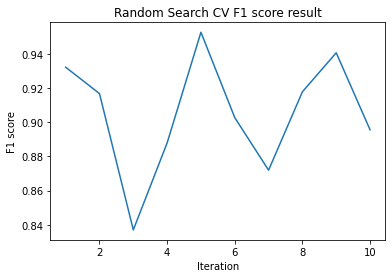

In [ ]:
# Displaying mean test score which is the mean F1 score for each hyper parameter combination

labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')

In [ ]:
x_cfl=KNeighborsClassifier(metric='manhattan', n_neighbors=3, weights='distance')
x_cfl.fit(X_train_median_os,y_train_median_os.values.ravel())

KNeighborsClassifier(metric='manhattan', n_neighbors=3, weights='distance')

In [ ]:
predict_y = x_cfl.predict(X_train_median_os)
print ("Train F1 score:",f1_score(y_train_median_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_median)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.8337140950352004


In [ ]:
predict_y = x_cfl.predict(X_test_median)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.848447474617912


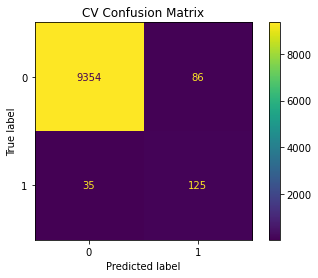

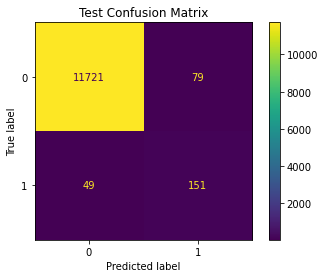

In [ ]:
plot1 = plot_confusion_matrix(x_cfl, X_cv_median, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(x_cfl, X_test_median, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

### KNN imputed data

In [ ]:
# KNN with Random Search CV for hyper parameter tuning

x_cfl=KNeighborsClassifier()

params={
     'n_neighbors':[3, 4, 10, 20, 50],
     'weights':['uniform','distance'],
    'metric':['euclidean', 'manhattan']
}
random_cfl=RandomizedSearchCV(x_cfl,param_distributions=params,n_jobs=-1,cv=3, scoring = "f1")
random_cfl.fit(X_train_knn_os, y_train_knn_os.values.ravel())

RandomizedSearchCV(cv=3, estimator=KNeighborsClassifier(), n_jobs=-1,
                   param_distributions={'metric': ['euclidean', 'manhattan'],
                                        'n_neighbors': [3, 4, 10, 20, 50],
                                        'weights': ['uniform', 'distance']},
                   scoring='f1')

{'weights': 'uniform', 'n_neighbors': 20, 'metric': 'euclidean'} : 0.86807581786685
{'weights': 'uniform', 'n_neighbors': 4, 'metric': 'euclidean'} : 0.9216369014495559
{'weights': 'distance', 'n_neighbors': 20, 'metric': 'manhattan'} : 0.9208844136201287
{'weights': 'distance', 'n_neighbors': 50, 'metric': 'euclidean'} : 0.8753361340546281
{'weights': 'uniform', 'n_neighbors': 50, 'metric': 'euclidean'} : 0.8331686961272569
{'weights': 'distance', 'n_neighbors': 10, 'metric': 'euclidean'} : 0.9160682087525469
{'weights': 'distance', 'n_neighbors': 3, 'metric': 'euclidean'} : 0.9299122389520552
{'weights': 'distance', 'n_neighbors': 4, 'metric': 'euclidean'} : 0.9319519726751762
{'weights': 'uniform', 'n_neighbors': 20, 'metric': 'manhattan'} : 0.8926546334301789
{'weights': 'distance', 'n_neighbors': 20, 'metric': 'euclidean'} : 0.9013331749314107


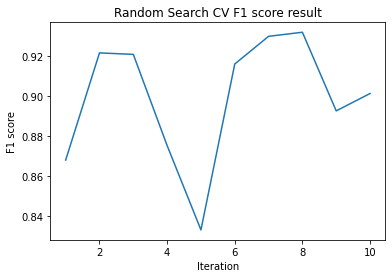

In [ ]:
# Displaying mean test score which is the mean F1 score for each hyper parameter combination

labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

KNeighborsClassifier(metric='euclidean', n_neighbors=4, weights='distance')

In [ ]:
x_cfl=KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')
x_cfl.fit(X_train_knn_os,y_train_knn_os.values.ravel())

KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')

In [ ]:
predict_y = x_cfl.predict(X_train_knn_os)
print ("Train F1 score:",f1_score(y_train_knn_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_knn_imputation)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.8437467875573099


In [ ]:
predict_y = x_cfl.predict(X_test_knn_imputation)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.8550807809868379


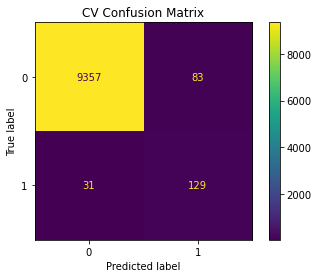

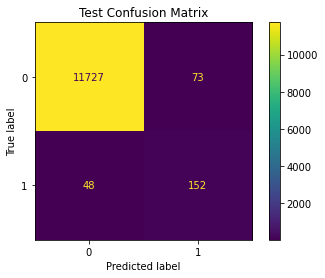

In [ ]:
plot1 = plot_confusion_matrix(x_cfl, X_cv_knn_imputation, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(x_cfl, X_test_knn_imputation, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

## Observation:
For KNN, We see that Median based imputations provided slightly better results compared to the KNN based imputation dataset.

**However for the minority class, both the median based imputation dataset provided better classification.**

## Random Forest Classifier


### Median Imputed Data

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
# Random Forest Classifier with Random Search CV for hyper parameter tuning

x_cfl=RandomForestClassifier()

params={
    'n_estimators': [100, 200, 400, 800, 1000, 1500, 2000],
    'max_depth': [5, 10, 20, 40, 100, 200], 
    'min_samples_split': [2, 5, 10],
}
random_cfl = RandomizedSearchCV(x_cfl,param_distributions=params,n_jobs=-1,cv=3, scoring = "f1")
random_cfl.fit(X_train_median_os, y_train_median_os.values.ravel())

RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
                   param_distributions={'max_depth': [5, 10, 20, 40, 100, 200],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 400, 800,
                                                         1000, 1500, 2000]},
                   scoring='f1')

{'n_estimators': 1000, 'min_samples_split': 2, 'max_depth': 40} : 0.9582542136871735
{'n_estimators': 2000, 'min_samples_split': 2, 'max_depth': 10} : 0.9444712249092206
{'n_estimators': 400, 'min_samples_split': 10, 'max_depth': 40} : 0.9525903965764329
{'n_estimators': 1000, 'min_samples_split': 2, 'max_depth': 5} : 0.8836053042830351
{'n_estimators': 1500, 'min_samples_split': 5, 'max_depth': 10} : 0.9443822935205249
{'n_estimators': 2000, 'min_samples_split': 10, 'max_depth': 10} : 0.9408239269378381
{'n_estimators': 200, 'min_samples_split': 2, 'max_depth': 10} : 0.9444883527967217
{'n_estimators': 200, 'min_samples_split': 5, 'max_depth': 5} : 0.8825379631320646
{'n_estimators': 1000, 'min_samples_split': 10, 'max_depth': 5} : 0.8836773983340486
{'n_estimators': 2000, 'min_samples_split': 5, 'max_depth': 20} : 0.9563940572385462


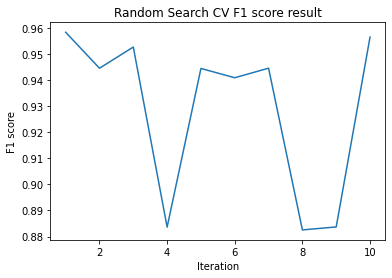

In [ ]:
# Displaying mean test score which is the mean F1 score for each hyper parameter combination

labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

RandomForestClassifier(max_depth=40, n_estimators=1000)

In [ ]:
x_cfl = RandomForestClassifier(max_depth=100, n_estimators=1500)
x_cfl.fit(X_train_median_os,y_train_median_os.values.ravel())

RandomForestClassifier(max_depth=100, n_estimators=1500)

In [ ]:
predict_y = x_cfl.predict(X_train_median_os)
print ("Train F1 score:",f1_score(y_train_median_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_median)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.8778460509113306


In [ ]:
predict_y = x_cfl.predict(X_test_median)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.892160034508789


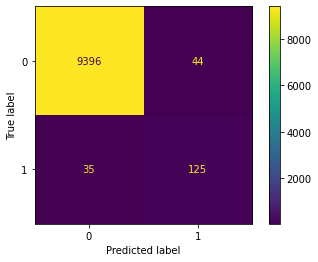

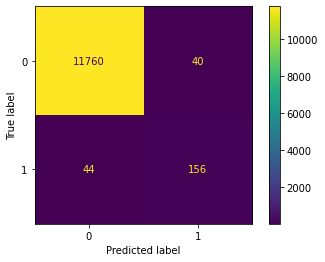

In [ ]:
plot_confusion_matrix(x_cfl, X_cv_median, y_cv) 
plot_confusion_matrix(x_cfl, X_test_median, y_test) 

### KNN Imputed data

In [ ]:
# Random Forest Classifier with Random Search CV for hyper parameter tuning

x_cfl = RandomForestClassifier()

params={
    'n_estimators': [100, 200, 400, 800, 1000, 1500, 2000],
    'max_depth': [5, 10, 20, 40, 100, 200], 
    'min_samples_split': [2, 5, 10],
}

random_cfl=RandomizedSearchCV(x_cfl,param_distributions=params,verbose=10,n_jobs=-1,cv=3)
random_cfl.fit(X_train_knn_os, y_train_knn_os.values.ravel())

Fitting 3 folds for each of 10 candidates, totalling 30 fits


RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
                   param_distributions={'max_depth': [5, 10, 20, 40, 100, 200],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 400, 800,
                                                         1000, 1500, 2000]},
                   verbose=10)

{'n_estimators': 200, 'min_samples_split': 2, 'max_depth': 20} : 0.9914291257731067
{'n_estimators': 1500, 'min_samples_split': 5, 'max_depth': 40} : 0.9911402232412216
{'n_estimators': 1000, 'min_samples_split': 5, 'max_depth': 200} : 0.9911643027993304
{'n_estimators': 800, 'min_samples_split': 2, 'max_depth': 200} : 0.9915494992197879
{'n_estimators': 100, 'min_samples_split': 5, 'max_depth': 20} : 0.990923540256342
{'n_estimators': 1000, 'min_samples_split': 10, 'max_depth': 20} : 0.9901771991519781
{'n_estimators': 800, 'min_samples_split': 5, 'max_depth': 40} : 0.9911402249800689
{'n_estimators': 2000, 'min_samples_split': 10, 'max_depth': 10} : 0.9875529689853448
{'n_estimators': 400, 'min_samples_split': 2, 'max_depth': 5} : 0.9766708275544915
{'n_estimators': 200, 'min_samples_split': 10, 'max_depth': 20} : 0.9900809035245585


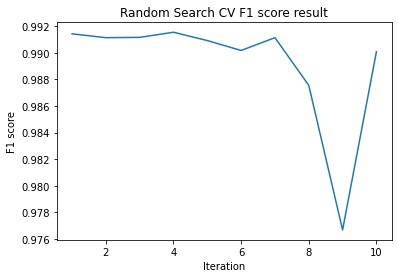

In [ ]:
labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

RandomForestClassifier(max_depth=200, n_estimators=800)

In [ ]:
x_cfl = RandomForestClassifier(max_depth=100, n_estimators=1000)
x_cfl.fit(X_train_knn_os,y_train_knn_os.values.ravel())

RandomForestClassifier(max_depth=100, n_estimators=1000)

In [ ]:
predict_y = x_cfl.predict(X_train_knn_os)
print ("Train F1 score:",f1_score(y_train_knn_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_knn_imputation)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.8728813559322034


In [ ]:
predict_y = x_cfl.predict(X_test_knn_imputation)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.8776876108965661


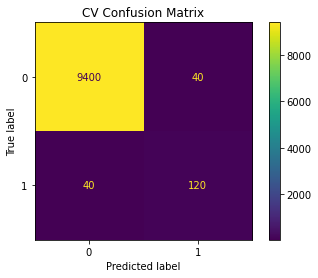

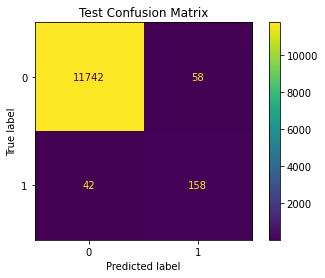

In [ ]:
plot1 = plot_confusion_matrix(x_cfl, X_cv_knn_imputation, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(x_cfl, X_test_knn_imputation, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

## Observation:
1. The RF classifier with Median based imputation provided slightly better classification over the KNN based imputation dataset.

From KNN Models, RF classifier overall performed better overall but for the minority class, KNN Model had better performance and lesser misclassification.

# XG Boost Classifier

## Median Imputed Data

In [ ]:
from xgboost import XGBClassifier

In [ ]:
# XG Boost Classifier with Random Search CV for hyper parameter tuning

x_cfl=XGBClassifier()

params={
    'learning_rate':[0.01,0.03,0.05,0.1,0.15,0.2],
     'n_estimators':[100, 500, 1000, 2000],
     'max_depth':[3,5,10],
    'colsample_bytree':[0.1,0.3,0.5,1],
    'subsample':[0.1,0.3,0.5,1]
}
random_cfl=RandomizedSearchCV(x_cfl,param_distributions=params, n_jobs=-1,cv=3)
random_cfl.fit(X_train_median_os, y_train_median_os.values.ravel())

RandomizedSearchCV(cv=3, estimator=XGBClassifier(), n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.1, 0.3, 0.5, 1],
                                        'learning_rate': [0.01, 0.03, 0.05, 0.1,
                                                          0.15, 0.2],
                                        'max_depth': [3, 5, 10],
                                        'n_estimators': [100, 500, 1000, 2000],
                                        'subsample': [0.1, 0.3, 0.5, 1]})

{'subsample': 0.1, 'n_estimators': 2000, 'max_depth': 10, 'learning_rate': 0.1, 'colsample_bytree': 0.5} : 0.9933071104719803
{'subsample': 0.3, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.05, 'colsample_bytree': 0.1} : 0.9933552226393196
{'subsample': 0.5, 'n_estimators': 2000, 'max_depth': 10, 'learning_rate': 0.1, 'colsample_bytree': 1} : 0.9941256624291132
{'subsample': 0.3, 'n_estimators': 2000, 'max_depth': 10, 'learning_rate': 0.2, 'colsample_bytree': 0.5} : 0.9936923103701326
{'subsample': 0.5, 'n_estimators': 100, 'max_depth': 10, 'learning_rate': 0.03, 'colsample_bytree': 1} : 0.9894068341326205
{'subsample': 0.1, 'n_estimators': 1000, 'max_depth': 10, 'learning_rate': 0.01, 'colsample_bytree': 1} : 0.9901050404646298
{'subsample': 1, 'n_estimators': 500, 'max_depth': 3, 'learning_rate': 0.2, 'colsample_bytree': 0.1} : 0.9933552852378241
{'subsample': 0.1, 'n_estimators': 500, 'max_depth': 3, 'learning_rate': 0.01, 'colsample_bytree': 1} : 0.9819675061247856
{'su

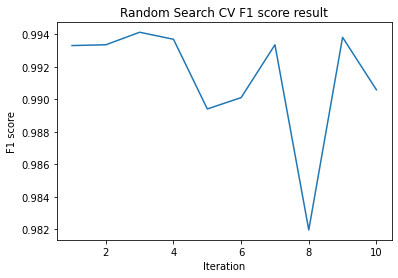

In [ ]:
# Displaying mean test score which is the mean F1 score for each hyper parameter combination

labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

XGBClassifier(max_depth=10, n_estimators=2000, subsample=0.5)

In [ ]:
from sklearn.calibration import CalibratedClassifierCV
x_cfl = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.05, max_delta_step=0, max_depth=5,
              min_child_weight=1,
              n_estimators=2000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1)
x_cfl.fit(X_train_median_os,y_train_median_os.values.ravel())

XGBClassifier(colsample_bytree=0.5, interaction_constraints='',
              learning_rate=0.05, max_depth=5, n_estimators=2000, n_jobs=0,
              num_parallel_tree=1, tree_method='exact', validate_parameters=1)

In [ ]:
predict_y = x_cfl.predict(X_train_median_os)
print ("Train F1 score:",f1_score(y_train_median_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_median)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.9039242373986344


In [ ]:
predict_y = x_cfl.predict(X_test_median)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.8988582217027781


With Calibrate classifier 
- Train F1 score: 1.0 
- CV F1 score: 0.9039 
- Test F1  score: 0.8988

Text(0.5, 1.0, 'CV Confusion Matrix')

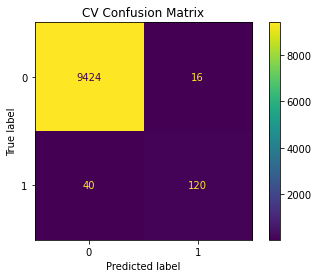

In [ ]:
plot1 = plot_confusion_matrix(x_cfl, X_cv_median, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

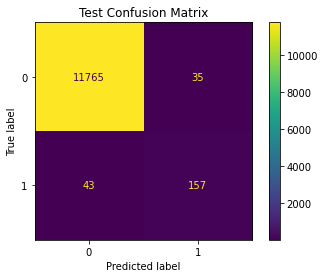

In [ ]:
plot2 = plot_confusion_matrix(x_cfl, X_test_median, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

In [ ]:
with open('/content/drive/MyDrive/Case Study-1/xgboost.pkl', 'wb') as file:
    pickle.dump(x_cfl, file)

### KNN Imputed Data

In [ ]:
# XG Boost Classifier with Random Search CV for hyper parameter tuning

x_cfl=XGBClassifier()

params={
    'learning_rate':[0.01,0.03,0.05,0.1,0.15,0.2],
     'n_estimators':[100, 500, 1000, 2000],
     'max_depth':[3,5,10],
    'colsample_bytree':[0.1,0.3,0.5,1],
    'subsample':[0.1,0.3,0.5,1]
}
random_cfl=RandomizedSearchCV(x_cfl, param_distributions=params, n_jobs=-1, cv=3)
random_cfl.fit(X_train_knn_os, y_train_knn_os.values.ravel())

RandomizedSearchCV(cv=3, estimator=XGBClassifier(), n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.1, 0.3, 0.5, 1],
                                        'learning_rate': [0.01, 0.03, 0.05, 0.1,
                                                          0.15, 0.2],
                                        'max_depth': [3, 5, 10],
                                        'n_estimators': [100, 500, 1000, 2000],
                                        'subsample': [0.1, 0.3, 0.5, 1]})

{'subsample': 0.1, 'n_estimators': 500, 'max_depth': 3, 'learning_rate': 0.01, 'colsample_bytree': 0.1} : 0.9791265616740205
{'subsample': 0.1, 'n_estimators': 100, 'max_depth': 10, 'learning_rate': 0.2, 'colsample_bytree': 0.5} : 0.9888290621069498
{'subsample': 0.5, 'n_estimators': 2000, 'max_depth': 3, 'learning_rate': 0.01, 'colsample_bytree': 0.5} : 0.9904661868873834
{'subsample': 1, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.15, 'colsample_bytree': 0.1} : 0.9870715412748196
{'subsample': 0.3, 'n_estimators': 2000, 'max_depth': 3, 'learning_rate': 0.03, 'colsample_bytree': 0.1} : 0.9927774349640227
{'subsample': 0.5, 'n_estimators': 2000, 'max_depth': 10, 'learning_rate': 0.05, 'colsample_bytree': 0.5} : 0.9941978924092028
{'subsample': 0.5, 'n_estimators': 1000, 'max_depth': 5, 'learning_rate': 0.03, 'colsample_bytree': 1} : 0.9938848998861246
{'subsample': 1, 'n_estimators': 1000, 'max_depth': 5, 'learning_rate': 0.03, 'colsample_bytree': 0.1} : 0.9934274717467301


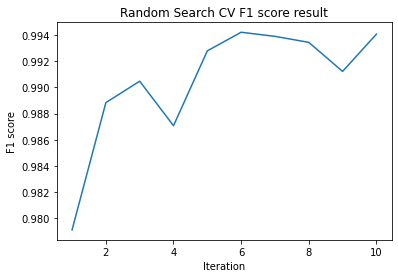

In [ ]:
# Displaying mean test score which is the mean F1 score for each hyper parameter combination

labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

XGBClassifier(colsample_bytree=0.5, learning_rate=0.05, max_depth=10,
              n_estimators=2000, subsample=0.5)

In [ ]:
x_cfl = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.2, max_delta_step=0, max_depth=10,
              min_child_weight=1,
              n_estimators=2000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.5,
              tree_method='exact', validate_parameters=1)
x_cfl.fit(X_train_knn_os,y_train_knn_os.values.ravel())

XGBClassifier(colsample_bytree=0.3, interaction_constraints='',
              learning_rate=0.2, max_depth=10, n_estimators=2000, n_jobs=0,
              num_parallel_tree=1, subsample=0.5, tree_method='exact',
              validate_parameters=1)

In [ ]:
predict_y = x_cfl.predict(X_train_knn_os)
print ("Train F1 score:",f1_score(y_train_knn_os, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_knn_imputation)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.8950801755494457


In [ ]:
predict_y = x_cfl.predict(X_test_knn_imputation)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.8957627118644068


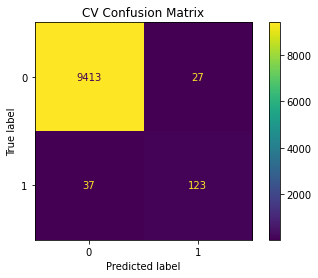

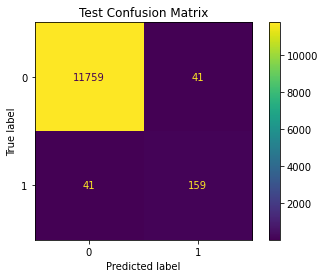

In [ ]:
plot1 = plot_confusion_matrix(x_cfl, X_cv_knn_imputation, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(x_cfl, X_test_knn_imputation, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

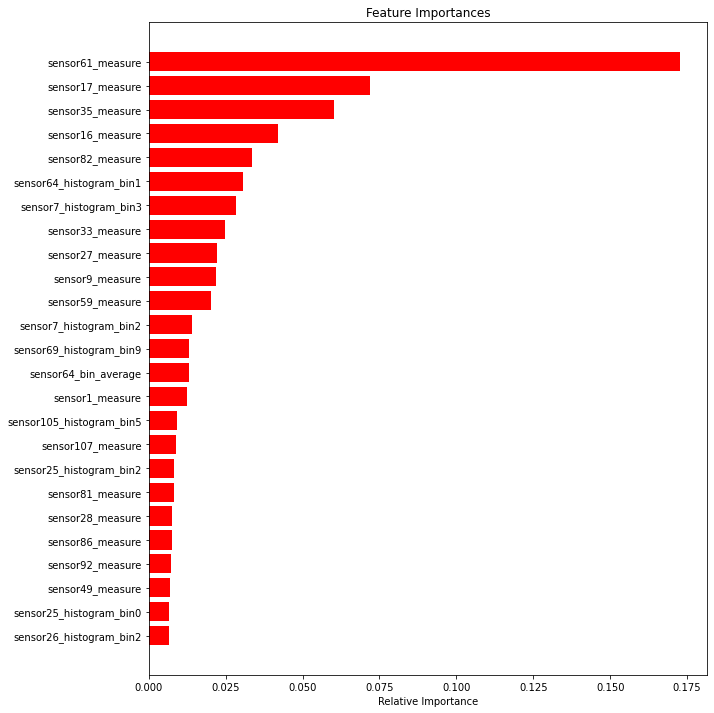

In [ ]:
# Fetching the feature importances from the classifier and plotting the top 25 feature importances
features = X_train_knn_os.columns
importances = x_cfl.feature_importances_
indices = (np.argsort(importances))[-25:]
plt.figure(figsize=(10,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='r', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

### Comments for XG Boost
- XG Boost Model provided slightly better results over the RF classifier mainly for the Majority class, whereas the classification of the minority class remains the same.

- We see that FE of Averaging Bin values has good feature importance and in the top 25 features of the 150+ features.

- We can try improving using stacking and voting classifier to see if they can classify better.

**Since XG Boost provided good results, we can try for the non oversampled dataset with XG Boost for the knn based imputation to see if dataset without oversampling can do better than oversampling.**

In [ ]:
mnmx_scaler = MinMaxScaler()
columns = X_train_knn_imputation.columns

X_train_knn_wo_os = pd.DataFrame(mnmx_scaler.fit_transform(X_train_knn_imputation))
X_cv_knn_wo_os = pd.DataFrame(mnmx_scaler.transform(X_cv_knn_imputation))
X_test_knn_wo_os = pd.DataFrame(mnmx_scaler.transform(X_test_knn_imputation))

X_train_knn_wo_os.columns = columns
X_cv_knn_wo_os.columns = columns
X_test_knn_wo_os.columns = columns

In [ ]:
x_cfl=XGBClassifier()

params={
    'learning_rate':[0.01,0.03,0.05,0.1,0.15,0.2],
     'n_estimators':[100, 500, 1000, 2000],
     'max_depth':[3,5,10],
    'colsample_bytree':[0.1,0.3,0.5,1],
    'subsample':[0.1,0.3,0.5,1]
}
random_cfl=RandomizedSearchCV(x_cfl, param_distributions=params, n_jobs=-1, cv=3)
random_cfl.fit(X_train_knn_wo_os, y_train.values.ravel())

RandomizedSearchCV(cv=3, estimator=XGBClassifier(), n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.1, 0.3, 0.5, 1],
                                        'learning_rate': [0.01, 0.03, 0.05, 0.1,
                                                          0.15, 0.2],
                                        'max_depth': [3, 5, 10],
                                        'n_estimators': [100, 500, 1000, 2000],
                                        'subsample': [0.1, 0.3, 0.5, 1]})

{'subsample': 0.3, 'n_estimators': 2000, 'max_depth': 3, 'learning_rate': 0.01, 'colsample_bytree': 1} : 0.9930208333333335
{'subsample': 0.1, 'n_estimators': 500, 'max_depth': 3, 'learning_rate': 0.01, 'colsample_bytree': 0.1} : 0.989921875
{'subsample': 0.1, 'n_estimators': 2000, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 0.5} : 0.9910677083333334
{'subsample': 0.5, 'n_estimators': 1000, 'max_depth': 5, 'learning_rate': 0.01, 'colsample_bytree': 0.5} : 0.9928906249999999
{'subsample': 1, 'n_estimators': 1000, 'max_depth': 5, 'learning_rate': 0.01, 'colsample_bytree': 0.1} : 0.9926822916666667
{'subsample': 0.3, 'n_estimators': 2000, 'max_depth': 10, 'learning_rate': 0.03, 'colsample_bytree': 0.1} : 0.9927604166666666
{'subsample': 0.3, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.2, 'colsample_bytree': 0.1} : 0.9922656249999999
{'subsample': 0.5, 'n_estimators': 100, 'max_depth': 5, 'learning_rate': 0.1, 'colsample_bytree': 0.5} : 0.9929166666666668
{'subsa

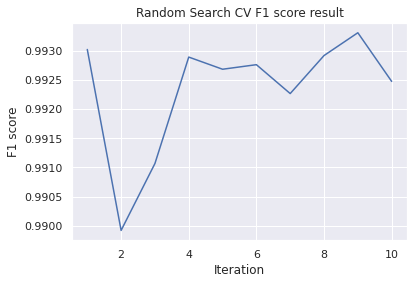

In [ ]:
labels = random_cfl.cv_results_['params']
x_axis = range(1,11)
y_axis = random_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

In [ ]:
random_cfl.best_estimator_

XGBClassifier(learning_rate=0.2, max_depth=5, n_estimators=2000, subsample=0.5)

In [ ]:
x_cfl = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.1, max_delta_step=0, max_depth=10,
              min_child_weight=1,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1)
x_cfl.fit(X_train_knn_wo_os,y_train.values.ravel())

XGBClassifier(interaction_constraints='', max_depth=10, n_estimators=1000,
              n_jobs=0, num_parallel_tree=1, tree_method='exact',
              validate_parameters=1)

In [ ]:
predict_y = x_cfl.predict(X_train_knn_wo_os)
print ("Train F1 score:",f1_score(y_train, predict_y, average='macro'))

Train F1 score: 1.0


In [ ]:
predict_y = x_cfl.predict(X_cv_knn_wo_os)
print("CV F1 score:",f1_score(y_cv, predict_y, average='macro'))

CV F1 score: 0.49579831932773105


In [ ]:
predict_y = x_cfl.predict(X_test_knn_wo_os)
print("Test F1 score:",f1_score(y_test, predict_y, average='macro'))

Test F1 score: 0.49579831932773105


### Observation
The non oversampled data provided did not give good results and the minority class has been misclassified significantly.

**Next we use the Stacking and Voting classifiers in which we use the existing RandomSearch CV best results obtained from the above 3 models of KNN, RF and XG Boost.**

## Stacking Classifier

### Median Imputed Data

In [ ]:
pip install six

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install mlrose

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import six
import sys
sys.modules['sklearn.externals.six'] = six
import mlrose

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from mlxtend.classifier import StackingClassifier

In [ ]:
# Using 3 Stacking classifiers and one meta classifier with best hyperparameters obtained from the above 
# individual classifiers hyperparameters tuning.

clf1 = RandomForestClassifier(max_depth=100, n_estimators=1500)
clf2 = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.05, max_delta_step=0, max_depth=5,
              min_child_weight=1,
              n_estimators=2000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1)
clf3 =  KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')
knn = KNeighborsClassifier(n_neighbors=5, weights='distance')

sclf = StackingClassifier(classifiers=[clf1, clf2, clf3],
                          use_probas=False,
                          average_probas=False,
                          meta_classifier=knn)

sclf.fit(X_train_median_os, y_train_median_os.values.ravel())

StackingClassifier(classifiers=[RandomForestClassifier(max_depth=100,
                                                       n_estimators=1500),
                                XGBClassifier(colsample_bytree=0.5,
                                              interaction_constraints='',
                                              learning_rate=0.05, max_depth=5,
                                              n_estimators=2000, n_jobs=0,
                                              num_parallel_tree=1,
                                              tree_method='exact',
                                              validate_parameters=1),
                                KNeighborsClassifier(metric='manhattan',
                                                     n_neighbors=4,
                                                     weights='distance')],
                   meta_classifier=KNeighborsClassifier(weights='distance'))

In [ ]:
y_train_pred = sclf.predict(X_train_median_os)
print("Train F1 score:", f1_score(y_train_median_os, y_train_pred, average='macro'))

Train F1 score: 1.0


In [ ]:
y_cv_pred = sclf.predict(X_cv_median)
print("CV F1 score:", f1_score(y_cv, y_cv_pred, average='macro'))

CV F1 score: 0.8872410642714017


In [ ]:
y_test_pred = sclf.predict(X_test_median)
print("Test F1 score:", f1_score(y_test, y_test_pred, average='macro'))

Test F1 score: 0.8932991449456673


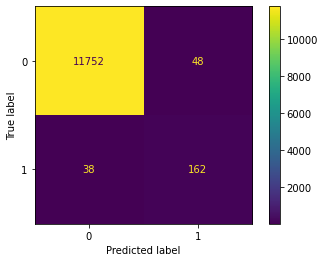

In [ ]:
cm = confusion_matrix(y_test, y_test_pred, labels=[0,1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp.plot()

## KNN imputed Data

In [ ]:
# Using 3 Stacking classifiers and one meta classifier with best hyperparameters obtained from the above 
# individual classifiers hyperparameters tuning.

clf1 = RandomForestClassifier(max_depth=100, n_estimators=1000)
clf2 = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.2, max_delta_step=0, max_depth=10,
              min_child_weight=1,
              n_estimators=2000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.5,
              tree_method='exact', validate_parameters=1)
clf3 =  KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')
knn = KNeighborsClassifier(n_neighbors=5, weights='distance')

sclf = StackingClassifier(classifiers=[clf1, clf2, clf3],
                          use_probas=False,
                          average_probas=False,
                          meta_classifier=knn)

sclf.fit(X_train_knn_os, y_train_knn_os.values.ravel())

StackingClassifier(classifiers=[RandomForestClassifier(max_depth=100,
                                                       n_estimators=1000),
                                XGBClassifier(colsample_bytree=0.3,
                                              interaction_constraints='',
                                              learning_rate=0.2, max_depth=10,
                                              n_estimators=2000, n_jobs=0,
                                              num_parallel_tree=1,
                                              subsample=0.5,
                                              tree_method='exact',
                                              validate_parameters=1),
                                KNeighborsClassifier(metric='manhattan',
                                                     n_neighbors=4,
                                                     weights='distance')],
                   meta_classifier=KNeighborsClassifier(weights='distance'))

In [ ]:
y_train_pred = sclf.predict(X_train_knn_os)
print("Train F1 score:", f1_score(y_train_knn_os, y_train_pred, average='macro'))

Train F1 score: 1.0


In [ ]:
y_cv_pred = sclf.predict(X_cv_knn_imputation)
print("CV F1 score:", f1_score(y_cv,y_cv_pred, average='macro'))

CV F1 score: 0.8760593220338984


In [ ]:
y_test_pred = sclf.predict(X_test_knn_imputation)
print("Test F1 score:", f1_score(y_test, y_test_pred, average='macro'))

Test F1 score: 0.887901479772325


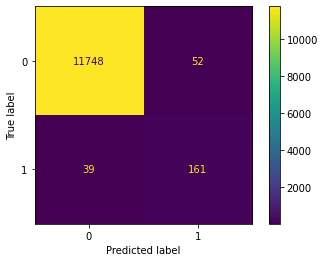

In [ ]:
cm = confusion_matrix(y_test, y_test_pred, labels=[0,1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp.plot()

- The stacking classifier of the Median and KNN based imputation improved its performance over the XG Boost and provided better classifications for the majority class and thus there is a slight increase in the F1 score.

**The Median based imputation performed marginally better over the KNN imputed dataset.**

## Voting Classifier

### Median Imputed Data

In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
# Using 3 Voting classifiers and hard voting with best hyperparameters obtained from the above 
# individual classifiers hyperparameters tuning.

rf = RandomForestClassifier(max_depth=100, n_estimators=2000)
xgb = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.1, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.1, max_delta_step=0, max_depth=10,
              min_child_weight=1,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1)
knn =  KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')

clf = VotingClassifier(estimators=[('rf', rf), ('xbg', xgb), ('knn', knn)], voting='hard',n_jobs=-1)

clf.fit(X_train_median_os, y_train_median_os.values.ravel())

VotingClassifier(estimators=[('rf',
                              RandomForestClassifier(max_depth=100,
                                                     n_estimators=2000)),
                             ('xbg',
                              XGBClassifier(colsample_bytree=0.1,
                                            interaction_constraints='',
                                            max_depth=10, n_estimators=1000,
                                            n_jobs=0, num_parallel_tree=1,
                                            tree_method='exact',
                                            validate_parameters=1)),
                             ('knn',
                              KNeighborsClassifier(metric='manhattan',
                                                   n_neighbors=4,
                                                   weights='distance'))],
                 n_jobs=-1)

In [ ]:
y_train_pred = clf.predict(X_train_median_os)
print("Train F1 score:", f1_score(y_train_median_os, y_train_pred, average='macro'))

Train F1 score: 1.0


In [ ]:
y_cv_pred = clf.predict(X_cv_median)
print("CV F1 score:", f1_score(y_cv,y_cv_pred, average='macro'))

CV F1 score: 0.8827094125696413


In [ ]:
y_test_pred = clf.predict(X_test_median)
print("Test F1 score:", f1_score(y_test, y_test_pred, average='macro'))

Test F1 score: 0.8947919867388394


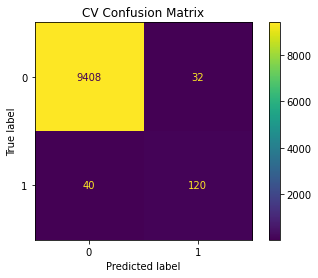

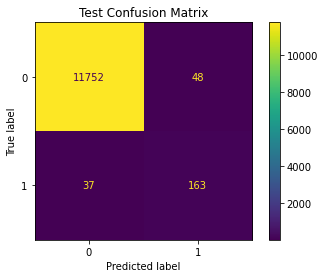

In [ ]:
plot1 = plot_confusion_matrix(clf, X_cv_median, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(clf, X_test_median, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

### KNN imputed Data

In [ ]:
# Using 3 Voting classifiers and hard voting with best hyperparameters obtained from the above 
# individual classifiers hyperparameters tuning.

rf = RandomForestClassifier(max_depth=100, n_estimators=1000)
xgb = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, gamma=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.2, max_delta_step=0, max_depth=10,
              min_child_weight=1,
              n_estimators=2000, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.5,
              tree_method='exact', validate_parameters=1)
knn =  KNeighborsClassifier(metric='manhattan', n_neighbors=4, weights='distance')

clf = VotingClassifier(estimators=[('rf', rf), ('xbg', xgb), ('knn', knn)], voting='hard',n_jobs=-1)

clf.fit(X_train_knn_os, y_train_knn_os.values.ravel())

VotingClassifier(estimators=[('rf',
                              RandomForestClassifier(max_depth=100,
                                                     n_estimators=1000)),
                             ('xbg',
                              XGBClassifier(colsample_bytree=0.3,
                                            interaction_constraints='',
                                            learning_rate=0.2, max_depth=10,
                                            n_estimators=2000, n_jobs=0,
                                            num_parallel_tree=1, subsample=0.5,
                                            tree_method='exact',
                                            validate_parameters=1)),
                             ('knn',
                              KNeighborsClassifier(metric='manhattan',
                                                   n_neighbors=4,
                                                   weights='distance'))],
                 n_jobs=-1)

In [ ]:
y_train_pred = clf.predict(X_train_knn_os)
print("Train F1 score:", f1_score(y_train_knn_os, y_train_pred, average='macro'))

Train F1 score: 1.0


In [ ]:
y_cv_pred = clf.predict(X_cv_knn_imputation)
print("CV F1 score:", f1_score(y_cv,y_cv_pred, average='macro'))

CV F1 score: 0.8772712579148167


In [ ]:
y_test_pred = clf.predict(X_test_knn_imputation)
print("Test F1 score:", f1_score(y_test, y_test_pred, average='macro'))

Test F1 score: 0.8903651835135926


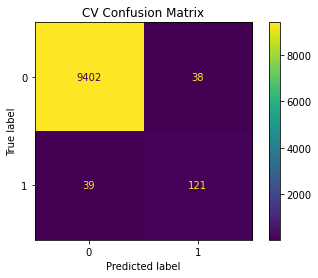

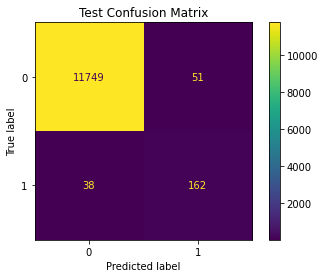

In [ ]:
plot1 = plot_confusion_matrix(clf, X_cv_knn_imputation, y_cv) 
plot1.ax_.set_title('CV Confusion Matrix')

plot2 = plot_confusion_matrix(clf, X_test_knn_imputation, y_test) 
plot2.ax_.set_title('Test Confusion Matrix')

plt.show()

**Voting Classifiers also provided similar results as the stacking classifier. The Median based imputation + Voting classifier provided the best result till now with an test F1 score of 0.898.**

## Ensemble Model

## with Decision Tree and Logistic Regression as the metaclassifier

Without feature engineering data

In [ ]:
X_train, X_ensemble_test, y_train, y_ensemble_test = train_test_split(data_df, y_true, stratify=y_true, test_size=0.2)

dataset_d1, dataset_d2, y_d1, y_d2 = train_test_split(X_train, y_train, stratify=y_train, test_size=0.5)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 149) (24000, 149) (12000, 149)


In [ ]:
high_correlated_columns = ['sensor45_measure', 'sensor32_measure', 'sensor46_measure', 'sensor47_measure', 'sensor67_measure']
for column in high_correlated_columns:
    if column in X_train.columns:
        dataset_d1 = dataset_d1.drop([column],axis=1)
        dataset_d2 = dataset_d2.drop([column],axis=1)
        X_ensemble_test = X_ensemble_test.drop([column],axis=1)
        
dataset_d1 = dataset_d1.drop(['sensor64_histogram_bin5'],axis=1)
dataset_d2 = dataset_d2.drop(['sensor64_histogram_bin5'],axis=1)
X_ensemble_test = X_ensemble_test.drop(['sensor64_histogram_bin5'],axis=1)

In [ ]:
knn_imputer = KNNImputer(weights="distance")
columns = dataset_d1.columns
dataset_d1 = knn_imputer.fit_transform(dataset_d1)
dataset_d2 = knn_imputer.transform(dataset_d2)
X_ensemble_test = knn_imputer.transform(X_ensemble_test)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 143) (24000, 143) (12000, 143)


In [ ]:
dataset_d1 = pd.DataFrame(dataset_d1)
dataset_d2 = pd.DataFrame(dataset_d2)
X_ensemble_test = pd.DataFrame(X_ensemble_test)

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [ ]:
dataset_d1

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure
0,57422.0,1.151612e+09,262.626828,0.0,0.0,0.0,29396.0,1705666.0,1352934.0,337592.0,3232.0,0.0,0.0,1669066.0,0.0,32.0,0.0,65194.0,109608.0,3048140.0,2748954.0,610036.0,239156.0,0.0,0.0,1064.0,500.0,58158.0,443236.0,2067412.0,858388.0,8824.0,2392.0,2808.0,4290.0,19840.0,3331628.0,54842.0,4196.0,0.0,1369180.0,674190.0,356166.0,219616.0,148364.0,117940.0,98798.0,120448.0,84584.0,239534.0,3724662.0,128.108407,986.303126,1860.0,330.0,46620.0,284718.0,323312.0,1.822200e+05,2.065000e+05,9960.0,3.735255e+06,19483.0,38109.943566,46053.340688,81540.0,3.275133e+06,1209600.0,85012.0,1.829695,55.860339,0.0,3.424991e+06,0.00,360817.330872,30.0,704.0,532.0,254320.0,471176.0,555484.0,562120.0,505754.0,320156.0,197002.0,245.661389,6.065642,6508.0,912.0,104472.0,142704.0,104196.0,2222958.0,808894.0,37750.0,424.0,2.0,310.000000,1630.000000,2.148040e+06,819820.000000,2740.000000,54670.000000,0.0,0.000000,2.706500e+06,3526.0,131.929833,0.0,0.0,3463.306347,33016.243356,0.0,0.0,0.0,0.0,27900.0,10703.895774,2376.019716,4.013133e+06,592543.677107,62907.305695,9646.492625,1.883115e+06,2.548044e+05,5.844599e+05,16214.172471,0.0,0.0,1.387541e+07,1851.658266,1970.0,

In [ ]:
dataset_d2

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor20_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor107_measure
0,18.0,2.000000e+00,2.00000,0.0,0.0,0.0,0.0,678.0,10946.0,4930.0,0.0,0.0,0.0,8660.0,0.0,0.0,0.0,0.0,0.0,32122.0,27714.0,11958.0,998.0,0.0,0.0,0.0,0.0,0.0,0.0,11526.0,5028.0,150.0,28.0,364.0,638.0,116.0,15258.0,0.0,0.0,0.0,14430.0,754.0,204.0,158.0,134.0,128.0,64.0,386.0,96.0,200.0,44154.0,0.0,12.0,0.0,0.0,374.0,7910.0,4012.0,1.310700e+06,1.310700e+06,11660.0,4.389400e+04,44.0,84.0,4134.000000,43680.0,1.668000e+04,1209600.0,698.0,2.00000,4.000000,0.0,3776.64,3832.32,8069.76,0.000000,18.000000,0.0,114.0,7448.0,6980.0,992.0,154.0,0.0,0.0,4.000000,4.0,1116.0,40.0,22.0,46.0,694.0,4308.0,8866.0,1302.0,160.0,0.0,2.000000,0.000000,4.490000e+03,1.580000e+02,0.000000,0.000000,0.0,0.000000,5.026000e+03,212.0,134.0,0.0,0.0,260.000000,3894.000000,0.0,0.0,0.0,0.0,380.0,0.0,0.0,1304.0,290.0,146.0,30.0,3600.0,1206.0,14304.0,20.0,0.0,0.0,0.000000e+00,1.580000,100.000000,13182.0,3034.0,96.0,26.0,70.0,48.0,58.0,40.0,0.0,0.0,0.0
1,116258.0,3.440000e+02,236.00000,0.0,0.0,0.0,0.0,160080.0,4298562.0,1993206.0,112494.0,4826.0,0.0,3510324.0,202022.0,0.0,0.0,1208.0,2194.0,5987632.0,5444544.0,868214.0,425420.0,0.0,0.0,158.0,74.0,3874.0,25072.0,1103516.0,5436706.0

In [ ]:
mnmx_scaler = MinMaxScaler()
columns = dataset_d1.columns

dataset_d1 = pd.DataFrame(mnmx_scaler.fit_transform(dataset_d1))
dataset_d2 = pd.DataFrame(mnmx_scaler.transform(dataset_d2))
X_ensemble_test = pd.DataFrame(mnmx_scaler.transform(X_ensemble_test))

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [ ]:
import random

In [ ]:
# Generate samples of dataset with 60% sample and 40% sample with replacement.

def generate_samples(input_data, target_data):
    selected_rows = random.sample(range(0,len(input_data)-1), int(0.6*(len(input_data))))
    sampled_input_data = input_data.iloc[selected_rows]
    sampled_target_data = target_data.iloc[selected_rows]
    
    sampled_input_data = sampled_input_data.values.tolist()
    sampled_target_data = sampled_target_data.values.tolist()
    
    r_row_replication = random.sample(range(0,len(sampled_input_data)-1), int(0.4*(len(input_data))))
    for every_number in r_row_replication:
        sampled_input_data.append(sampled_input_data[every_number])
        sampled_target_data.append(sampled_target_data[every_number])
        
    return sampled_input_data, sampled_target_data

In [204]:
# Pass the train dataset to generate samples, predict intermediate output so as to use it for the metaclassifiers.

def ensemble_model_DT(num_of_models, dataset_d1, y_d1, dataset_d2, y_d2):
    list_input_data = []
    list_output_data = []
    model_list = []
    output_list = []
    final_df = []
    
    # Generate samples of dataset with 60% sample and 40% sample with replacement.
    for i in range(num_of_models):
        in_data,target_data = generate_samples(dataset_d1, y_d1)
        list_input_data.append(in_data)
        list_output_data.append(target_data)
    print("Generating Samples Done")
    
    # Fit DT models on the generated samples
    for i in range(num_of_models):
        dtr = DecisionTreeRegressor(max_depth=None)
        model = dtr.fit(list_input_data[i], list_output_data[i])
        model_list.append(model) 
    print("Fitting Base Models Done")
    
    # predict values for the second dataset and use it as features for the next meta_data model
    for i in range(num_of_models):
        model = model_list[i]
        output = model.predict(dataset_d2)
        output_list.append(output)
    print("Predict on Dataset 2 Done")
        
    # Zip each row of the columns to form a dataset
    for i in range(len(output_list[0])):
        output = []
        for j in range(num_of_models):
            output.append(output_list[j][i])
        final_df.append(output)
    print("Formed Meta Dataset Done")
    
    final_df = pd.DataFrame(final_df)

    
    return model_list, final_df 

In [205]:
from sklearn.tree import DecisionTreeRegressor

In [206]:
# Number of models here is a hyper parameter and has been tried with mutiple values and the results are below
num_of_models = 75
model_list, df = ensemble_model_DT(num_of_models, dataset_d1, y_d1, dataset_d2, y_d2)

Generating Samples Done
Fitting Base Models Done
Predict on Dataset 2 Done
Formed Meta Dataset Done


In [207]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

In [208]:
# Logistic Regression as the meta classifier and it is hyper paramterized with the GridSearch CV
x_cfl = LogisticRegression()

params={
    'C':[10 ** x for x in range(-5, 4)]
}
grid_cfl=GridSearchCV(x_cfl, param_grid=params, n_jobs=-1, scoring='f1')
grid_cfl.fit(df, y_d2.values.ravel())

GridSearchCV(estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,
                               1000]},
             scoring='f1')

{'C': 1e-05} : 0.0
{'C': 0.0001} : 0.0
{'C': 0.001} : 0.5390762793554179
{'C': 0.01} : 0.7318115967608345
{'C': 0.1} : 0.7476235035809504
{'C': 1} : 0.7450961093884757
{'C': 10} : 0.7367598368128137
{'C': 100} : 0.7357039084011806
{'C': 1000} : 0.7357039084011806
BEST MODEL --  LogisticRegression(C=0.1)


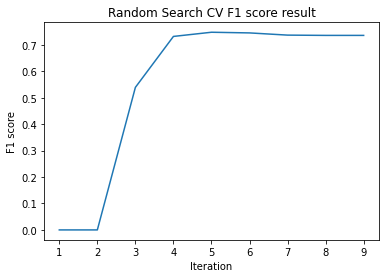

In [209]:
# plotting the various mean f1 scores
labels = grid_cfl.cv_results_['params']
x_axis = range(1,10)
y_axis = grid_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

print("BEST MODEL -- ", grid_cfl.best_estimator_)

In [210]:
x_cfl = LogisticRegression(C=0.1)
x_cfl.fit(df,y_d2.values.ravel())

LogisticRegression(C=0.1)

In [211]:
# Predicting the intermediation output for the test dataset before giving it to the meta classifier
def test_dataset(num_of_models, model_list, X_ensemble_test):
    test_output_list = []
    test_df = []
    
    # Predict output for the test set
    for i in range(num_of_models):
        model = model_list[i]
        output = model.predict(X_ensemble_test)
        test_output_list.append(output)
    
    # Zip the output of the test set two form a dataset
    for i in range(len(test_output_list[0])):
        output = []
        for j in range(num_of_models):
            output.append(test_output_list[j][i])
        test_df.append(output)   
    test_df = pd.DataFrame(test_df)
    return test_df

Test F1 score: 0.8581800676958684


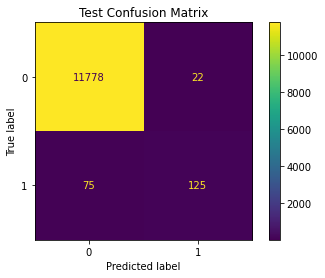

In [212]:
test_df = test_dataset(num_of_models, model_list, X_ensemble_test)
y_test_pred = x_cfl.predict(test_df)
print("Test F1 score:", f1_score(y_ensemble_test, y_test_pred, average='macro'))

plot1 = plot_confusion_matrix(x_cfl, test_df, y_ensemble_test) 
plot1.ax_.set_title('Test Confusion Matrix')

plt.show()

## Results

- 10 DT Models - 0.843355893965031
- 20 DT Models - 0.8431305921677959
- 50 DT Models - 0.8531384259778475
- 75 DT Models - 0.8581800676958684

### Median Imputed Data without FE

In [213]:
X_train, X_ensemble_test, y_train, y_ensemble_test = train_test_split(data_df, y_true, stratify=y_true, test_size=0.2)

dataset_d1, dataset_d2, y_d1, y_d2 = train_test_split(X_train, y_train, stratify=y_train, test_size=0.5)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 149) (24000, 149) (12000, 149)


In [214]:
high_correlated_columns = ['sensor45_measure', 'sensor32_measure', 'sensor46_measure', 'sensor47_measure', 'sensor67_measure']
for column in high_correlated_columns:
    if column in X_train.columns:
        dataset_d1 = dataset_d1.drop([column],axis=1)
        dataset_d2 = dataset_d2.drop([column],axis=1)
        X_ensemble_test = X_ensemble_test.drop([column],axis=1)
        
dataset_d1 = dataset_d1.drop(['sensor64_histogram_bin5'],axis=1)
dataset_d2 = dataset_d2.drop(['sensor64_histogram_bin5'],axis=1)
X_ensemble_test = X_ensemble_test.drop(['sensor64_histogram_bin5'],axis=1)

In [215]:
median_values = dataset_d1.median()
columns = dataset_d1.columns
dataset_d1 = dataset_d1.fillna(median_values)
dataset_d2 = dataset_d2.fillna(median_values)
X_ensemble_test = X_ensemble_test.fillna(median_values)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 143) (24000, 143) (12000, 143)


In [216]:
dataset_d1 = pd.DataFrame(dataset_d1)
dataset_d2 = pd.DataFrame(dataset_d2)
X_ensemble_test = pd.DataFrame(X_ensemble_test)

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [217]:
mnmx_scaler = MinMaxScaler()
columns = dataset_d1.columns

dataset_d1 = pd.DataFrame(mnmx_scaler.fit_transform(dataset_d1))
dataset_d2 = pd.DataFrame(mnmx_scaler.transform(dataset_d2))
X_ensemble_test = pd.DataFrame(mnmx_scaler.transform(X_ensemble_test))

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [218]:
# Number of models here is a hyper parameter and has been tried with mutiple values and the results are below
num_of_models = 75
model_list, df = ensemble_model_DT(num_of_models, dataset_d1, y_d1, dataset_d2, y_d2)

Generating Samples Done
Fitting Base Models Done
Predict on Dataset 2 Done
Formed Meta Dataset Done


In [219]:
# Logistic Regression as the meta classifier and it is hyper paramterized with the GridSearch CV

x_cfl = LogisticRegression()

params={
    'C':[10 ** x for x in range(-5, 4)]
}
grid_cfl=GridSearchCV(x_cfl, param_grid=params, n_jobs=-1, scoring='f1')
grid_cfl.fit(df, y_d2.values.ravel())

GridSearchCV(estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,
                               1000]},
             scoring='f1')

{'C': 1e-05} : 0.0
{'C': 0.0001} : 0.0
{'C': 0.001} : 0.6006120896282271
{'C': 0.01} : 0.7355148965683099
{'C': 0.1} : 0.7390802794006406
{'C': 1} : 0.7297505735018242
{'C': 10} : 0.7212277304657881
{'C': 100} : 0.7185840101806488
{'C': 1000} : 0.7175863682434096
BEST MODEL --  LogisticRegression(C=0.1)


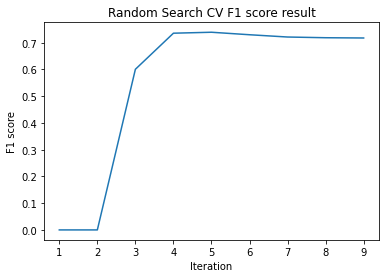

In [220]:
# plotting the various mean f1 scores

labels = grid_cfl.cv_results_['params']
x_axis = range(1,10)
y_axis = grid_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

print("BEST MODEL -- ", grid_cfl.best_estimator_)

In [221]:
x_cfl = LogisticRegression(C=0.1)
x_cfl.fit(df,y_d2.values.ravel())

LogisticRegression(C=0.1)

Test F1 score: 0.8822011004847985


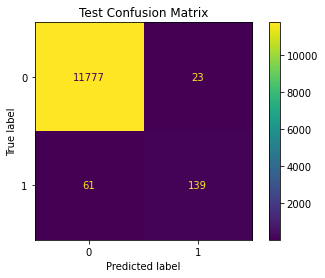

In [222]:
test_df = test_dataset(num_of_models, model_list, X_ensemble_test)
y_test_pred = x_cfl.predict(test_df)
print("Test F1 score:", f1_score(y_ensemble_test, y_test_pred, average='macro'))

plot1 = plot_confusion_matrix(x_cfl, test_df, y_ensemble_test) 
plot1.ax_.set_title('Test Confusion Matrix')

plt.show()

## Observation:
- 10 DT Models - 0.8399217860838921
- 20 DT Models - 0.8584360327484646
- 50 DT Models - 0.8778061312810195
- 75 DT Models - 0.8822974055227447


1. From both the ensemble models we see that they are not very close to the Voting Classifiers when Feature Engineering has not been applied. 
2. This shows that our Feature Engineering has contributed to the final results and improving the F1 score.

## Ensemble model

### with feature engineered data for KNN imputed dataset

In [223]:
X_train, X_ensemble_test, y_train, y_ensemble_test = train_test_split(data_df, y_true, stratify=y_true, test_size=0.2)

dataset_d1, dataset_d2, y_d1, y_d2 = train_test_split(X_train, y_train, stratify=y_train, test_size=0.5)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 149) (24000, 149) (12000, 149)


In [224]:
high_correlated_columns = ['sensor45_measure', 'sensor32_measure', 'sensor46_measure', 'sensor47_measure', 'sensor67_measure']
for column in high_correlated_columns:
    if column in X_train.columns:
        dataset_d1 = dataset_d1.drop([column],axis=1)
        dataset_d2 = dataset_d2.drop([column],axis=1)
        X_ensemble_test = X_ensemble_test.drop([column],axis=1)
        
dataset_d1 = dataset_d1.drop(['sensor64_histogram_bin5'],axis=1)
dataset_d2 = dataset_d2.drop(['sensor64_histogram_bin5'],axis=1)
X_ensemble_test = X_ensemble_test.drop(['sensor64_histogram_bin5'],axis=1)

In [225]:
knn_imputer = KNNImputer(weights="distance")
columns = dataset_d1.columns
dataset_d1 = knn_imputer.fit_transform(dataset_d1)
dataset_d2 = knn_imputer.transform(dataset_d2)
X_ensemble_test = knn_imputer.transform(X_ensemble_test)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 143) (24000, 143) (12000, 143)


In [226]:
dataset_d1 = pd.DataFrame(dataset_d1)
dataset_d2 = pd.DataFrame(dataset_d2)
X_ensemble_test = pd.DataFrame(X_ensemble_test)

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [227]:
T_SVD = TruncatedSVD(n_components=4, n_iter=20)

dataset1_tSVD = T_SVD.fit_transform(dataset_d1)
dataset2_tSVD = T_SVD.transform(dataset_d2)
X_test_tSVD = T_SVD.fit_transform(X_ensemble_test)

print(dataset1_tSVD.shape, dataset2_tSVD.shape, X_test_tSVD.shape)

(24000, 4) (24000, 4) (12000, 4)


In [228]:
for i in range(4):
    dataset_d1["SVD_"+str(i)] = dataset1_tSVD[:,i]
    dataset_d2["SVD_"+str(i)] = dataset2_tSVD[:,i]
    X_ensemble_test["SVD_"+str(i)] = X_test_tSVD[:,i]

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 147) (24000, 147) (12000, 147)


In [229]:
column_names = dict()

for column in dataset_d1.columns:
    value = column.split("_")
    if value[1] == 'histogram':
        if value[0] not in column_names:
            column_names[value[0]] = []
        column_names[value[0]].append(column)
        
print(column_names)

{'sensor7': ['sensor7_histogram_bin2', 'sensor7_histogram_bin3', 'sensor7_histogram_bin4', 'sensor7_histogram_bin5', 'sensor7_histogram_bin6', 'sensor7_histogram_bin7', 'sensor7_histogram_bin8', 'sensor7_histogram_bin9'], 'sensor24': ['sensor24_histogram_bin5', 'sensor24_histogram_bin6', 'sensor24_histogram_bin7', 'sensor24_histogram_bin8'], 'sensor25': ['sensor25_histogram_bin0', 'sensor25_histogram_bin1', 'sensor25_histogram_bin2', 'sensor25_histogram_bin3', 'sensor25_histogram_bin4', 'sensor25_histogram_bin5', 'sensor25_histogram_bin6', 'sensor25_histogram_bin7', 'sensor25_histogram_bin8'], 'sensor26': ['sensor26_histogram_bin0', 'sensor26_histogram_bin1', 'sensor26_histogram_bin2', 'sensor26_histogram_bin3', 'sensor26_histogram_bin4', 'sensor26_histogram_bin5', 'sensor26_histogram_bin6', 'sensor26_histogram_bin7', 'sensor26_histogram_bin8', 'sensor26_histogram_bin9'], 'sensor64': ['sensor64_histogram_bin1', 'sensor64_histogram_bin2', 'sensor64_histogram_bin3', 'sensor64_histogram_b

In [230]:
dataset_d1 = add_average_bin_feature(dataset_d1, column_names)
dataset_d2 = add_average_bin_feature(dataset_d2, column_names)
X_ensemble_test = add_average_bin_feature(X_ensemble_test, column_names)

In [231]:
mnmx_scaler = MinMaxScaler()
columns = dataset_d1.columns

dataset_d1 = pd.DataFrame(mnmx_scaler.fit_transform(dataset_d1))
dataset_d2 = pd.DataFrame(mnmx_scaler.transform(dataset_d2))
X_ensemble_test = pd.DataFrame(mnmx_scaler.transform(X_ensemble_test))

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [232]:
# Number of models here is a hyper parameter and has been tried with mutiple values and the results are below
num_of_models = 75
model_list, df = ensemble_model_DT(num_of_models, dataset_d1, y_d1, dataset_d2, y_d2)

Generating Samples Done
Fitting Base Models Done
Predict on Dataset 2 Done
Formed Meta Dataset Done


In [233]:
# Logistic Regression as the meta classifier and it is hyper paramterized with the GridSearch CV

x_cfl = LogisticRegression()

params={
    'C':[10 ** x for x in range(-5, 4)]
}
grid_cfl=GridSearchCV(x_cfl, param_grid=params, n_jobs=-1,scoring='f1')
grid_cfl.fit(df, y_d2.values.ravel())

GridSearchCV(estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,
                               1000]},
             scoring='f1')

{'C': 1e-05} : 0.0
{'C': 0.0001} : 0.0
{'C': 0.001} : 0.5538651775029917
{'C': 0.01} : 0.7279071964497186
{'C': 0.1} : 0.7413408863629105
{'C': 1} : 0.726474549702133
{'C': 10} : 0.7210758702686636
{'C': 100} : 0.7210758702686636
{'C': 1000} : 0.7210758702686636
BEST MODEL --  LogisticRegression(C=0.1)


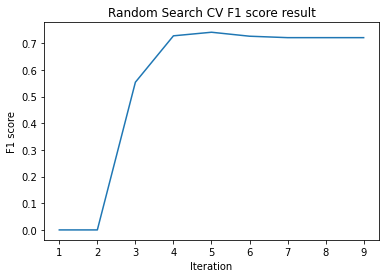

In [234]:
# plotting the various mean f1 scores

labels = grid_cfl.cv_results_['params']
x_axis = range(1,10)
y_axis = grid_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

print("BEST MODEL -- ", grid_cfl.best_estimator_)

In [235]:
x_cfl = LogisticRegression(C=0.1)
x_cfl.fit(df,y_d2.values.ravel())

LogisticRegression(C=0.1)

Test F1 score: 0.8724767991271745


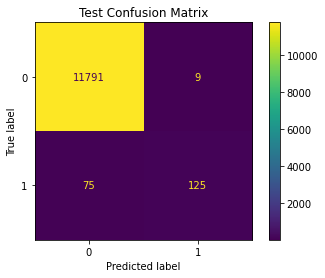

In [236]:
test_df = test_dataset(num_of_models, model_list, X_ensemble_test)
y_test_pred = x_cfl.predict(test_df)
print("Test F1 score:", f1_score(y_ensemble_test, y_test_pred, average='macro'))

plot1 = plot_confusion_matrix(x_cfl, test_df, y_ensemble_test) 
plot1.ax_.set_title('Test Confusion Matrix')

plt.show()

## Results

- 10 DT Model - 0.8706245599369046
- 20 DT Model - 0.8787366046249295
- 50 DT Model - 0.8817634631713474
- 75 DT Model - 0.8681111364375957

### Median Imputed Data

In [237]:
X_train, X_ensemble_test, y_train, y_ensemble_test = train_test_split(data_df, y_true, stratify=y_true, test_size=0.2)

dataset_d1, dataset_d2, y_d1, y_d2 = train_test_split(X_train, y_train, stratify=y_train, test_size=0.5)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

(24000, 149) (24000, 149) (12000, 149)


In [238]:
high_correlated_columns = ['sensor45_measure', 'sensor32_measure', 'sensor46_measure', 'sensor47_measure', 'sensor67_measure']
for column in high_correlated_columns:
    if column in X_train.columns:
        dataset_d1 = dataset_d1.drop([column],axis=1)
        dataset_d2 = dataset_d2.drop([column],axis=1)
        X_ensemble_test = X_ensemble_test.drop([column],axis=1)
       
dataset_d1 = dataset_d1.drop(['sensor64_histogram_bin5'],axis=1)
dataset_d2 = dataset_d2.drop(['sensor64_histogram_bin5'],axis=1)
X_ensemble_test = X_ensemble_test.drop(['sensor64_histogram_bin5'],axis=1)

In [239]:
median_values = dataset_d1.median()
columns = dataset_d1.columns
dataset_d1 = dataset_d1.fillna(median_values)
dataset_d2 = dataset_d2.fillna(median_values)
X_ensemble_test = X_ensemble_test.fillna(median_values)

print(dataset_d1.shape, dataset_d2.shape, X_ensemble_test.shape)

dataset_d1 = pd.DataFrame(dataset_d1)
dataset_d2 = pd.DataFrame(dataset_d2)
X_ensemble_test = pd.DataFrame(X_ensemble_test)

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

(24000, 143) (24000, 143) (12000, 143)


In [240]:
column_names = dict()

for column in dataset_d1.columns:
    value = column.split("_")
    if value[1] == 'histogram':
        if value[0] not in column_names:
            column_names[value[0]] = []
        column_names[value[0]].append(column)
        
print(column_names)

{'sensor7': ['sensor7_histogram_bin2', 'sensor7_histogram_bin3', 'sensor7_histogram_bin4', 'sensor7_histogram_bin5', 'sensor7_histogram_bin6', 'sensor7_histogram_bin7', 'sensor7_histogram_bin8', 'sensor7_histogram_bin9'], 'sensor24': ['sensor24_histogram_bin5', 'sensor24_histogram_bin6', 'sensor24_histogram_bin7', 'sensor24_histogram_bin8'], 'sensor25': ['sensor25_histogram_bin0', 'sensor25_histogram_bin1', 'sensor25_histogram_bin2', 'sensor25_histogram_bin3', 'sensor25_histogram_bin4', 'sensor25_histogram_bin5', 'sensor25_histogram_bin6', 'sensor25_histogram_bin7', 'sensor25_histogram_bin8'], 'sensor26': ['sensor26_histogram_bin0', 'sensor26_histogram_bin1', 'sensor26_histogram_bin2', 'sensor26_histogram_bin3', 'sensor26_histogram_bin4', 'sensor26_histogram_bin5', 'sensor26_histogram_bin6', 'sensor26_histogram_bin7', 'sensor26_histogram_bin8', 'sensor26_histogram_bin9'], 'sensor64': ['sensor64_histogram_bin1', 'sensor64_histogram_bin2', 'sensor64_histogram_bin3', 'sensor64_histogram_b

In [241]:
dataset_d1 = add_average_bin_feature(dataset_d1, column_names)
dataset_d2 = add_average_bin_feature(dataset_d2, column_names)
X_ensemble_test = add_average_bin_feature(X_ensemble_test, column_names)

In [242]:
mnmx_scaler = MinMaxScaler()
columns = dataset_d1.columns

dataset_d1 = pd.DataFrame(mnmx_scaler.fit_transform(dataset_d1))
dataset_d2 = pd.DataFrame(mnmx_scaler.transform(dataset_d2))
X_ensemble_test = pd.DataFrame(mnmx_scaler.transform(X_ensemble_test))

dataset_d1.columns = columns
dataset_d2.columns = columns
X_ensemble_test.columns = columns

In [243]:
# Number of models here is a hyper parameter and has been tried with mutiple values and the results are below
num_of_models = 75
model_list, df = ensemble_model_DT(num_of_models, dataset_d1, y_d1, dataset_d2, y_d2)

Generating Samples Done
Fitting Base Models Done
Predict on Dataset 2 Done
Formed Meta Dataset Done


In [244]:
# Logistic Regression as the meta classifier and it is hyper paramterized with the GridSearch CV

x_cfl = LogisticRegression()

params={
    'C':[10 ** x for x in range(-5, 4)]
}
grid_cfl=GridSearchCV(x_cfl, param_grid=params, n_jobs=-1, scoring='f1')
grid_cfl.fit(df, y_d2.values.ravel())

GridSearchCV(estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,
                               1000]},
             scoring='f1')

{'C': 1e-05} : 0.0
{'C': 0.0001} : 0.0
{'C': 0.001} : 0.5861508320055598
{'C': 0.01} : 0.7477981439852182
{'C': 0.1} : 0.7353985145289493
{'C': 1} : 0.7229873825307453
{'C': 10} : 0.7170001803471593
{'C': 100} : 0.7151886386994301
{'C': 1000} : 0.7151886386994301
BEST MODEL --  LogisticRegression(C=0.01)


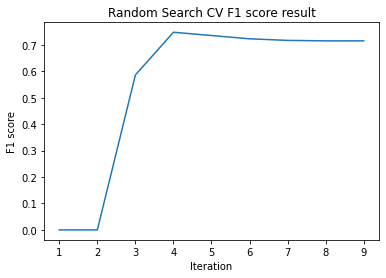

In [245]:
# plotting the various mean f1 scores

labels = grid_cfl.cv_results_['params']
x_axis = range(1,10)
y_axis = grid_cfl.cv_results_['mean_test_score']
for i, label in enumerate(labels):
    print(label, ":", y_axis[i])
    
plt.xlabel('Iteration')
plt.ylabel('F1 score')
plt.title('Random Search CV F1 score result')
plt.plot(x_axis, y_axis)

print("BEST MODEL -- ", grid_cfl.best_estimator_)

In [246]:
x_cfl = LogisticRegression(C=0.1)
x_cfl.fit(df,y_d2.values.ravel())

LogisticRegression(C=0.1)

Test F1 score: 0.848547508110244


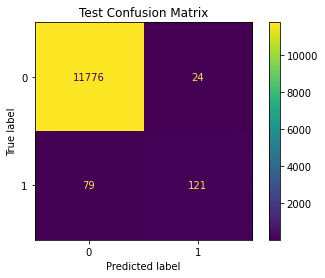

In [247]:
test_df = test_dataset(num_of_models, model_list, X_ensemble_test)
y_test_pred = x_cfl.predict(test_df)
print("Test F1 score:", f1_score(y_ensemble_test, y_test_pred, average='macro'))

plot1 = plot_confusion_matrix(x_cfl, test_df, y_ensemble_test) 
plot1.ax_.set_title('Test Confusion Matrix')

plt.show()

## Results

- 10 DT Models - 0.8431698281983553
- 20 DT Models - 0.877661205676942
- 50 DT Models - 0.8805020358973197
- 75 DT Models - 0.8726592622123398


The Ensemble Models with FE dataset along with Median/KNN based imputation provided good results close to the RF classifiers but did not reach the F1 score of the Voting Classifiers.

## Take aways from Modelling

1. With every model, we saw improvement in the F1 scores.
2. Few sensors like Sensor 85, 35, 82 ,9 and Bin 1 of Sensor 25 are the top features that added to classification.
3. Bin Average Feature which was added as Feature Engineering feature has good amount of importance with few of the features being in the top 25 features.
4. We observed that the Voting and Stacking Classifiers performed the best when used the best hyper parameters of the dataset based on the imputation.
5. Overall XGBoost with median imputation had the highest F1 score of ~0.90 over all other Models including Ensemble models. Other Models like Stacking and XG boost were not far with scores of ~0.89

In [248]:
from prettytable import PrettyTable

In [249]:
GREEN  = '\033[92m'
END = '\033[0m'
BOLD = '\033[1m'

print(BOLD+"The Highlighted Rows are the ones with higher F1 score."+END)

table = PrettyTable()
table.field_names = ["Model", "Parameter", "Imputation" ,"Train F1 Score", "CV F1 score", "Test F1 Score"]
table.add_row(["KNN","manhattan, n=3, distance","Median", 1.0, 0.8337, 0.8484])
table.add_row(["KNN","manhattan, n=4, distance","KNN imputer", 1.0, 0.8437, 0.8550])
table.add_row(["","","","","",""])
table.add_row([BOLD+"Random Forest"+END,"d=100, n=1500","Median", 1.0, 0.8778, BOLD+GREEN+"0.8921"+END])
table.add_row(["Random Forest","d=100, n=1000","KNN imputer", 1.0, 0.8728, "0.8776"])
table.add_row(["","","","","",""])
table.add_row([BOLD+"XG Boost"+END,"ss=1, d=5, n=2000, lr=0.05, colsam_tree=0.5","Median", 1.0, 0.9039, BOLD+GREEN+"0.8988"+END])
table.add_row(["XG Boost","ss=0.5, d=10, n=2000, lr=0.2, colsam_tree=0.3","KNN imputer", 1.0, 0.8950, 0.8957])
table.add_row(["","","","","",""])
table.add_row([BOLD+"Stacking Classifier"+END,"RF, XBG, KNN, meta=KNN","Median", 1.0, 0.8872, BOLD+GREEN+"0.8932"+END])
table.add_row(["Stacking Classifier","RF, XBG, KNN, meta=KNN","KNN imputer", 1.0, 0.8760, 0.8879])
table.add_row(["","","","","",""])
table.add_row([BOLD+"Voting Classifier"+END,"RF, XBG, KNN","Median", 1.0, 0.911, BOLD+GREEN+"0.888"+END])
table.add_row(["Voting Classifier","RF, XBG, KNN","KNN imputer", 1.0, 0.909, 0.886])
table.add_row(["","","","","",""])
table.add_row(["Ensemble Models without FE","75 DT + Logistic Regression","Median", "0.74", "-", 0.889])
table.add_row(["","","","","",""])
table.add_row(["Ensemble Models without FE","75 DT + Logistic Regression","KNN imputer", "0.75", "-", 0.881])
table.add_row(["","","","","",""])
table.add_row(["Ensemble Models with FE","75 DT + Logistic Regression","Median", "0.73", "-", 0.868])
table.add_row(["","","","","",""])
table.add_row(["Ensemble Models with FE","75 DT + Logistic Regression","KNN imputer", "0.77", "-", 0.872])

table._max_width = {"Model":30, "Parameter":30, "Imputation":30 ,"Train F1 Score":5, "CV F1 score":5, "Test F1 Score":5}
print(table)

The Highlighted Rows are the ones with higher F1 score.
+----------------------------+--------------------------------+-------------+----------------+-------------+---------------+
|           Model            |           Parameter            |  Imputation | Train F1 Score | CV F1 score | Test F1 Score |
+----------------------------+--------------------------------+-------------+----------------+-------------+---------------+
|            KNN             |    manhattan, n=3, distance    |    Median   |      1.0       |    0.8337   |     0.8484    |
|            KNN             |    manhattan, n=4, distance    | KNN imputer |      1.0       |    0.8437   |     0.855     |
|                            |                                |             |                |             |               |
|       Random Forest        |         d=100, n=1500          |    Median   |      1.0       |    0.8778   |     0.8921    |
|       Random Forest        |         d=100, n=1000          | KNN i